# Modeling & Training - Treating Labels as Independent - 10 folds

## Author: Ian Scarff (iscarff123)

In [4]:
import pandas as pd
import numpy as np
import json
import os
import imageio
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn.preprocessing import MultiLabelBinarizer
import time
import datetime

import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torchvision
from torchvision import transforms
from torchvision import models
from torch.utils.data import DataLoader, SubsetRandomSampler
from sklearn.model_selection import KFold
import skimage

from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score

import warnings
warnings.filterwarnings('ignore')

## Data Preprocessing

### Load in reference data.

In [2]:
### Load in reference data

with open('training_data_task3.txt') as f: ### Training data
    training = json.load(f)
    
with open('testing_data_task3.txt') as f: ### Testing data
    testing = json.load(f)
    
classes = ['Smears', 'Loaded Language', 'Name calling/Labeling', 'Glittering generalities (Virtue)',
               'Appeal to (Strong) Emotions', 'Appeal to fear/prejudice', 'Transfer', 'Doubt',
               'Exaggeration/Minimisation', 'Whataboutism', 'Slogans', 'Flag-waving',
               "Misrepresentation of Someone's Position (Straw Man)", 'Causal Oversimplification',
               'Thought-terminating cliché', 'Black-and-white Fallacy/Dictatorship', 'Appeal to authority',
               'Reductio ad hitlerum', 'Repetition', 'Obfuscation, Intentional vagueness, Confusion',
               'Presenting Irrelevant Data (Red Herring)', 'Bandwagon']

### Create Class Binarizer
one_hot = MultiLabelBinarizer()
one_hot.fit([classes])

MultiLabelBinarizer()

In [3]:
one_hot.classes_

array(['Appeal to (Strong) Emotions', 'Appeal to authority',
       'Appeal to fear/prejudice', 'Bandwagon',
       'Black-and-white Fallacy/Dictatorship',
       'Causal Oversimplification', 'Doubt', 'Exaggeration/Minimisation',
       'Flag-waving', 'Glittering generalities (Virtue)',
       'Loaded Language',
       "Misrepresentation of Someone's Position (Straw Man)",
       'Name calling/Labeling',
       'Obfuscation, Intentional vagueness, Confusion',
       'Presenting Irrelevant Data (Red Herring)', 'Reductio ad hitlerum',
       'Repetition', 'Slogans', 'Smears', 'Thought-terminating cliché',
       'Transfer', 'Whataboutism'], dtype=object)

In [4]:
training[0:3]

[{'id': '182',
  'labels': ['Exaggeration/Minimisation',
   'Name calling/Labeling',
   'Smears',
   'Transfer'],
  'text': 'The most costly errors in all of history\n\nWorld Health Organization (WHO)\nPreliminary investigations conducted by the Chinese authorities have found no clear evidence of human-to-human transmission of the novel #coronavirus (2019-nCoV) identified in #Wuhan, #China\n14 Jan 2020\n\nWORLD NEWS FEBRUARY 3, 2020 / 10:33 PM / 2 MONTHS AGO\nWHO chief says widespread travel bans not needed to beat China virus\n',
  'image': '182_image.png'},
 {'id': '366_batch_2',
  'labels': ['Causal Oversimplification',
   'Loaded Language',
   'Name calling/Labeling'],
  'text': 'MY PARENTS WERE KILLED AS A RESULT OF A GUN FREE ZONE.\n\nI CARRIED A GUN AT ALL TIMES TILL IT WAS MADE A FELONY TO CARRY IN CERTAIN AREAS. \nA MAN WITH A GUN STARTED SHOOTING PEOPLE...\nI HAD THE PERFECT SHOT BUT WAS DISARMED BY LAWS.\n\n',
  'image': '366_image_batch_2.png'},
 {'id': '148',
  'labels': [

In [5]:
len(training)

727

In [6]:
testing[0:3]

[{'id': '566_batch_2',
  'labels': ['Appeal to (Strong) Emotions', 'Smears'],
  'text': "A FRIENDLY REMINDER...\n\nFERGUSON\n\nBALTIMORE\n\nMILWAUKEE\n\nCHARLOTTE\n\nIN CASE Y'ALL FORGOT !\n",
  'image': '566_image_batch_2.png'},
 {'id': '738_batch_2',
  'labels': ['Black-and-white Fallacy/Dictatorship',
   'Flag-waving',
   'Loaded Language',
   'Name calling/Labeling'],
  'text': "We're fed up.\nWe're not asking for our country back.\nWe're TAKING IT BACK\nWE THE PEOPLE ARE COMING\nAmerica was founded by pissed off people.\nAnd they're pissed again!",
  'image': '738_image_batch_2.png'},
 {'id': '885_batch_2',
  'labels': ['Smears'],
  'text': "PRESIDENTS' DAY SALE\n\nEVERYONE MUST GO",
  'image': '885_image_batch_2.png'}]

In [7]:
len(testing)

187

In [8]:
len(training) + len(testing)

914

### Extract Image Names & Labels

#### Training data

In [9]:
image_name = []
one_hot_labels = [] ### List to hold one hot labels

for obsv in training: ### Go through the training data

    ### Images ###
    image_name.append(obsv['image'])
    
    ### Labels
    one_hot_labels.append(one_hot.transform([obsv['labels']])[0])


#### Testing data

In [10]:
image_name2 = []
one_hot_labels2 = [] ### List to hold one hot labels

for obsv in testing: ### Go through the training data

    ### Images ###
    image_name2.append(obsv['image'])
    
    ### Labels
    one_hot_labels2.append(one_hot.transform([obsv['labels']])[0])

### Convert to json

#### Training

In [11]:
training_df = pd.DataFrame({
    'images' : image_name,
    'labels' : one_hot_labels
})

#### Testing

In [12]:
testing_df = pd.DataFrame({
    'images' : image_name2,
    'labels' : one_hot_labels2
})

In [13]:
training_df

,images,labels
0,182_image.png,"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, ..."
1,366_image_batch_2.png,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, ..."
2,148_image.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, ..."
3,58_image_batch_2.png,"[0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
4,816_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
...,...,...
722,687_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
723,516_image_batch_2.png,"[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
724,45_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
725,86_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, ..."


In [14]:
testing_df

,images,labels
0,566_image_batch_2.png,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,738_image_batch_2.png,"[0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, ..."
2,885_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,41_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, ..."
4,169_image.png,"[0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...
182,867_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, ..."
183,901_image_batch_2.png,"[0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
184,932_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, ..."
185,967_image_batch_2.png,"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, ..."


In [15]:
### Save to csv
training_df.to_json('training_data.json')
testing_df.to_json('testing_data.json')
### Saving as json retains list type in dataframe

# 
# 
# 

## Load Data with DataLoader

In [16]:
from CustomLoader import ImageLoader

In [17]:
training_data = ImageLoader(json_file = 'training_data.json', root_dir = 'Images',
                           transform = transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Resize(size = (224,224)),
                               transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)) ### Pixel range [-1,1]
                           ]))

testing_data = ImageLoader(json_file = 'testing_data.json', root_dir = 'Images',
                           transform = transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Resize(size = (224,224)),
                               transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)) ### Pixel range [-1,1]
                           ]))

In [18]:
train_loader = DataLoader(dataset = training_data, batch_size = 25, shuffle = True)
test_loader = DataLoader(dataset = testing_data, batch_size = 25, shuffle = True)

### Visualize Images

In [19]:
def imshow(img):
    img = img / 2 + 0.5
    plt.imshow(np.transpose(img, (1, 2, 0)))

#### Training Images

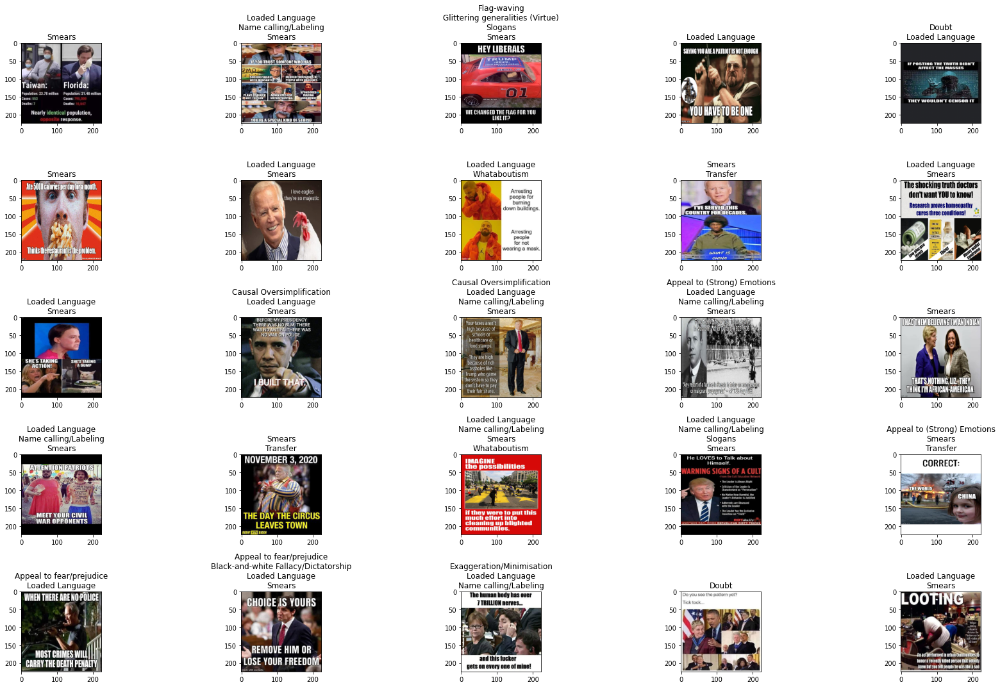

In [20]:
first_batch = iter(train_loader)
images_batch, labels_batch = first_batch.next()
images_batch = images_batch.numpy()
labels_batch = labels_batch.numpy()

fig = plt.figure(figsize = (25, 15))

for idx in np.arange(25):
    ax = fig.add_subplot(5, 5, idx + 1)
    imshow(images_batch[idx])
    
    title = ""
    k = 1
    for i in np.where(labels_batch[idx] == 1)[0]:
        if k == 1:
            title = title + one_hot.classes_[i]
            k+=1
        else:
            title = title + '\n' + one_hot.classes_[i]
            
    ax.set_title(title)
        
fig.tight_layout()

#### Testing Images

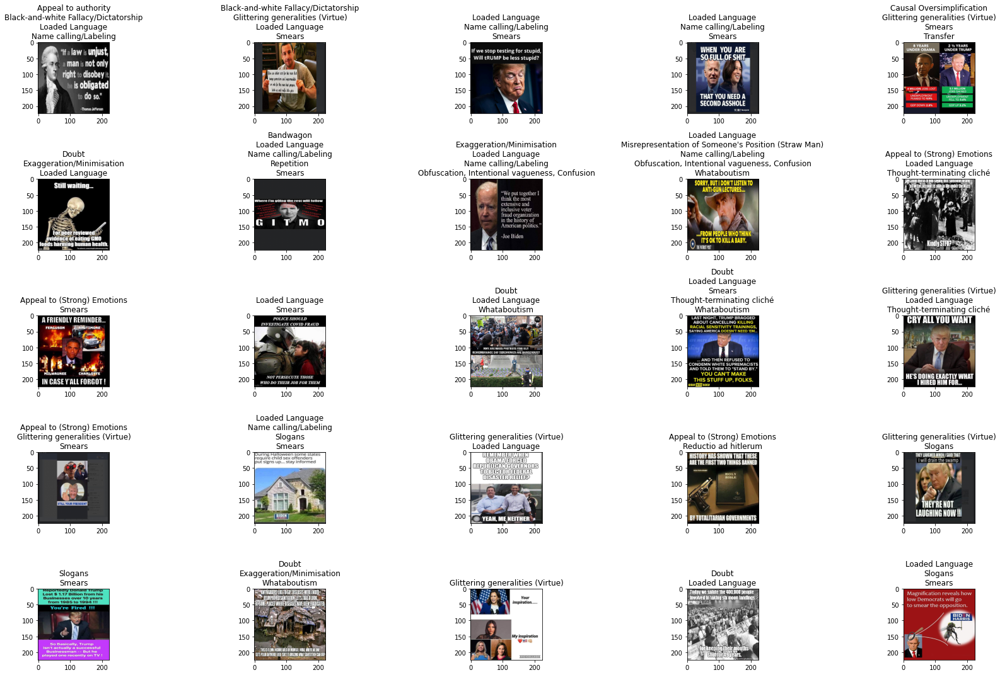

In [21]:
first_batch = iter(test_loader)
images_batch, labels_batch = first_batch.next()
images_batch = images_batch.numpy()
labels_batch = labels_batch.numpy()

fig = plt.figure(figsize = (25, 15))

for idx in np.arange(25):
    ax = fig.add_subplot(5, 5, idx + 1)
    imshow(images_batch[idx])
    
    title = ""
    k = 1
    for i in np.where(labels_batch[idx] == 1)[0]:
        if k == 1:
            title = title + one_hot.classes_[i]
            k+=1
        else:
            title = title + '\n' + one_hot.classes_[i]
            
    ax.set_title(title)
        
fig.tight_layout()

# 
# 
# 

## Define Training Methodology

In [22]:
def get_lr(optim):
    for param_group in optim.param_groups:
        return param_group['lr']

In [23]:
### This function is used to train a cnn model
def Kfold_train_CNN(model = None, training_data = None, learning_rate = None, k_folds = None, n_epochs = None, model_name = None):
    
    ### Check that all entries are valid
    if ((model == None) or (training_data == None) or (model_name == None) or 
        (learning_rate == None) or (k_folds == None) or (n_epochs == None)):
        print ('Enter all info.')
        
        
        
    ### Run K-Fold CV
    else:
        
        device = 'cpu'

        ### Set Loss Function and Optimizer
        criterion = nn.BCELoss()
        
        
        #### Define the K-fold Cross Validator
        kfold = KFold(n_splits=k_folds, shuffle=True)
        
        
        
        ### Create values to hold the best model metrics across folds
        val_f1_mic_max = 0 ### This determines best model
        
        best_train_loss = 0
        best_train_acc = 0
        best_train_f1_mic = 0
        best_train_f1_mac = 0
        best_train_prec_mic = 0
        best_train_prec_mac = 0
        best_train_rec_mic = 0
        best_train_rec_mac = 0

        best_val_acc = 0
        best_val_loss = 0
#         best_val_f1_mic = 0
        best_val_f1_mac = 0
        best_val_prec_mic = 0
        best_val_prec_mac = 0
        best_val_rec_mic = 0
        best_val_rec_mac = 0
        
        best_fold = 0
        best_epoch = 0
        

        
        ### Start print

        start = time.time()
        
        ### K-fold Cross Validation model evaluation
        for fold, (train_ids, val_ids) in enumerate(kfold.split(training_data)):
            
            print('-------------------------------------------')
            print('FOLD {}'.format(fold))
            print('-------------------------------------------')
            
            ### Sample elements randomly from a given list of ids, no replacement
            train_subsampler = SubsetRandomSampler(train_ids)
            val_subsampler = SubsetRandomSampler(val_ids)
            
            ### Define data loaders for training and validation in current fold
            train_loader = DataLoader(dataset = training_data, batch_size = 25, sampler = train_subsampler)
            val_loader = DataLoader(dataset = training_data, batch_size = 25, sampler = val_subsampler)
            
            ### Initialize network
            network = model
            if torch.cuda.is_available():
                network.cuda()
                network = nn.DataParallel(network, list(range(2)))
                device = 'cuda'
            
            ### Initialize optimizer
            optimizer = optim.Adam(model.parameters(), lr=learning_rate)
            scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode = 'min', factor = 0.1, patience = 5)
            
            
            ### Create lists of values at the end of each epoch for each fold
            train_loss = []
            train_acc = []
            train_f1_mic = []
            train_f1_mac = []
            train_prec_mic = []
            train_prec_mac = []
            train_rec_mic = []
            train_rec_mac = []
            
            val_loss = []
            val_acc = []
            val_f1_mic = []
            val_f1_mac = []
            val_prec_mic = []
            val_prec_mac = []
            val_rec_mic = []
            val_rec_mac = []
            
            
            ### Train network
            for epoch in range(n_epochs):
                
                ### Hold training predictions and targets
                train_output = np.empty((0,22), int)
                train_all_targets = np.empty((0,22), int)
                
                val_output = np.empty((0,22), int)
                val_all_targets = np.empty((0,22), int)
                
                
                ### Train ###
                network.train()
                
                train_running_loss = 0.0
                
                batch_number = 0
                for i, data in enumerate(train_loader):
                    
                    images, targets = data[0].to(device), data[1].float().to(device)
                    optimizer.zero_grad()
                    
                    output = network(images)
                    
                    loss = criterion(output, targets) 
                    train_running_loss += loss.item()
                                        
                    ### Append output
                    train_output = np.vstack((train_output, ((output > 0.5).cpu().numpy().astype('int'))))
                    train_all_targets = np.vstack((train_all_targets, targets.cpu().numpy().astype('int')))

                    loss.backward()
                    optimizer.step()
                                        
                    
                ### Calculate metrics and append
                train_loss.append(train_running_loss/len(train_loader.dataset))
                train_acc.append(accuracy_score(train_all_targets, train_output))
                train_f1_mic.append(f1_score(train_all_targets, train_output, average = 'micro'))
                train_f1_mac.append(f1_score(train_all_targets, train_output, average = 'macro'))
                train_prec_mic.append(precision_score(train_all_targets, train_output, average = 'micro'))
                train_prec_mac.append(precision_score(train_all_targets, train_output, average = 'macro'))
                train_rec_mic.append(recall_score(train_all_targets, train_output, average = 'micro'))
                train_rec_mac.append(recall_score(train_all_targets, train_output, average = 'macro'))
                
                
                ### Validate###
                network.eval()
                val_running_loss = 0.0

                                
                for i, data in enumerate(val_loader):
                    images, targets = data[0].to(device), data[1].float().to(device)
                    output = network(images)
                    loss = criterion(output, targets)
                    val_running_loss += loss.item()
                    
                    ### Append output
                    val_output = np.vstack((val_output, ((output > 0.5).cpu().numpy().astype('int'))))
                    val_all_targets = np.vstack((val_all_targets, targets.cpu().numpy().astype('int')))

                
                ### Calculate metrics and append
                val_loss.append(val_running_loss/len(val_loader.dataset))
                val_acc.append(accuracy_score(val_all_targets, val_output))
                val_f1_mic.append(f1_score(val_all_targets, val_output, average = 'micro'))
                val_f1_mac.append(f1_score(val_all_targets, val_output, average = 'macro'))
                val_prec_mic.append(precision_score(val_all_targets, val_output, average = 'micro'))
                val_prec_mac.append(precision_score(val_all_targets, val_output, average = 'macro'))
                val_rec_mic.append(recall_score(val_all_targets, val_output, average = 'micro'))
                val_rec_mac.append(recall_score(val_all_targets, val_output, average = 'macro'))
                
                
                ### Save model with the lowest validation loss
                if val_f1_mic[epoch] >= val_f1_mic_max:
                    print('Validation F1 Micro Score Increased ({:.6f} --> {:.6f}).  Saving model ...\n'.format(
                    val_f1_mic_max,
                    val_f1_mic[epoch]))
                    torch.save(network.state_dict(), 'BestCnnModels_Ind_Labels_10folds/' + model_name +'.pt')
                    val_f1_mic_max = val_f1_mic[epoch]
                    
                    ### Set current best metrics
                    best_train_loss = train_loss[epoch]
                    best_train_acc = train_acc[epoch]
                    best_train_f1_mic = train_f1_mic[epoch]
                    best_train_f1_mac = train_f1_mac[epoch]
                    best_train_prec_mic = train_prec_mic[epoch]
                    best_train_prec_mac = train_prec_mac[epoch]
                    best_train_rec_mic = train_rec_mic[epoch]
                    best_train_rec_mac = train_rec_mac[epoch]

                    best_val_acc = val_acc[epoch]
                    best_val_loss = val_loss[epoch]
#                     best_val_f1_mic = val_f1_mic[epoch]
                    best_val_f1_mac = val_f1_mac[epoch]
                    best_val_prec_mic = val_prec_mic[epoch]
                    best_val_prec_mac = val_prec_mac[epoch]
                    best_val_rec_mic = val_rec_mic[epoch]
                    best_val_rec_mac = val_rec_mac[epoch]

                    best_fold = fold
                    best_epoch = epoch + 1
                    
                    
                    
                ### Display summary for epoch
                print('Epoch {} \tLearning Rate: {} \tTime (min): {}'.format(epoch+1, get_lr(optimizer), round((time.time()-start)/60, 2)))
                print('Train Loss: {} \tValidation Loss: {}'. format(round(train_loss[epoch], 4),
                                                                     round(val_loss[epoch], 4)))
                print('Train Accuracy: {} \tValidation Accuracy: {}'.format(round(train_acc[epoch], 4),
                                                                            round(val_acc[epoch], 4)))
                print('Train F1 Mirco: {} \tValidation F1 Micro: {}'.format(round(train_f1_mic[epoch], 4),
                                                                            round(val_f1_mic[epoch], 4)))
                print('Train F1 Marco: {} \tValidation F1 Macro: {}'.format(round(train_f1_mac[epoch], 4),
                                                                            round(val_f1_mac[epoch], 4)))
                print('Train Precision Mirco: {} \tValidation Precision Micro: {}'.format(round(train_prec_mic[epoch], 4),
                                                                                          round(val_prec_mic[epoch], 4)))
                print('Train Precision Marco: {} \tValidation Precision Macro: {}'.format(round(train_prec_mac[epoch], 4),
                                                                                          round(val_prec_mac[epoch], 4)))
                print('Train Recall Mirco: {} \tValidation Recall Micro: {}'.format(round(train_rec_mic[epoch], 4),
                                                                                    round(val_rec_mic[epoch], 4)))
                print('Train Recall Marco: {} \tValidation Recall Macro: {}\n'.format(round(train_rec_mac[epoch], 4),
                                                                                    round(val_rec_mac[epoch], 4)))
                
                
                ### Update learning rate if needed
                scheduler.step(val_loss[epoch])
                
                
                
            ### Display summary graph of fold
            fig, (ax1, ax3) = plt.subplots(1,2, figsize = (20,6))
            ax1.set_xlabel('Epoch')
            ax1.set_ylabel('Loss')
            ln1 = ax1.plot(np.arange(start = 1, stop = n_epochs + 1), train_loss, label = 'Train Loss')
            ln2 = ax1.plot(np.arange(start = 1, stop = n_epochs + 1), val_loss, label = 'Val Loss')
            
            ax2 = ax1.twinx()
            ax2.set_ylabel('Accuracy')
            ln3 = ax2.plot(np.arange(start = 1, stop = n_epochs + 1), train_acc, marker = 'o', label = 'Train Acc')
            ln4 = ax2.plot(np.arange(start = 1, stop = n_epochs + 1), val_acc, marker = 'o', label = 'Val Acc')
            
            lns1 = ln1 + ln2 + ln3 + ln4
            labs1 = [l.get_label() for l in lns1]
            
            ax3.set_xlabel('Epoch')
            ax3.set_ylabel('Score')
            ln5 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_f1_mic, marker = 'v', label = 'Train F1 Micro')
            ln6 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_f1_mic, marker = 'v', label = 'Val F1 Micro')
            ln7 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_f1_mac, marker = '^', label = 'Train F1 Macro')
            ln8 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_f1_mac, marker = '^', label = 'Val F1 Micro')
            ln9 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_prec_mic, marker = 'd', label = 'Train Prec. Micro')
            ln10 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_prec_mic, marker = 'd', label = 'Val Prec. Micro')
            ln11 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_prec_mac, marker = 'X', label = 'Train Prec. Macro')
            ln12 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_prec_mac, marker = 'X', label = 'Val Prec. Macro')
            ln13 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_rec_mic, marker = 'P', label = 'Train Rec. Micro')
            ln14 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_rec_mic, marker = 'P', label = 'Val Rec. Micro')
            ln15 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), train_rec_mac, marker = 's', label = 'Train Rec. Macro')
            ln16 = ax3.plot(np.arange(start = 1, stop = n_epochs + 1), val_rec_mac, marker = 's', label = 'Val Rec. Macro')
            
            lns2 = ln5 + ln6 + ln7 + ln8 +  ln9 + ln10 + ln11 + ln12 + ln13 + ln14 + ln15 + ln16
            labs2 = [l.get_label() for l in lns2]
            
            
            ax1.legend(lns1, labs1, loc = 'upper left', bbox_to_anchor = (1.1,1))
            ax3.legend(lns2, labs2, loc = 'upper left', bbox_to_anchor = (1.05,1))
            fig.tight_layout()
            
            plt.show()
        
        
        
        ### Display metrics of the best model
                
        print('------------------------------------------------------------')
        print('------------------------------------------------------------')
        
        print('\nMetrics of Best Model:')
        print('Fold: {} \tEpoch: {}'.format(best_fold, best_epoch))
        print('Train Loss: {} \tValidation Loss: {}'. format(round(best_train_loss, 4),
                                                             round(best_val_loss, 4)))
        print('Train Accuracy: {} \tValidation Accuracy: {}'.format(round(best_train_acc, 4),
                                                                    round(best_val_acc, 4)))
        print('Train F1 Mirco: {} \tValidation F1 Micro: {}'.format(round(best_train_f1_mic, 4),
                                                                    round(val_f1_mic_max, 4)))
        print('Train F1 Marco: {} \tValidation F1 Macro: {}'.format(round(best_train_f1_mac, 4),
                                                                    round(best_val_f1_mac, 4)))
        print('Train Precision Mirco: {} \tValidation Precision Micro: {}'.format(round(best_train_prec_mic, 4),
                                                                                  round(best_val_prec_mic, 4)))
        print('Train Precision Marco: {} \tValidation Precision Macro: {}'.format(round(best_train_prec_mac, 4),
                                                                                  round(best_val_prec_mac, 4)))
        print('Train Recall Mirco: {} \tValidation Recall Micro: {}'.format(round(best_train_rec_mic, 4),
                                                                            round(best_val_rec_mic, 4)))
        print('Train Recall Marco: {} \tValidation Recall Macro: {}'.format(round(best_train_rec_mac, 4),
                                                                            round(best_val_rec_mac, 4)))
  

# 
# 

## Define Models

### ResNet-18

In [24]:
### Import model
resnet18 = models.resnet18(pretrained = True)

In [25]:
print(resnet18)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [26]:
### Freeze parameters
for param in resnet18.parameters():
    param.requires_grad = False

In [27]:
### Change last layer to match output
resnet18.fc = nn.Sequential(
    nn.Linear(512, 22),
    nn.Sigmoid()
)

In [28]:
print(resnet18)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

### ResNet-50

In [29]:
### Import model
resnet50 = models.resnet50(pretrained = True)

In [30]:
print(resnet50)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [31]:
### Freeze parameters
for param in resnet50.parameters():
    param.requires_grad = False

In [32]:
### Change last layer to match output
resnet50.fc = nn.Sequential(
    nn.Linear(2048, 22),
    nn.Sigmoid()
)

In [33]:
print(resnet50)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### ResNet-101

In [34]:
### Import model
resnet101 = models.resnet101(pretrained = True)

In [35]:
print(resnet101)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [36]:
### Freeze parameters
for param in resnet101.parameters():
    param.requires_grad = False

In [37]:
### Change last layer to match output
resnet101.fc = nn.Sequential(
    nn.Linear(2048, 22),
    nn.Sigmoid()
)

In [38]:
print(resnet101)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### DenseNet-121

In [39]:
### Import model
densenet121 = models.densenet121(pretrained = True)

In [40]:
print(densenet121)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [41]:
### Freeze parameters
for param in densenet121.parameters():
    param.requires_grad = False

In [42]:
### Change last layer to match output
densenet121.classifier = nn.Sequential(
    nn.Linear(1024, 22),
    nn.Sigmoid()
)

In [43]:
print(densenet121)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

### DenseNet-169

In [44]:
### Import model
densenet169 = models.densenet169(pretrained = True)

In [45]:
print(densenet169)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [46]:
### Freeze parameters
for param in densenet169.parameters():
    param.requires_grad = False

In [47]:
### Change last layer to match output
densenet169.classifier = nn.Sequential(
    nn.Linear(1664, 22),
    nn.Sigmoid()
)

In [48]:
print(densenet169)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

### DenseNet-201

In [49]:
### Import model
densenet201 = models.densenet201(pretrained = True)

In [50]:
print(densenet201)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [51]:
### Freeze parameters
for param in densenet201.parameters():
    param.requires_grad = False

In [52]:
### Change last layer to match output
densenet201.classifier = nn.Sequential(
    nn.Linear(1920, 22),
    nn.Sigmoid()
)

In [53]:
print(densenet201)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

### VGG11_BN

In [54]:
### Import model
vgg11bn = models.vgg11_bn(pretrained = True)

In [55]:
print(vgg11bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): ReLU(inplace=True)
    (14): MaxPool2d(ke

In [56]:
### Freeze parameters
for param in vgg11bn.parameters():
    param.requires_grad = False

In [57]:
### Change last layer to match output
vgg11bn.classifier[6] = nn.Sequential(
    nn.Linear(4096, 22),
    nn.Sigmoid()
)

In [58]:
print(vgg11bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): ReLU(inplace=True)
    (14): MaxPool2d(ke

### VGG16_BN

In [59]:
### Import model
vgg16bn = models.vgg16_bn(pretrained = True)

In [60]:
print(vgg16bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

In [61]:
### Freeze parameters
for param in vgg16bn.parameters():
    param.requires_grad = False

In [62]:
### Change last layer to match output
vgg16bn.classifier[6] = nn.Sequential(
    nn.Linear(4096, 22),
    nn.Sigmoid()
)

In [63]:
print(vgg16bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

### VGG19_BN

In [64]:
### Import model
vgg19bn = models.vgg19_bn(pretrained = True)

In [65]:
print(vgg19bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

In [66]:
### Freeze parameters
for param in vgg19bn.parameters():
    param.requires_grad = False

In [67]:
### Change last layer to match output
vgg19bn.classifier[6] = nn.Sequential(
    nn.Linear(4096, 22),
    nn.Sigmoid()
)

In [68]:
print(vgg19bn)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

# 
# 
# 

## Train Models

In [69]:
START = time.time()

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.318182).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.17
Train Loss: 0.0163 	Validation Loss: 0.0015
Train Accuracy: 0.052 	Validation Accuracy: 0.0411
Train F1 Mirco: 0.4118 	Validation F1 Micro: 0.3182
Train F1 Marco: 0.0967 	Validation F1 Macro: 0.0791
Train Precision Mirco: 0.464 	Validation Precision Micro: 0.5526
Train Precision Marco: 0.1117 	Validation Precision Macro: 0.0967
Train Recall Mirco: 0.3701 	Validation Recall Micro: 0.2234
Train Recall Marco: 0.0932 	Validation Recall Macro: 0.0809

Validation F1 Micro Score Increased (0.318182 --> 0.446602).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.29
Train Loss: 0.0103 	Validation Loss: 0.0014
Train Accuracy: 0.0612 	Validation Accuracy: 0.0548
Train F1 Mirco: 0.479 	Validation F1 Micro: 0.4466
Train F1 Marco: 0.1111 	Validation F1 Macro: 0.0677
T

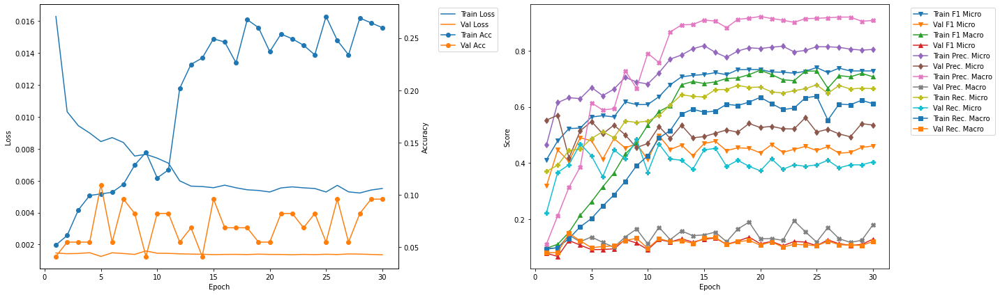

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.497175 --> 0.688525).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 3.88
Train Loss: 0.0088 	Validation Loss: 0.0008
Train Accuracy: 0.1086 	Validation Accuracy: 0.137
Train F1 Mirco: 0.5846 	Validation F1 Micro: 0.6885
Train F1 Marco: 0.4136 	Validation F1 Macro: 0.4312
Train Precision Mirco: 0.6584 	Validation Precision Micro: 0.5951
Train Precision Marco: 0.5589 	Validation Precision Macro: 0.4841
Train Recall Mirco: 0.5257 	Validation Recall Micro: 0.8167
Train Recall Marco: 0.34 	Validation Recall Macro: 0.5037

Epoch 2 	Learning Rate: 0.01 	Time (min): 4.01
Train Loss: 0.0078 	Validation Loss: 0.001
Train Accuracy: 0.1361 	Validation Accuracy: 0.0274
Train F1 Mirco: 0.6149 	Validation F1 Micro: 0.5028
Train F1 Marco: 0.5179 	Validation F1 Macro: 0.2467
Train Precision Mirco: 0.6787 	Validation Precision Micro: 0.5056
Train Precision 

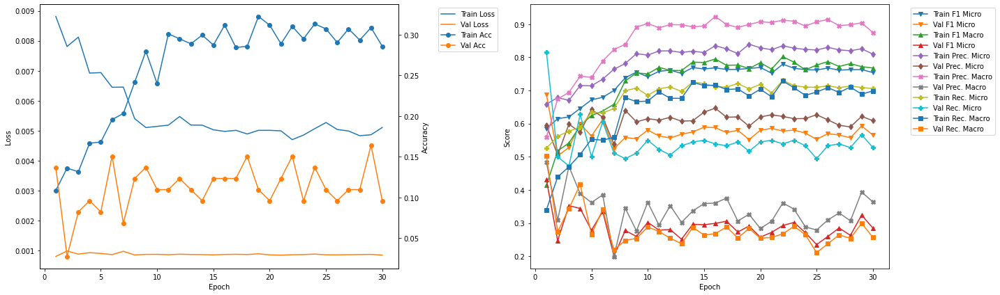

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.688525 --> 0.763092).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 7.58
Train Loss: 0.0095 	Validation Loss: 0.0007
Train Accuracy: 0.104 	Validation Accuracy: 0.2877
Train F1 Mirco: 0.5874 	Validation F1 Micro: 0.7631
Train F1 Marco: 0.4737 	Validation F1 Macro: 0.5221
Train Precision Mirco: 0.628 	Validation Precision Micro: 0.8361
Train Precision Marco: 0.6119 	Validation Precision Macro: 0.7149
Train Recall Mirco: 0.5518 	Validation Recall Micro: 0.7018
Train Recall Marco: 0.4075 	Validation Recall Macro: 0.4926

Epoch 2 	Learning Rate: 0.01 	Time (min): 7.7
Train Loss: 0.0066 	Validation Loss: 0.0007
Train Accuracy: 0.1743 	Validation Accuracy: 0.0959
Train F1 Mirco: 0.673 	Validation F1 Micro: 0.6562
Train F1 Marco: 0.5625 	Validation F1 Macro: 0.5014
Train Precision Mirco: 0.7128 	Validation Precision Micro: 0.7669
Train Precision 

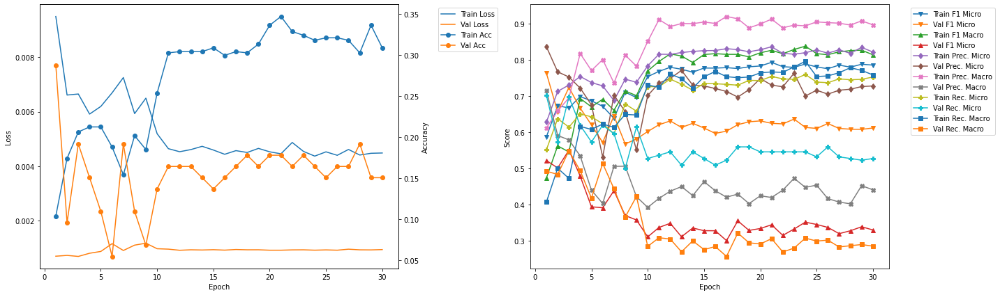

-------------------------------------------
FOLD 3
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 11.27
Train Loss: 0.0079 	Validation Loss: 0.0007
Train Accuracy: 0.1407 	Validation Accuracy: 0.1781
Train F1 Mirco: 0.6378 	Validation F1 Micro: 0.7064
Train F1 Marco: 0.5741 	Validation F1 Macro: 0.5837
Train Precision Mirco: 0.678 	Validation Precision Micro: 0.6697
Train Precision Marco: 0.6745 	Validation Precision Macro: 0.6453
Train Recall Mirco: 0.6021 	Validation Recall Micro: 0.7475
Train Recall Marco: 0.5055 	Validation Recall Macro: 0.6257

Epoch 2 	Learning Rate: 0.01 	Time (min): 11.39
Train Loss: 0.007 	Validation Loss: 0.0006
Train Accuracy: 0.1774 	Validation Accuracy: 0.2466
Train F1 Mirco: 0.6801 	Validation F1 Micro: 0.7126
Train F1 Marco: 0.6965 	Validation F1 Macro: 0.599
Train Precision Mirco: 0.7157 	Validation Precision Micro: 0.8267
Train Precision Marco: 0.7634 	Validation Precision Macro: 0.6971
Train Recall Mirco: 0.6478 

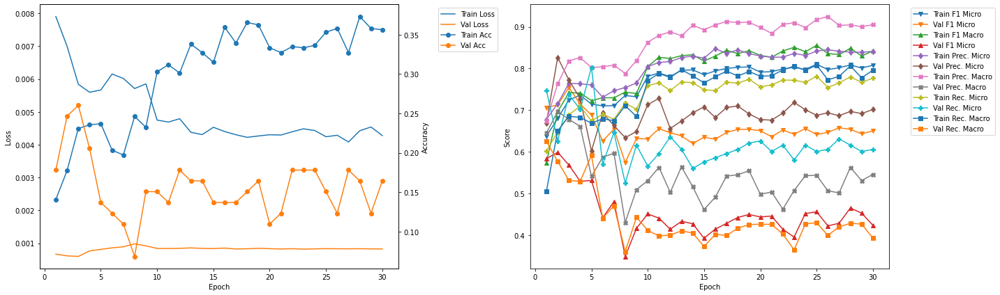

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 14.97
Train Loss: 0.0077 	Validation Loss: 0.0006
Train Accuracy: 0.1804 	Validation Accuracy: 0.274
Train F1 Mirco: 0.6663 	Validation F1 Micro: 0.735
Train F1 Marco: 0.6157 	Validation F1 Macro: 0.7745
Train Precision Mirco: 0.701 	Validation Precision Micro: 0.735
Train Precision Marco: 0.7411 	Validation Precision Macro: 0.8259
Train Recall Mirco: 0.6348 	Validation Recall Micro: 0.735
Train Recall Marco: 0.545 	Validation Recall Macro: 0.7908

Validation F1 Micro Score Increased (0.763092 --> 0.763889).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 15.09
Train Loss: 0.0061 	Validation Loss: 0.0006
Train Accuracy: 0.2248 	Validation Accuracy: 0.1781
Train F1 Mirco: 0.7168 	Validation F1 Micro: 0.7639
Train F1 Marco: 0.7291 	Validation F1 Macro: 0.7729
Train Precision Mirco: 0.748 	Validation Precision Micro: 0.7112
Train Precision M

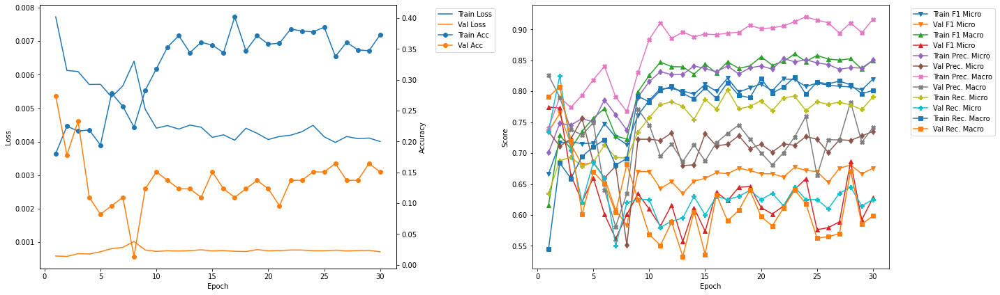

-------------------------------------------
FOLD 5
-------------------------------------------
Validation F1 Micro Score Increased (0.763889 --> 0.792651).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 18.66
Train Loss: 0.0074 	Validation Loss: 0.0005
Train Accuracy: 0.156 	Validation Accuracy: 0.2877
Train F1 Mirco: 0.6637 	Validation F1 Micro: 0.7927
Train F1 Marco: 0.6046 	Validation F1 Macro: 0.645
Train Precision Mirco: 0.6954 	Validation Precision Micro: 0.7989
Train Precision Marco: 0.6836 	Validation Precision Macro: 0.7189
Train Recall Mirco: 0.6348 	Validation Recall Micro: 0.7865
Train Recall Marco: 0.5494 	Validation Recall Macro: 0.665

Epoch 2 	Learning Rate: 0.01 	Time (min): 18.79
Train Loss: 0.0062 	Validation Loss: 0.0007
Train Accuracy: 0.2278 	Validation Accuracy: 0.137
Train F1 Mirco: 0.7212 	Validation F1 Micro: 0.7398
Train F1 Marco: 0.7373 	Validation F1 Macro: 0.6865
Train Precision Mirco: 0.7609 	Validation Precision Micro: 0.63
Train Precision 

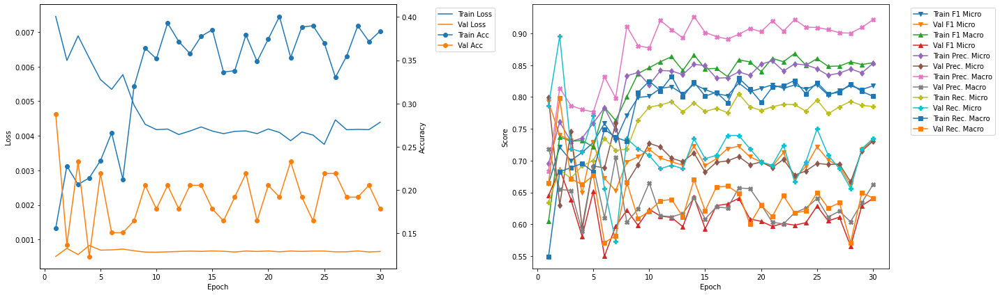

-------------------------------------------
FOLD 6
-------------------------------------------
Validation F1 Micro Score Increased (0.792651 --> 0.797814).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 22.37
Train Loss: 0.0075 	Validation Loss: 0.0005
Train Accuracy: 0.1483 	Validation Accuracy: 0.3425
Train F1 Mirco: 0.6678 	Validation F1 Micro: 0.7978
Train F1 Marco: 0.676 	Validation F1 Macro: 0.8033
Train Precision Mirco: 0.6951 	Validation Precision Micro: 0.8156
Train Precision Marco: 0.7377 	Validation Precision Macro: 0.8599
Train Recall Mirco: 0.6426 	Validation Recall Micro: 0.7807
Train Recall Marco: 0.629 	Validation Recall Macro: 0.8132

Epoch 2 	Learning Rate: 0.01 	Time (min): 22.49
Train Loss: 0.006 	Validation Loss: 0.0006
Train Accuracy: 0.2263 	Validation Accuracy: 0.2877
Train F1 Mirco: 0.7343 	Validation F1 Micro: 0.7904
Train F1 Marco: 0.7309 	Validation F1 Macro: 0.8054
Train Precision Mirco: 0.7633 	Validation Precision Micro: 0.7193
Train Precisi

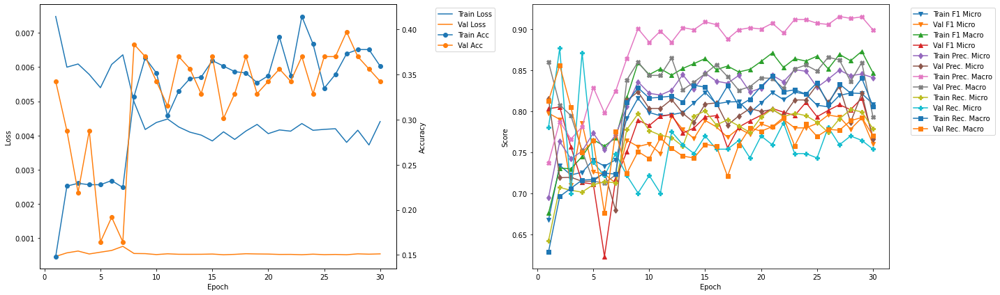

-------------------------------------------
FOLD 7
-------------------------------------------
Validation F1 Micro Score Increased (0.797814 --> 0.809045).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 26.07
Train Loss: 0.007 	Validation Loss: 0.0005
Train Accuracy: 0.1939 	Validation Accuracy: 0.3472
Train F1 Mirco: 0.6857 	Validation F1 Micro: 0.809
Train F1 Marco: 0.6927 	Validation F1 Macro: 0.707
Train Precision Mirco: 0.7134 	Validation Precision Micro: 0.801
Train Precision Marco: 0.7457 	Validation Precision Macro: 0.7599
Train Recall Mirco: 0.66 	Validation Recall Micro: 0.8173
Train Recall Marco: 0.6521 	Validation Recall Macro: 0.7044

Epoch 2 	Learning Rate: 0.01 	Time (min): 26.19
Train Loss: 0.0053 	Validation Loss: 0.0005
Train Accuracy: 0.2473 	Validation Accuracy: 0.4028
Train F1 Mirco: 0.7518 	Validation F1 Micro: 0.8011
Train F1 Marco: 0.7738 	Validation F1 Macro: 0.7319
Train Precision Mirco: 0.7753 	Validation Precision Micro: 0.8389
Train Precision 

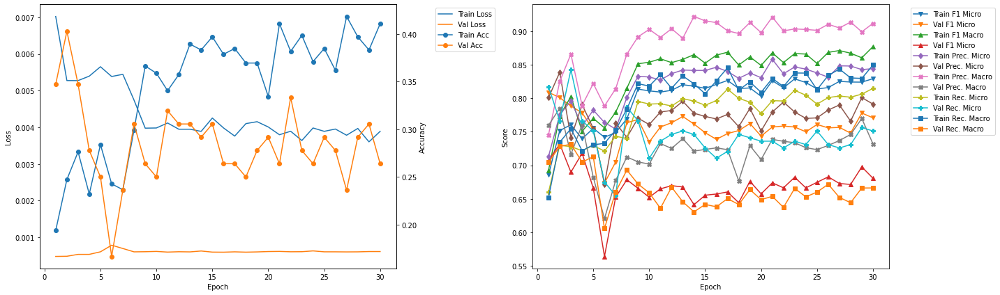

-------------------------------------------
FOLD 8
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 29.76
Train Loss: 0.0067 	Validation Loss: 0.0004
Train Accuracy: 0.1908 	Validation Accuracy: 0.2778
Train F1 Mirco: 0.6923 	Validation F1 Micro: 0.8056
Train F1 Marco: 0.6643 	Validation F1 Macro: 0.7493
Train Precision Mirco: 0.7164 	Validation Precision Micro: 0.8896
Train Precision Marco: 0.7682 	Validation Precision Macro: 0.7956
Train Recall Mirco: 0.6697 	Validation Recall Micro: 0.736
Train Recall Marco: 0.5988 	Validation Recall Macro: 0.7449

Epoch 2 	Learning Rate: 0.01 	Time (min): 29.88
Train Loss: 0.0054 	Validation Loss: 0.0006
Train Accuracy: 0.2626 	Validation Accuracy: 0.1806
Train F1 Mirco: 0.7493 	Validation F1 Micro: 0.7538
Train F1 Marco: 0.7831 	Validation F1 Macro: 0.7229
Train Precision Mirco: 0.7823 	Validation Precision Micro: 0.7463
Train Precision Marco: 0.8358 	Validation Precision Macro: 0.7495
Train Recall Mirco: 0.718

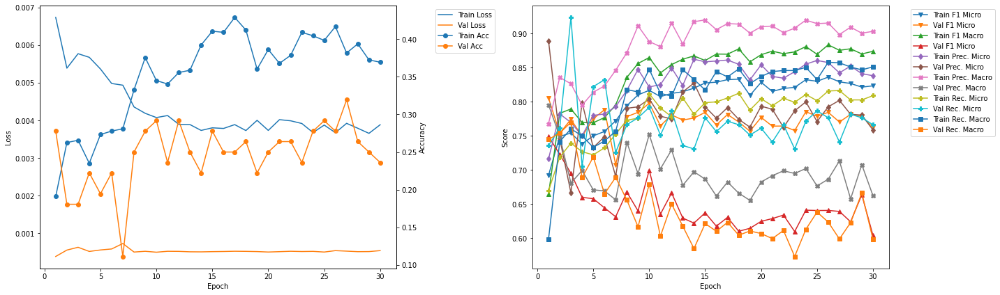

-------------------------------------------
FOLD 9
-------------------------------------------
Validation F1 Micro Score Increased (0.809045 --> 0.859259).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 33.46
Train Loss: 0.006 	Validation Loss: 0.0004
Train Accuracy: 0.2336 	Validation Accuracy: 0.4722
Train F1 Mirco: 0.7282 	Validation F1 Micro: 0.8593
Train F1 Marco: 0.7157 	Validation F1 Macro: 0.7506
Train Precision Mirco: 0.7588 	Validation Precision Micro: 0.8093
Train Precision Marco: 0.798 	Validation Precision Macro: 0.7513
Train Recall Mirco: 0.7001 	Validation Recall Micro: 0.9158
Train Recall Marco: 0.6615 	Validation Recall Macro: 0.7961

Epoch 2 	Learning Rate: 0.01 	Time (min): 33.58
Train Loss: 0.0057 	Validation Loss: 0.0005
Train Accuracy: 0.1954 	Validation Accuracy: 0.2778
Train F1 Mirco: 0.7327 	Validation F1 Micro: 0.7913
Train F1 Marco: 0.7628 	Validation F1 Macro: 0.7389
Train Precision Mirco: 0.7545 	Validation Precision Micro: 0.8156
Train Precis

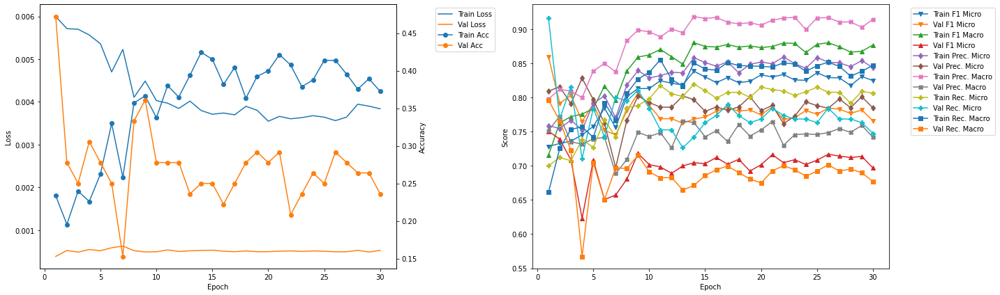

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 1
Train Loss: 0.006 	Validation Loss: 0.0004
Train Accuracy: 0.2336 	Validation Accuracy: 0.4722
Train F1 Mirco: 0.7282 	Validation F1 Micro: 0.8593
Train F1 Marco: 0.7157 	Validation F1 Macro: 0.7506
Train Precision Mirco: 0.7588 	Validation Precision Micro: 0.8093
Train Precision Marco: 0.798 	Validation Precision Macro: 0.7513
Train Recall Mirco: 0.7001 	Validation Recall Micro: 0.9158
Train Recall Marco: 0.6615 	Validation Recall Macro: 0.7961


In [70]:
Kfold_train_CNN(model = resnet18, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'resnet18')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.408602).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.14
Train Loss: 0.0322 	Validation Loss: 0.0032
Train Accuracy: 0.0413 	Validation Accuracy: 0.0
Train F1 Mirco: 0.3879 	Validation F1 Micro: 0.4086
Train F1 Marco: 0.128 	Validation F1 Macro: 0.0734
Train Precision Mirco: 0.3922 	Validation Precision Micro: 0.472
Train Precision Marco: 0.132 	Validation Precision Macro: 0.0897
Train Recall Mirco: 0.3836 	Validation Recall Micro: 0.3602
Train Recall Marco: 0.1255 	Validation Recall Macro: 0.097

Validation F1 Micro Score Increased (0.408602 --> 0.459948).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.28
Train Loss: 0.019 	Validation Loss: 0.003
Train Accuracy: 0.0688 	Validation Accuracy: 0.0685
Train F1 Mirco: 0.4799 	Validation F1 Micro: 0.4599
Train F1 Marco: 0.1527 	Validation F1 Macro: 0.1235
Train P

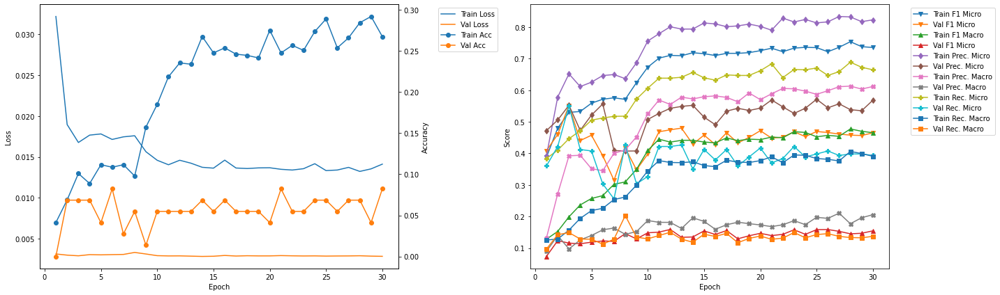

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.551069 --> 0.620896).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 4.3
Train Loss: 0.0258 	Validation Loss: 0.0013
Train Accuracy: 0.078 	Validation Accuracy: 0.1233
Train F1 Mirco: 0.5025 	Validation F1 Micro: 0.6209
Train F1 Marco: 0.2445 	Validation F1 Macro: 0.317
Train Precision Mirco: 0.5244 	Validation Precision Micro: 0.7027
Train Precision Marco: 0.2703 	Validation Precision Macro: 0.3505
Train Recall Mirco: 0.4824 	Validation Recall Micro: 0.5561
Train Recall Marco: 0.2307 	Validation Recall Macro: 0.3497

Validation F1 Micro Score Increased (0.620896 --> 0.700767).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 4.44
Train Loss: 0.0145 	Validation Loss: 0.0009
Train Accuracy: 0.1269 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.6052 	Validation F1 Micro: 0.7008
Train F1 Marco: 0.3348 	Validation F1 Macro: 0.4578
T

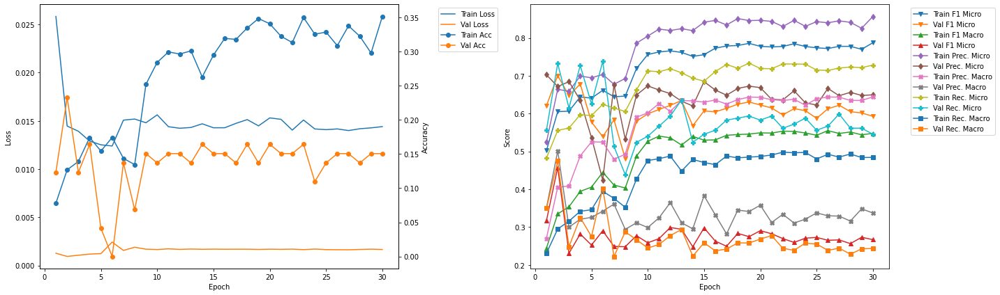

-------------------------------------------
FOLD 2
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 8.51
Train Loss: 0.0238 	Validation Loss: 0.0017
Train Accuracy: 0.0917 	Validation Accuracy: 0.2055
Train F1 Mirco: 0.5436 	Validation F1 Micro: 0.6649
Train F1 Marco: 0.2883 	Validation F1 Macro: 0.4059
Train Precision Mirco: 0.5759 	Validation Precision Micro: 0.672
Train Precision Marco: 0.3181 	Validation Precision Macro: 0.4575
Train Recall Mirco: 0.5148 	Validation Recall Micro: 0.658
Train Recall Marco: 0.2678 	Validation Recall Macro: 0.4442

Epoch 2 	Learning Rate: 0.01 	Time (min): 8.65
Train Loss: 0.0167 	Validation Loss: 0.0018
Train Accuracy: 0.1713 	Validation Accuracy: 0.0822
Train F1 Mirco: 0.663 	Validation F1 Micro: 0.4921
Train F1 Marco: 0.4204 	Validation F1 Macro: 0.3775
Train Precision Mirco: 0.7098 	Validation Precision Micro: 0.629
Train Precision Marco: 0.4803 	Validation Precision Macro: 0.5096
Train Recall Mirco: 0.622 	Val

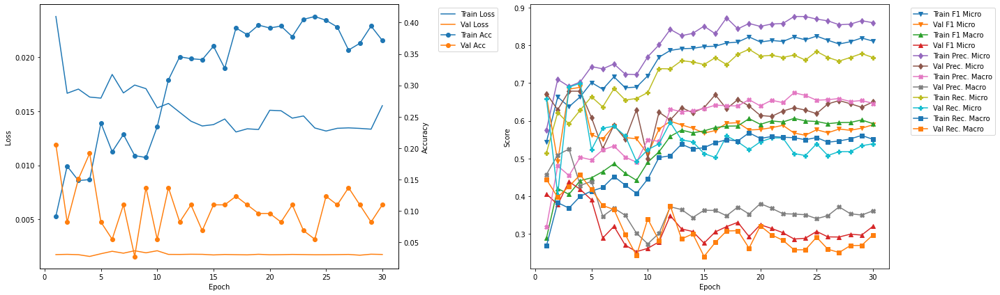

-------------------------------------------
FOLD 3
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 12.66
Train Loss: 0.0219 	Validation Loss: 0.002
Train Accuracy: 0.1131 	Validation Accuracy: 0.0411
Train F1 Mirco: 0.5799 	Validation F1 Micro: 0.6738
Train F1 Marco: 0.3508 	Validation F1 Macro: 0.4899
Train Precision Mirco: 0.6058 	Validation Precision Micro: 0.573
Train Precision Marco: 0.382 	Validation Precision Macro: 0.4908
Train Recall Mirco: 0.5561 	Validation Recall Micro: 0.8177
Train Recall Marco: 0.3275 	Validation Recall Macro: 0.5926

Validation F1 Micro Score Increased (0.700767 --> 0.746114).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 12.8
Train Loss: 0.0183 	Validation Loss: 0.0016
Train Accuracy: 0.2049 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.7026 	Validation F1 Micro: 0.7461
Train F1 Marco: 0.4757 	Validation F1 Macro: 0.5175
Train Precision Mirco: 0.7349 	Validation Precision Micro: 0.7423
Train Precisio

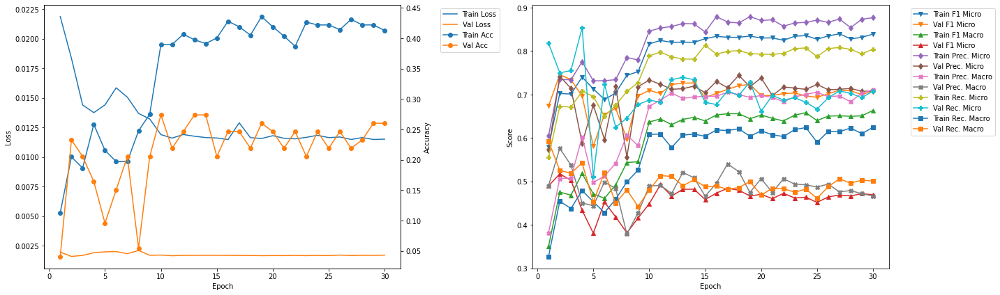

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 16.9
Train Loss: 0.022 	Validation Loss: 0.0013
Train Accuracy: 0.0948 	Validation Accuracy: 0.1233
Train F1 Mirco: 0.5904 	Validation F1 Micro: 0.5568
Train F1 Marco: 0.3631 	Validation F1 Macro: 0.3798
Train Precision Mirco: 0.6124 	Validation Precision Micro: 0.76
Train Precision Marco: 0.3833 	Validation Precision Macro: 0.551
Train Recall Mirco: 0.5699 	Validation Recall Micro: 0.4393
Train Recall Marco: 0.346 	Validation Recall Macro: 0.4003

Validation F1 Micro Score Increased (0.746114 --> 0.794595).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 17.04
Train Loss: 0.0142 	Validation Loss: 0.0011
Train Accuracy: 0.2554 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.7429 	Validation F1 Micro: 0.7946
Train F1 Marco: 0.5359 	Validation F1 Macro: 0.5465
Train Precision Mirco: 0.7768 	Validation Precision Micro: 0.7462
Train Precision 

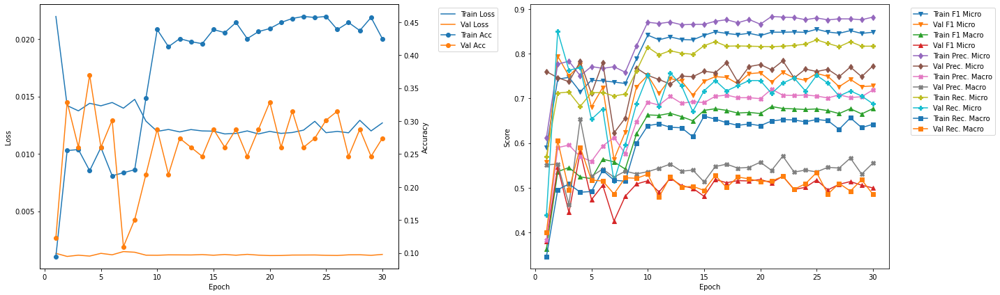

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 21.09
Train Loss: 0.0198 	Validation Loss: 0.001
Train Accuracy: 0.1437 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.6297 	Validation F1 Micro: 0.6989
Train F1 Marco: 0.4401 	Validation F1 Macro: 0.5091
Train Precision Mirco: 0.6485 	Validation Precision Micro: 0.7647
Train Precision Marco: 0.4724 	Validation Precision Macro: 0.632
Train Recall Mirco: 0.612 	Validation Recall Micro: 0.6436
Train Recall Marco: 0.4157 	Validation Recall Macro: 0.5304

Epoch 2 	Learning Rate: 0.01 	Time (min): 21.22
Train Loss: 0.0157 	Validation Loss: 0.001
Train Accuracy: 0.2156 	Validation Accuracy: 0.1918
Train F1 Mirco: 0.6942 	Validation F1 Micro: 0.748
Train F1 Marco: 0.4799 	Validation F1 Macro: 0.4291
Train Precision Mirco: 0.7256 	Validation Precision Micro: 0.8057
Train Precision Marco: 0.5167 	Validation Precision Macro: 0.4819
Train Recall Mirco: 0.6653 	V

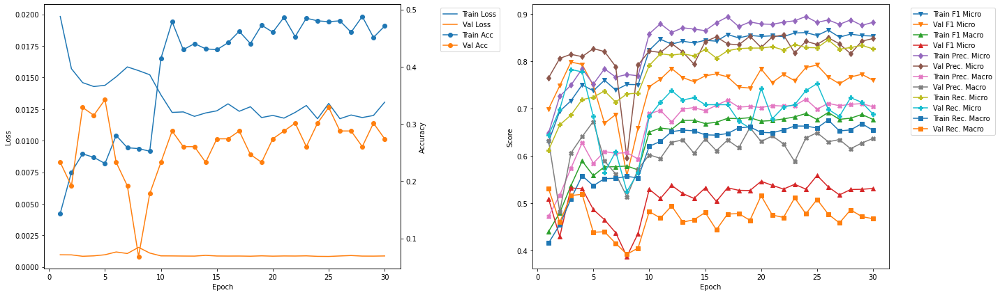

-------------------------------------------
FOLD 6
-------------------------------------------
Validation F1 Micro Score Increased (0.797980 --> 0.823266).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 25.25
Train Loss: 0.0194 	Validation Loss: 0.0016
Train Accuracy: 0.133 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.6198 	Validation F1 Micro: 0.8233
Train F1 Marco: 0.4247 	Validation F1 Macro: 0.607
Train Precision Mirco: 0.6375 	Validation Precision Micro: 0.8142
Train Precision Marco: 0.4556 	Validation Precision Macro: 0.631
Train Recall Mirco: 0.6031 	Validation Recall Micro: 0.8326
Train Recall Marco: 0.4037 	Validation Recall Macro: 0.6438

Epoch 2 	Learning Rate: 0.01 	Time (min): 25.38
Train Loss: 0.0141 	Validation Loss: 0.0017
Train Accuracy: 0.2538 	Validation Accuracy: 0.3014
Train F1 Mirco: 0.7353 	Validation F1 Micro: 0.7862
Train F1 Marco: 0.5073 	Validation F1 Macro: 0.5455
Train Precision Mirco: 0.7608 	Validation Precision Micro: 0.8602
Train Precisi

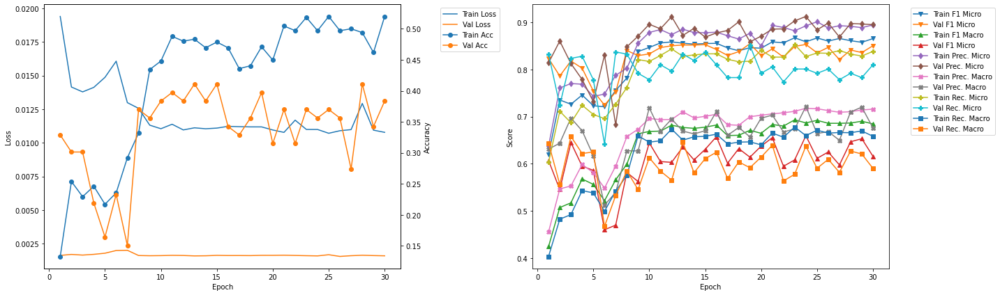

-------------------------------------------
FOLD 7
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 29.41
Train Loss: 0.0178 	Validation Loss: 0.0011
Train Accuracy: 0.1649 	Validation Accuracy: 0.1667
Train F1 Mirco: 0.6651 	Validation F1 Micro: 0.7225
Train F1 Marco: 0.448 	Validation F1 Macro: 0.6041
Train Precision Mirco: 0.6937 	Validation Precision Micro: 0.738
Train Precision Marco: 0.4833 	Validation Precision Macro: 0.6129
Train Recall Mirco: 0.6387 	Validation Recall Micro: 0.7077
Train Recall Marco: 0.4213 	Validation Recall Macro: 0.6595

Epoch 2 	Learning Rate: 0.01 	Time (min): 29.55
Train Loss: 0.0146 	Validation Loss: 0.001
Train Accuracy: 0.2244 	Validation Accuracy: 0.1528
Train F1 Mirco: 0.7294 	Validation F1 Micro: 0.7736
Train F1 Marco: 0.559 	Validation F1 Macro: 0.6224
Train Precision Mirco: 0.7727 	Validation Precision Micro: 0.7162
Train Precision Marco: 0.5947 	Validation Precision Macro: 0.653
Train Recall Mirco: 0.6906 	V

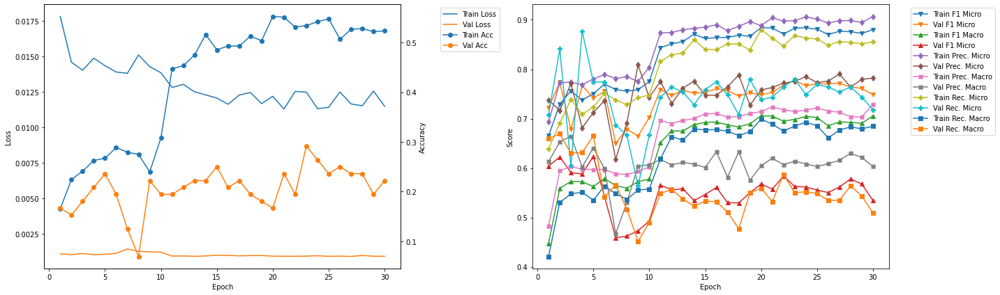

-------------------------------------------
FOLD 8
-------------------------------------------
Validation F1 Micro Score Increased (0.854545 --> 0.860465).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 33.55
Train Loss: 0.0179 	Validation Loss: 0.0016
Train Accuracy: 0.1679 	Validation Accuracy: 0.5417
Train F1 Mirco: 0.6659 	Validation F1 Micro: 0.8605
Train F1 Marco: 0.4695 	Validation F1 Macro: 0.6246
Train Precision Mirco: 0.6874 	Validation Precision Micro: 0.9367
Train Precision Marco: 0.4957 	Validation Precision Macro: 0.6883
Train Recall Mirco: 0.6457 	Validation Recall Micro: 0.7957
Train Recall Marco: 0.4485 	Validation Recall Macro: 0.6121

Epoch 2 	Learning Rate: 0.01 	Time (min): 33.69
Train Loss: 0.0126 	Validation Loss: 0.0018
Train Accuracy: 0.2779 	Validation Accuracy: 0.3889
Train F1 Mirco: 0.77 	Validation F1 Micro: 0.8262
Train F1 Marco: 0.5888 	Validation F1 Macro: 0.6454
Train Precision Mirco: 0.791 	Validation Precision Micro: 0.7773
Train Precisi

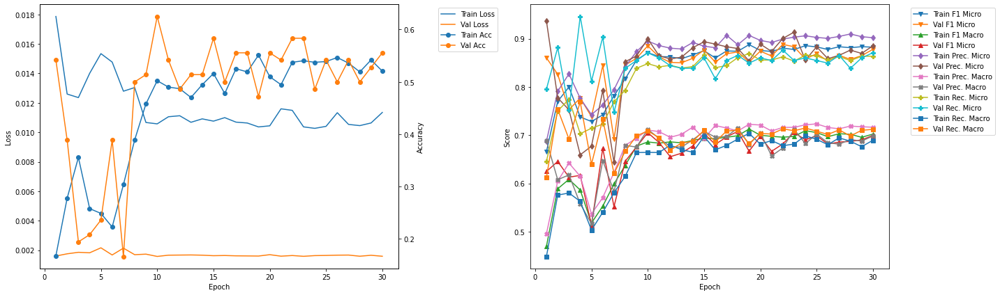

-------------------------------------------
FOLD 9
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 37.75
Train Loss: 0.0203 	Validation Loss: 0.0015
Train Accuracy: 0.1359 	Validation Accuracy: 0.3611
Train F1 Mirco: 0.6289 	Validation F1 Micro: 0.8184
Train F1 Marco: 0.4912 	Validation F1 Macro: 0.6108
Train Precision Mirco: 0.6474 	Validation Precision Micro: 0.8297
Train Precision Marco: 0.5117 	Validation Precision Macro: 0.6803
Train Recall Mirco: 0.6114 	Validation Recall Micro: 0.8075
Train Recall Marco: 0.4738 	Validation Recall Macro: 0.6392

Epoch 2 	Learning Rate: 0.01 	Time (min): 37.88
Train Loss: 0.0143 	Validation Loss: 0.0015
Train Accuracy: 0.2672 	Validation Accuracy: 0.4444
Train F1 Mirco: 0.752 	Validation F1 Micro: 0.8421
Train F1 Marco: 0.5649 	Validation F1 Macro: 0.6061
Train Precision Mirco: 0.7728 	Validation Precision Micro: 0.8736
Train Precision Marco: 0.5903 	Validation Precision Macro: 0.6471
Train Recall Mirco: 0.732

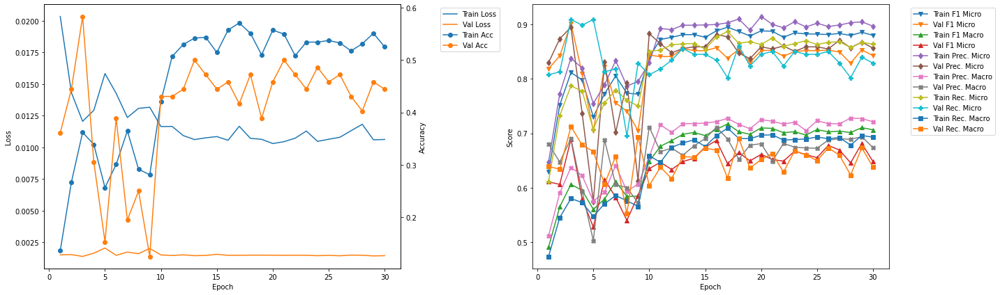

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 3
Train Loss: 0.0121 	Validation Loss: 0.0014
Train Accuracy: 0.3618 	Validation Accuracy: 0.5833
Train F1 Mirco: 0.8116 	Validation F1 Micro: 0.9019
Train F1 Marco: 0.6061 	Validation F1 Macro: 0.6891
Train Precision Mirco: 0.8379 	Validation Precision Micro: 0.8947
Train Precision Marco: 0.6374 	Validation Precision Macro: 0.6904
Train Recall Mirco: 0.7869 	Validation Recall Micro: 0.9091
Train Recall Marco: 0.5801 	Validation Recall Macro: 0.7123


In [71]:
Kfold_train_CNN(model = resnet50, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'resnet50')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.481752).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.16
Train Loss: 0.0275 	Validation Loss: 0.0025
Train Accuracy: 0.0352 	Validation Accuracy: 0.0411
Train F1 Mirco: 0.4036 	Validation F1 Micro: 0.4818
Train F1 Marco: 0.1256 	Validation F1 Macro: 0.1132
Train Precision Mirco: 0.4206 	Validation Precision Micro: 0.4267
Train Precision Marco: 0.1374 	Validation Precision Macro: 0.1064
Train Recall Mirco: 0.388 	Validation Recall Micro: 0.5531
Train Recall Marco: 0.1208 	Validation Recall Macro: 0.1647

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.32
Train Loss: 0.0181 	Validation Loss: 0.0027
Train Accuracy: 0.0902 	Validation Accuracy: 0.0274
Train F1 Mirco: 0.4962 	Validation F1 Micro: 0.4668
Train F1 Marco: 0.1576 	Validation F1 Macro: 0.0933
Train Precision Mirco: 0.5696 	Validation Precision Micro: 0.4167
Train Precisi

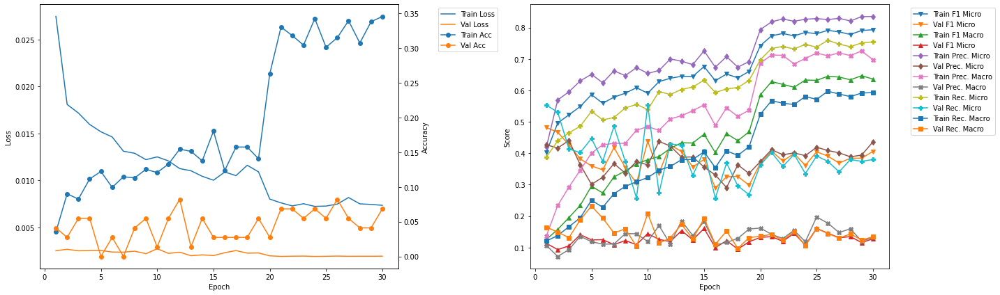

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.481752 --> 0.725441).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 4.88
Train Loss: 0.0204 	Validation Loss: 0.0009
Train Accuracy: 0.0795 	Validation Accuracy: 0.2192
Train F1 Mirco: 0.5259 	Validation F1 Micro: 0.7254
Train F1 Marco: 0.2834 	Validation F1 Macro: 0.4477
Train Precision Mirco: 0.5401 	Validation Precision Micro: 0.731
Train Precision Marco: 0.2981 	Validation Precision Macro: 0.5015
Train Recall Mirco: 0.5123 	Validation Recall Micro: 0.72
Train Recall Marco: 0.272 	Validation Recall Macro: 0.4852

Validation F1 Micro Score Increased (0.725441 --> 0.755760).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 5.04
Train Loss: 0.0108 	Validation Loss: 0.0008
Train Accuracy: 0.1606 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.6661 	Validation F1 Micro: 0.7558
Train F1 Marco: 0.4583 	Validation F1 Macro: 0.4954
Tr

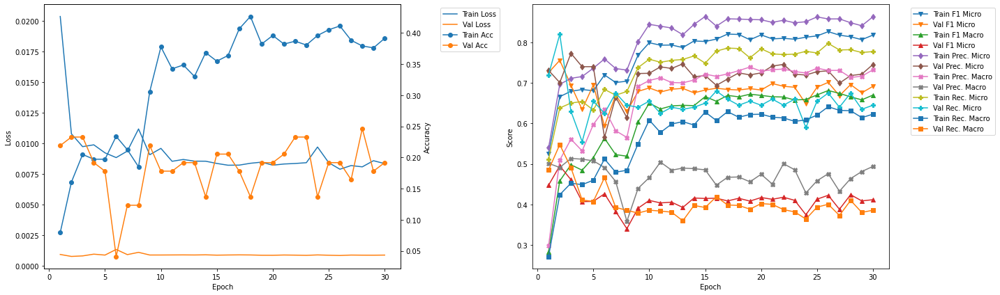

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.755760 --> 0.758294).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 9.58
Train Loss: 0.017 	Validation Loss: 0.0009
Train Accuracy: 0.1269 	Validation Accuracy: 0.274
Train F1 Mirco: 0.5836 	Validation F1 Micro: 0.7583
Train F1 Marco: 0.3686 	Validation F1 Macro: 0.5057
Train Precision Mirco: 0.6057 	Validation Precision Micro: 0.7619
Train Precision Marco: 0.4006 	Validation Precision Macro: 0.5627
Train Recall Mirco: 0.5631 	Validation Recall Micro: 0.7547
Train Recall Marco: 0.3448 	Validation Recall Macro: 0.5348

Epoch 2 	Learning Rate: 0.01 	Time (min): 9.74
Train Loss: 0.0113 	Validation Loss: 0.0011
Train Accuracy: 0.1942 	Validation Accuracy: 0.1233
Train F1 Mirco: 0.6761 	Validation F1 Micro: 0.7018
Train F1 Marco: 0.5181 	Validation F1 Macro: 0.5296
Train Precision Mirco: 0.7055 	Validation Precision Micro: 0.6557
Train Precisio

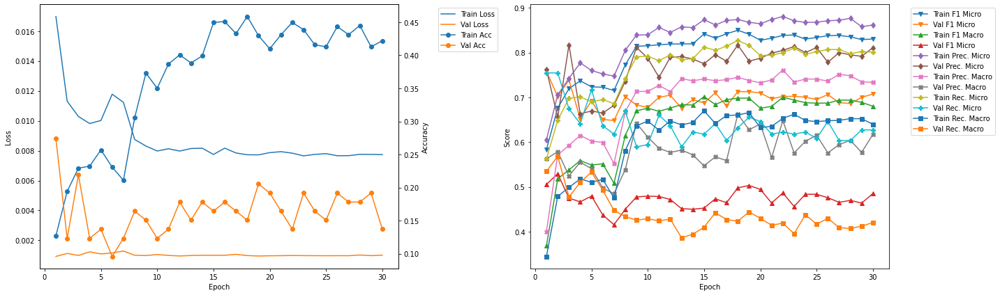

-------------------------------------------
FOLD 3
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 14.29
Train Loss: 0.0164 	Validation Loss: 0.0012
Train Accuracy: 0.1055 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.5864 	Validation F1 Micro: 0.6711
Train F1 Marco: 0.3773 	Validation F1 Macro: 0.3731
Train Precision Mirco: 0.5987 	Validation Precision Micro: 0.8279
Train Precision Marco: 0.396 	Validation Precision Macro: 0.5381
Train Recall Mirco: 0.5747 	Validation Recall Micro: 0.5642
Train Recall Marco: 0.3626 	Validation Recall Macro: 0.3838

Epoch 2 	Learning Rate: 0.01 	Time (min): 14.45
Train Loss: 0.0115 	Validation Loss: 0.0012
Train Accuracy: 0.1529 	Validation Accuracy: 0.1918
Train F1 Mirco: 0.6749 	Validation F1 Micro: 0.6326
Train F1 Marco: 0.5232 	Validation F1 Macro: 0.475
Train Precision Mirco: 0.706 	Validation Precision Micro: 0.7388
Train Precision Marco: 0.5744 	Validation Precision Macro: 0.5917
Train Recall Mirco: 0.6465 

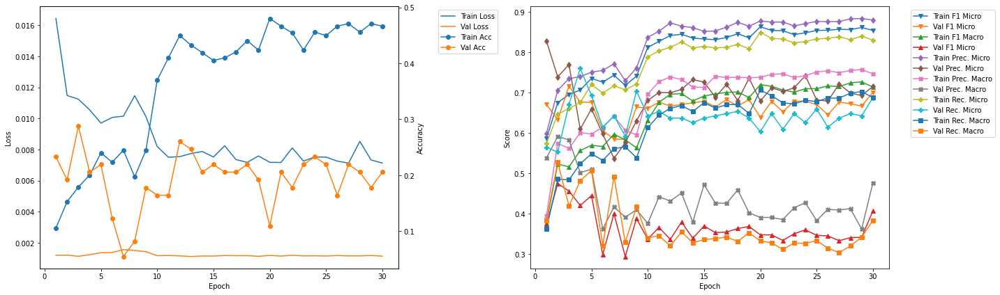

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 19.0
Train Loss: 0.0164 	Validation Loss: 0.0014
Train Accuracy: 0.1147 	Validation Accuracy: 0.2466
Train F1 Mirco: 0.607 	Validation F1 Micro: 0.6792
Train F1 Marco: 0.4535 	Validation F1 Macro: 0.4799
Train Precision Mirco: 0.6239 	Validation Precision Micro: 0.6825
Train Precision Marco: 0.4886 	Validation Precision Macro: 0.5181
Train Recall Mirco: 0.5911 	Validation Recall Micro: 0.6761
Train Recall Marco: 0.4261 	Validation Recall Macro: 0.538

Epoch 2 	Learning Rate: 0.01 	Time (min): 19.15
Train Loss: 0.0111 	Validation Loss: 0.0011
Train Accuracy: 0.2477 	Validation Accuracy: 0.2603
Train F1 Mirco: 0.7227 	Validation F1 Micro: 0.7374
Train F1 Marco: 0.5197 	Validation F1 Macro: 0.4944
Train Precision Mirco: 0.7397 	Validation Precision Micro: 0.8476
Train Precision Marco: 0.5478 	Validation Precision Macro: 0.629
Train Recall Mirco: 0.7065 	

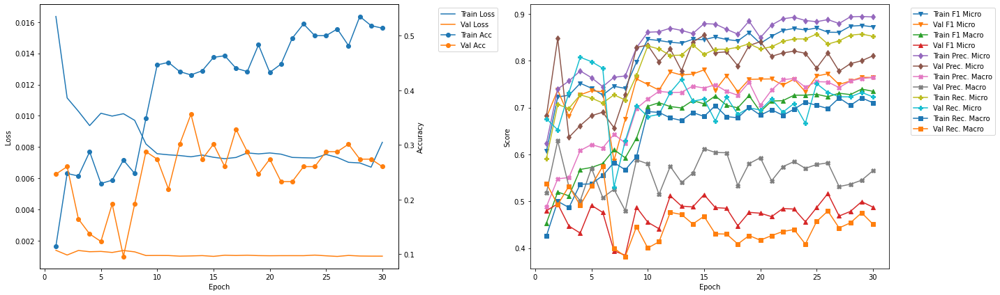

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 23.71
Train Loss: 0.0195 	Validation Loss: 0.0009
Train Accuracy: 0.1376 	Validation Accuracy: 0.1644
Train F1 Mirco: 0.5959 	Validation F1 Micro: 0.6904
Train F1 Marco: 0.4341 	Validation F1 Macro: 0.4399
Train Precision Mirco: 0.6143 	Validation Precision Micro: 0.67
Train Precision Marco: 0.4636 	Validation Precision Macro: 0.5089
Train Recall Mirco: 0.5786 	Validation Recall Micro: 0.712
Train Recall Marco: 0.4115 	Validation Recall Macro: 0.5015

Validation F1 Micro Score Increased (0.780612 --> 0.842105).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 23.87
Train Loss: 0.0105 	Validation Loss: 0.0004
Train Accuracy: 0.2462 	Validation Accuracy: 0.4521
Train F1 Mirco: 0.7425 	Validation F1 Micro: 0.8421
Train F1 Marco: 0.5703 	Validation F1 Macro: 0.6706
Train Precision Mirco: 0.7512 	Validation Precision Micro: 0.8466
Train Precisi

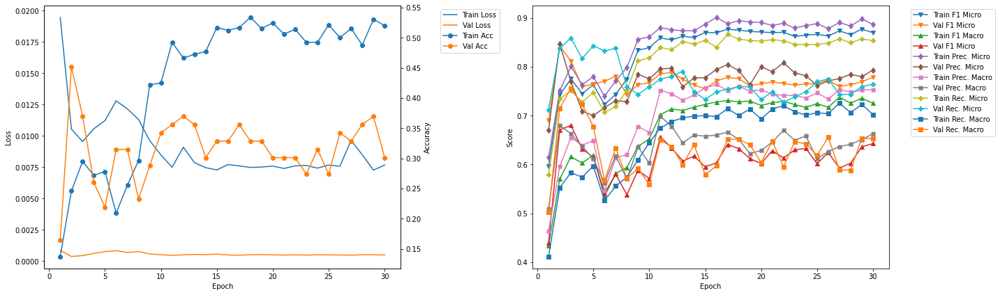

-------------------------------------------
FOLD 6
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 28.42
Train Loss: 0.0183 	Validation Loss: 0.0009
Train Accuracy: 0.133 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.6215 	Validation F1 Micro: 0.8051
Train F1 Marco: 0.4491 	Validation F1 Macro: 0.6426
Train Precision Mirco: 0.6306 	Validation Precision Micro: 0.7718
Train Precision Marco: 0.4581 	Validation Precision Macro: 0.6838
Train Recall Mirco: 0.6126 	Validation Recall Micro: 0.8413
Train Recall Marco: 0.4423 	Validation Recall Macro: 0.6403

Epoch 2 	Learning Rate: 0.01 	Time (min): 28.57
Train Loss: 0.0095 	Validation Loss: 0.0007
Train Accuracy: 0.2706 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.7446 	Validation F1 Micro: 0.8265
Train F1 Marco: 0.605 	Validation F1 Macro: 0.6491
Train Precision Mirco: 0.7683 	Validation Precision Micro: 0.798
Train Precision Marco: 0.6428 	Validation Precision Macro: 0.7024
Train Recall Mirco: 0.7224 

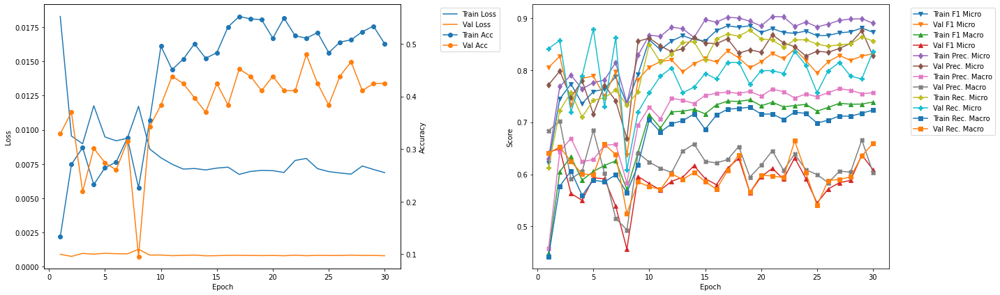

-------------------------------------------
FOLD 7
-------------------------------------------
Validation F1 Micro Score Increased (0.842105 --> 0.857788).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 33.13
Train Loss: 0.0131 	Validation Loss: 0.0018
Train Accuracy: 0.1832 	Validation Accuracy: 0.3611
Train F1 Mirco: 0.6692 	Validation F1 Micro: 0.8578
Train F1 Marco: 0.4656 	Validation F1 Macro: 0.6672
Train Precision Mirco: 0.6882 	Validation Precision Micro: 0.8225
Train Precision Marco: 0.4918 	Validation Precision Macro: 0.6655
Train Recall Mirco: 0.6513 	Validation Recall Micro: 0.8962
Train Recall Marco: 0.4437 	Validation Recall Macro: 0.7018

Validation F1 Micro Score Increased (0.857788 --> 0.870886).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 33.29
Train Loss: 0.0076 	Validation Loss: 0.0018
Train Accuracy: 0.3496 	Validation Accuracy: 0.4583
Train F1 Mirco: 0.7976 	Validation F1 Micro: 0.8709
Train F1 Marco: 0.6302 	Validation F1 Macro: 0.6

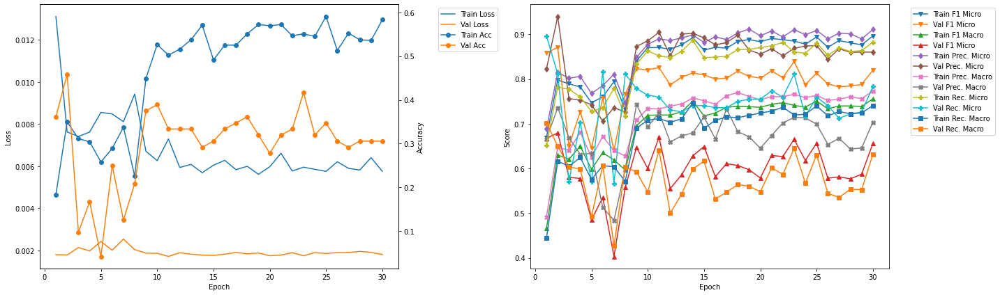

-------------------------------------------
FOLD 8
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 37.83
Train Loss: 0.0126 	Validation Loss: 0.0009
Train Accuracy: 0.226 	Validation Accuracy: 0.4861
Train F1 Mirco: 0.7102 	Validation F1 Micro: 0.8641
Train F1 Marco: 0.5319 	Validation F1 Macro: 0.7342
Train Precision Mirco: 0.7262 	Validation Precision Micro: 0.8785
Train Precision Marco: 0.5538 	Validation Precision Macro: 0.7579
Train Recall Mirco: 0.6949 	Validation Recall Micro: 0.8503
Train Recall Marco: 0.5134 	Validation Recall Macro: 0.7349

Epoch 2 	Learning Rate: 0.01 	Time (min): 37.99
Train Loss: 0.0091 	Validation Loss: 0.0011
Train Accuracy: 0.3282 	Validation Accuracy: 0.2222
Train F1 Mirco: 0.7942 	Validation F1 Micro: 0.7492
Train F1 Marco: 0.632 	Validation F1 Macro: 0.6431
Train Precision Mirco: 0.8107 	Validation Precision Micro: 0.8611
Train Precision Marco: 0.6542 	Validation Precision Macro: 0.7116
Train Recall Mirco: 0.7784

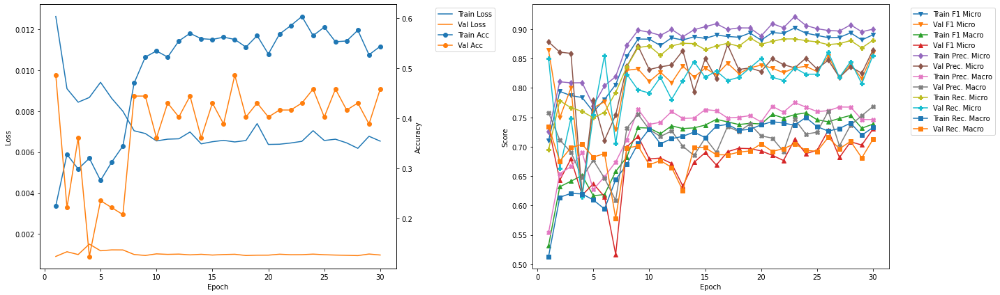

-------------------------------------------
FOLD 9
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 42.54
Train Loss: 0.0134 	Validation Loss: 0.0011
Train Accuracy: 0.1771 	Validation Accuracy: 0.4306
Train F1 Mirco: 0.6794 	Validation F1 Micro: 0.7873
Train F1 Marco: 0.4955 	Validation F1 Macro: 0.645
Train Precision Mirco: 0.693 	Validation Precision Micro: 0.9538
Train Precision Marco: 0.5142 	Validation Precision Macro: 0.7394
Train Recall Mirco: 0.6663 	Validation Recall Micro: 0.6703
Train Recall Marco: 0.4798 	Validation Recall Macro: 0.6239

Epoch 2 	Learning Rate: 0.01 	Time (min): 42.69
Train Loss: 0.0096 	Validation Loss: 0.0012
Train Accuracy: 0.2595 	Validation Accuracy: 0.2778
Train F1 Mirco: 0.758 	Validation F1 Micro: 0.8058
Train F1 Marco: 0.5913 	Validation F1 Macro: 0.6099
Train Precision Mirco: 0.7755 	Validation Precision Micro: 0.7241
Train Precision Marco: 0.6239 	Validation Precision Macro: 0.6114
Train Recall Mirco: 0.7412 

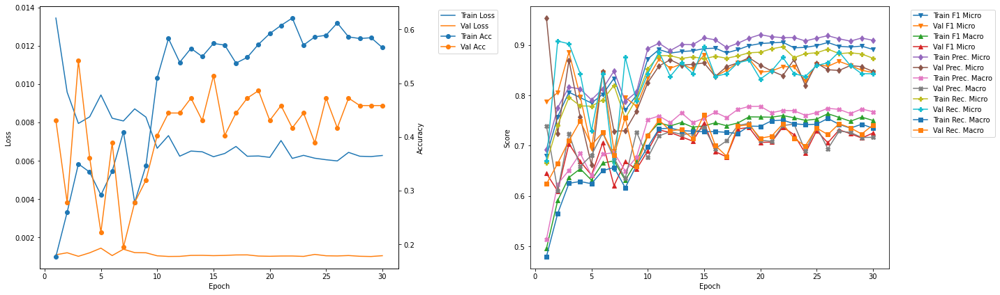

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 3
Train Loss: 0.0079 	Validation Loss: 0.001
Train Accuracy: 0.3496 	Validation Accuracy: 0.5417
Train F1 Mirco: 0.8063 	Validation F1 Micro: 0.8859
Train F1 Marco: 0.637 	Validation F1 Macro: 0.704
Train Precision Mirco: 0.8166 	Validation Precision Micro: 0.8698
Train Precision Marco: 0.6513 	Validation Precision Macro: 0.7237
Train Recall Mirco: 0.7963 	Validation Recall Micro: 0.9027
Train Recall Marco: 0.6254 	Validation Recall Macro: 0.7098


In [72]:
Kfold_train_CNN(model = resnet101, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'resnet101')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.391167).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.14
Train Loss: 0.0155 	Validation Loss: 0.0015
Train Accuracy: 0.0612 	Validation Accuracy: 0.0822
Train F1 Mirco: 0.429 	Validation F1 Micro: 0.3912
Train F1 Marco: 0.1027 	Validation F1 Macro: 0.0818
Train Precision Mirco: 0.4662 	Validation Precision Micro: 0.5962
Train Precision Marco: 0.1276 	Validation Precision Macro: 0.131
Train Recall Mirco: 0.3973 	Validation Recall Micro: 0.2911
Train Recall Marco: 0.1016 	Validation Recall Macro: 0.0831

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.29
Train Loss: 0.0104 	Validation Loss: 0.0014
Train Accuracy: 0.1086 	Validation Accuracy: 0.0548
Train F1 Mirco: 0.4959 	Validation F1 Micro: 0.3472
Train F1 Marco: 0.1254 	Validation F1 Macro: 0.0651
Train Precision Mirco: 0.6068 	Validation Precision Micro: 0.6667
Train Precisio

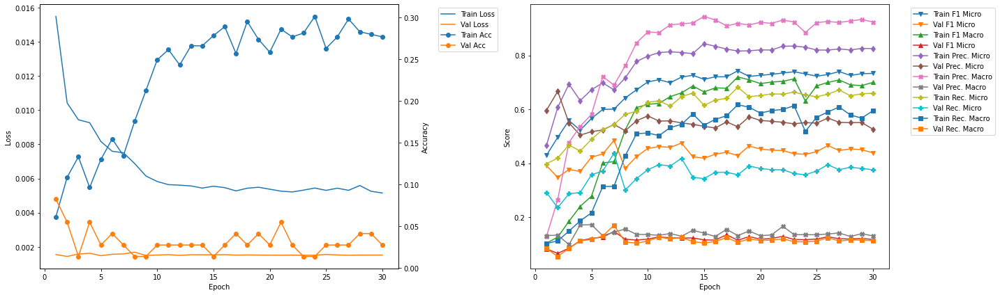

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.484375 --> 0.661458).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 4.41
Train Loss: 0.0101 	Validation Loss: 0.0008
Train Accuracy: 0.1254 	Validation Accuracy: 0.2055
Train F1 Mirco: 0.5609 	Validation F1 Micro: 0.6615
Train F1 Marco: 0.3118 	Validation F1 Macro: 0.4687
Train Precision Mirco: 0.6212 	Validation Precision Micro: 0.7216
Train Precision Marco: 0.422 	Validation Precision Macro: 0.6169
Train Recall Mirco: 0.5112 	Validation Recall Micro: 0.6106
Train Recall Marco: 0.261 	Validation Recall Macro: 0.474

Validation F1 Micro Score Increased (0.661458 --> 0.692124).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 4.55
Train Loss: 0.0074 	Validation Loss: 0.0007
Train Accuracy: 0.182 	Validation Accuracy: 0.2055
Train F1 Mirco: 0.6466 	Validation F1 Micro: 0.6921
Train F1 Marco: 0.5309 	Validation F1 Macro: 0.4798
Tr

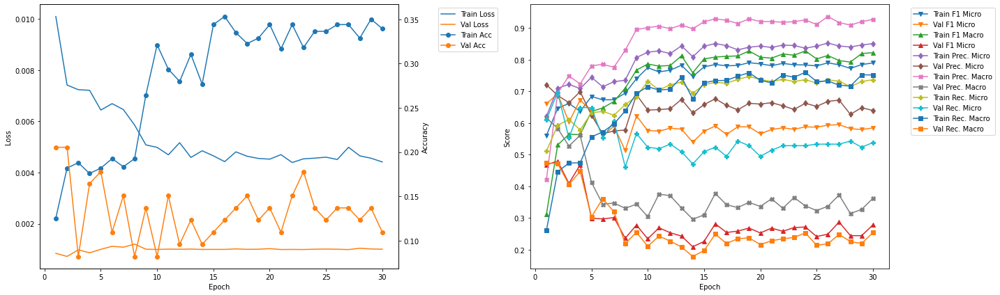

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.692124 --> 0.708791).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 8.67
Train Loss: 0.0077 	Validation Loss: 0.0006
Train Accuracy: 0.1651 	Validation Accuracy: 0.2055
Train F1 Mirco: 0.6462 	Validation F1 Micro: 0.7088
Train F1 Marco: 0.5867 	Validation F1 Macro: 0.5778
Train Precision Mirco: 0.6964 	Validation Precision Micro: 0.7866
Train Precision Marco: 0.7271 	Validation Precision Macro: 0.6355
Train Recall Mirco: 0.6027 	Validation Recall Micro: 0.645
Train Recall Marco: 0.505 	Validation Recall Macro: 0.6157

Validation F1 Micro Score Increased (0.708791 --> 0.764302).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 8.81
Train Loss: 0.0066 	Validation Loss: 0.0007
Train Accuracy: 0.1957 	Validation Accuracy: 0.2466
Train F1 Mirco: 0.6751 	Validation F1 Micro: 0.7643
Train F1 Marco: 0.6488 	Validation F1 Macro: 0.6332


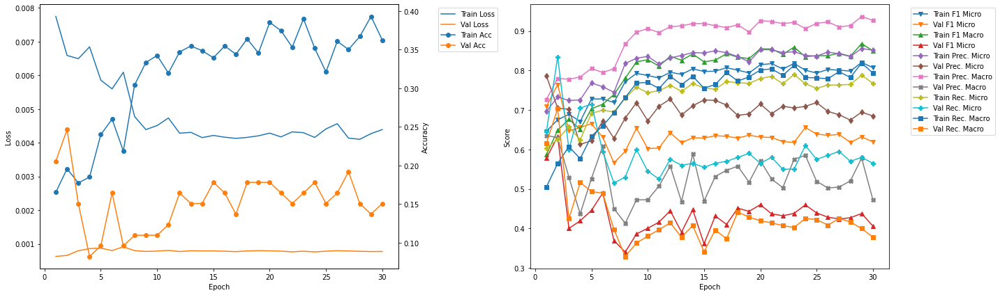

-------------------------------------------
FOLD 3
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 12.93
Train Loss: 0.0079 	Validation Loss: 0.0005
Train Accuracy: 0.1911 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.6675 	Validation F1 Micro: 0.7359
Train F1 Marco: 0.5844 	Validation F1 Macro: 0.4672
Train Precision Mirco: 0.6983 	Validation Precision Micro: 0.7561
Train Precision Marco: 0.6513 	Validation Precision Macro: 0.5291
Train Recall Mirco: 0.6392 	Validation Recall Micro: 0.7168
Train Recall Marco: 0.5345 	Validation Recall Macro: 0.4818

Epoch 2 	Learning Rate: 0.01 	Time (min): 13.07
Train Loss: 0.006 	Validation Loss: 0.0005
Train Accuracy: 0.2187 	Validation Accuracy: 0.3425
Train F1 Mirco: 0.7173 	Validation F1 Micro: 0.7356
Train F1 Marco: 0.7079 	Validation F1 Macro: 0.535
Train Precision Mirco: 0.7509 	Validation Precision Micro: 0.7756
Train Precision Marco: 0.7858 	Validation Precision Macro: 0.5598
Train Recall Mirco: 0.6866

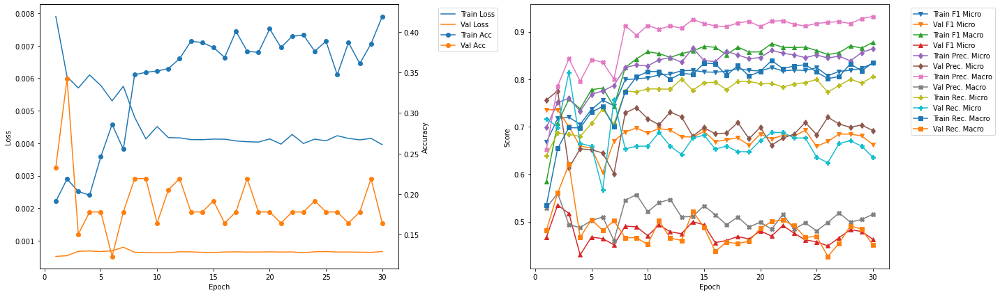

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 17.19
Train Loss: 0.0069 	Validation Loss: 0.0006
Train Accuracy: 0.1881 	Validation Accuracy: 0.2192
Train F1 Mirco: 0.6859 	Validation F1 Micro: 0.7443
Train F1 Marco: 0.6322 	Validation F1 Macro: 0.6409
Train Precision Mirco: 0.7223 	Validation Precision Micro: 0.7462
Train Precision Marco: 0.7263 	Validation Precision Macro: 0.6784
Train Recall Mirco: 0.6529 	Validation Recall Micro: 0.7424
Train Recall Marco: 0.5755 	Validation Recall Macro: 0.6662

Validation F1 Micro Score Increased (0.764302 --> 0.795756).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 17.33
Train Loss: 0.0059 	Validation Loss: 0.0005
Train Accuracy: 0.2309 	Validation Accuracy: 0.3425
Train F1 Mirco: 0.7177 	Validation F1 Micro: 0.7958
Train F1 Marco: 0.7311 	Validation F1 Macro: 0.6776
Train Precision Mirco: 0.7489 	Validation Precision Micro: 0.838
Train Preci

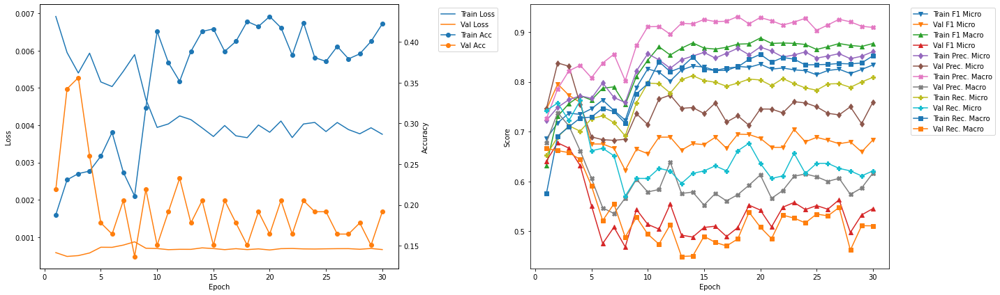

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 21.45
Train Loss: 0.007 	Validation Loss: 0.0005
Train Accuracy: 0.2018 	Validation Accuracy: 0.3014
Train F1 Mirco: 0.6985 	Validation F1 Micro: 0.7685
Train F1 Marco: 0.6512 	Validation F1 Macro: 0.6673
Train Precision Mirco: 0.7301 	Validation Precision Micro: 0.7189
Train Precision Marco: 0.7583 	Validation Precision Macro: 0.6575
Train Recall Mirco: 0.6695 	Validation Recall Micro: 0.8254
Train Recall Marco: 0.5827 	Validation Recall Macro: 0.7176

Epoch 2 	Learning Rate: 0.01 	Time (min): 21.59
Train Loss: 0.0056 	Validation Loss: 0.0007
Train Accuracy: 0.2431 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.7456 	Validation F1 Micro: 0.6872
Train F1 Marco: 0.7569 	Validation F1 Macro: 0.6361
Train Precision Mirco: 0.7572 	Validation Precision Micro: 0.7278
Train Precision Marco: 0.8016 	Validation Precision Macro: 0.7507
Train Recall Mirco: 0.734

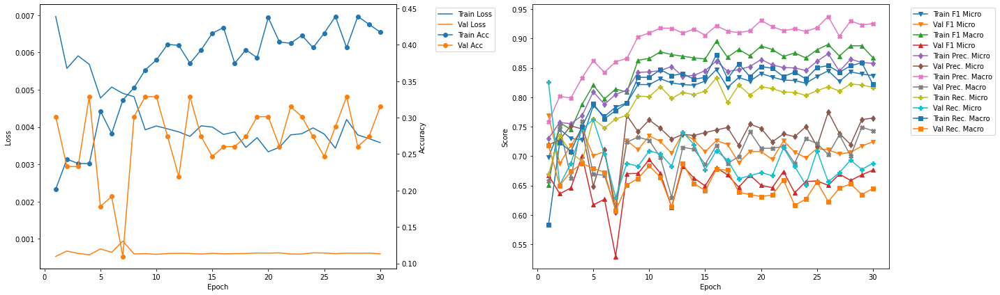

-------------------------------------------
FOLD 6
-------------------------------------------
Validation F1 Micro Score Increased (0.795756 --> 0.860577).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 25.72
Train Loss: 0.007 	Validation Loss: 0.0003
Train Accuracy: 0.211 	Validation Accuracy: 0.411
Train F1 Mirco: 0.6973 	Validation F1 Micro: 0.8606
Train F1 Marco: 0.7139 	Validation F1 Macro: 0.833
Train Precision Mirco: 0.7271 	Validation Precision Micro: 0.8483
Train Precision Marco: 0.79 	Validation Precision Macro: 0.8648
Train Recall Mirco: 0.6699 	Validation Recall Micro: 0.8732
Train Recall Marco: 0.6568 	Validation Recall Macro: 0.8595

Epoch 2 	Learning Rate: 0.01 	Time (min): 25.86
Train Loss: 0.0056 	Validation Loss: 0.0004
Train Accuracy: 0.2875 	Validation Accuracy: 0.3973
Train F1 Mirco: 0.7693 	Validation F1 Micro: 0.835
Train F1 Marco: 0.7818 	Validation F1 Macro: 0.8234
Train Precision Mirco: 0.7819 	Validation Precision Micro: 0.8309
Train Precision M

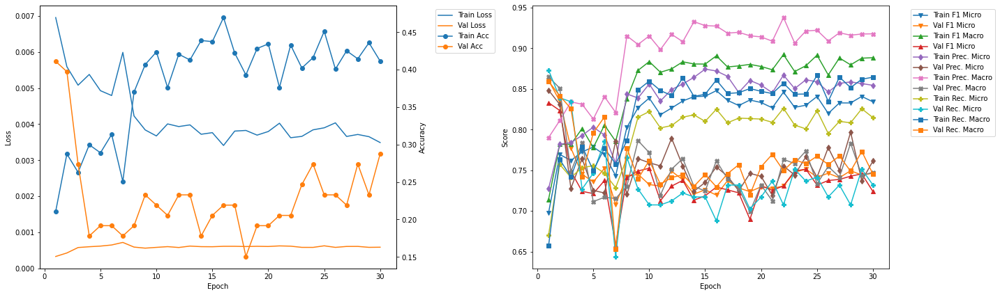

-------------------------------------------
FOLD 7
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 29.98
Train Loss: 0.0066 	Validation Loss: 0.0005
Train Accuracy: 0.2076 	Validation Accuracy: 0.2917
Train F1 Mirco: 0.717 	Validation F1 Micro: 0.7902
Train F1 Marco: 0.7244 	Validation F1 Macro: 0.7115
Train Precision Mirco: 0.7372 	Validation Precision Micro: 0.8192
Train Precision Marco: 0.7986 	Validation Precision Macro: 0.7481
Train Recall Mirco: 0.6978 	Validation Recall Micro: 0.7632
Train Recall Marco: 0.6705 	Validation Recall Macro: 0.7353

Epoch 2 	Learning Rate: 0.01 	Time (min): 30.12
Train Loss: 0.0053 	Validation Loss: 0.0005
Train Accuracy: 0.2672 	Validation Accuracy: 0.2917
Train F1 Mirco: 0.7603 	Validation F1 Micro: 0.7674
Train F1 Marco: 0.7986 	Validation F1 Macro: 0.6291
Train Precision Mirco: 0.7794 	Validation Precision Micro: 0.8571
Train Precision Marco: 0.8326 	Validation Precision Macro: 0.6389
Train Recall Mirco: 0.742

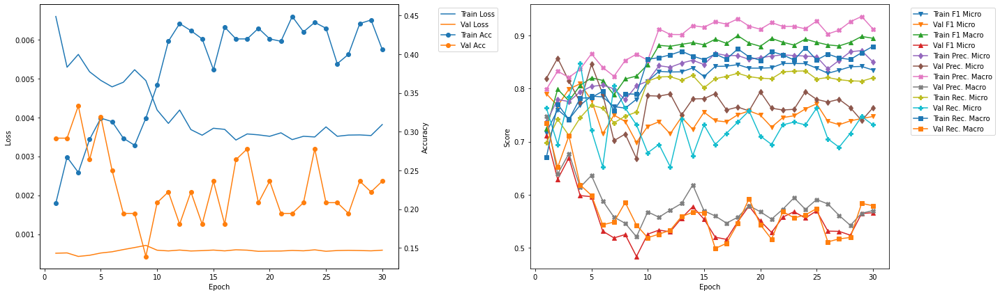

-------------------------------------------
FOLD 8
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 34.24
Train Loss: 0.0057 	Validation Loss: 0.0004
Train Accuracy: 0.2611 	Validation Accuracy: 0.3472
Train F1 Mirco: 0.7508 	Validation F1 Micro: 0.7944
Train F1 Marco: 0.7657 	Validation F1 Macro: 0.7717
Train Precision Mirco: 0.7706 	Validation Precision Micro: 0.773
Train Precision Marco: 0.8151 	Validation Precision Macro: 0.7879
Train Recall Mirco: 0.7319 	Validation Recall Micro: 0.8171
Train Recall Marco: 0.7255 	Validation Recall Macro: 0.794

Epoch 2 	Learning Rate: 0.01 	Time (min): 34.38
Train Loss: 0.0052 	Validation Loss: 0.0004
Train Accuracy: 0.2534 	Validation Accuracy: 0.3611
Train F1 Mirco: 0.7524 	Validation F1 Micro: 0.7896
Train F1 Marco: 0.7853 	Validation F1 Macro: 0.7443
Train Precision Mirco: 0.7672 	Validation Precision Micro: 0.7965
Train Precision Marco: 0.8227 	Validation Precision Macro: 0.7976
Train Recall Mirco: 0.7381

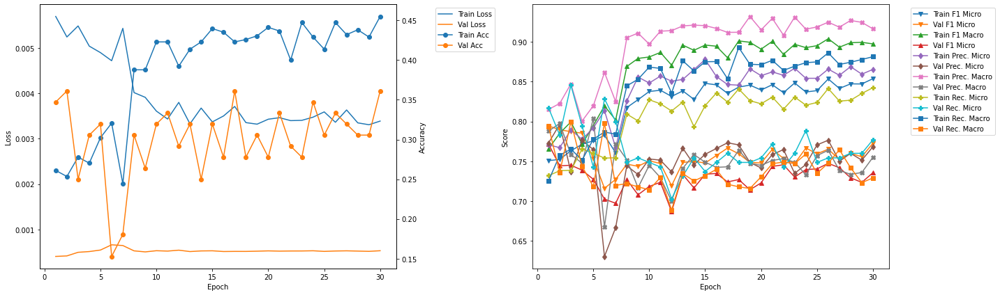

-------------------------------------------
FOLD 9
-------------------------------------------
Validation F1 Micro Score Increased (0.860577 --> 0.879012).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 38.5
Train Loss: 0.0062 	Validation Loss: 0.0003
Train Accuracy: 0.2687 	Validation Accuracy: 0.5
Train F1 Mirco: 0.7413 	Validation F1 Micro: 0.879
Train F1 Marco: 0.7439 	Validation F1 Macro: 0.7787
Train Precision Mirco: 0.763 	Validation Precision Micro: 0.8517
Train Precision Marco: 0.806 	Validation Precision Macro: 0.7728
Train Recall Mirco: 0.7207 	Validation Recall Micro: 0.9082
Train Recall Marco: 0.6986 	Validation Recall Macro: 0.8114

Epoch 2 	Learning Rate: 0.01 	Time (min): 38.64
Train Loss: 0.005 	Validation Loss: 0.0005
Train Accuracy: 0.2916 	Validation Accuracy: 0.2778
Train F1 Mirco: 0.7682 	Validation F1 Micro: 0.7455
Train F1 Marco: 0.7912 	Validation F1 Macro: 0.7462
Train Precision Mirco: 0.7758 	Validation Precision Micro: 0.9179
Train Precision Ma

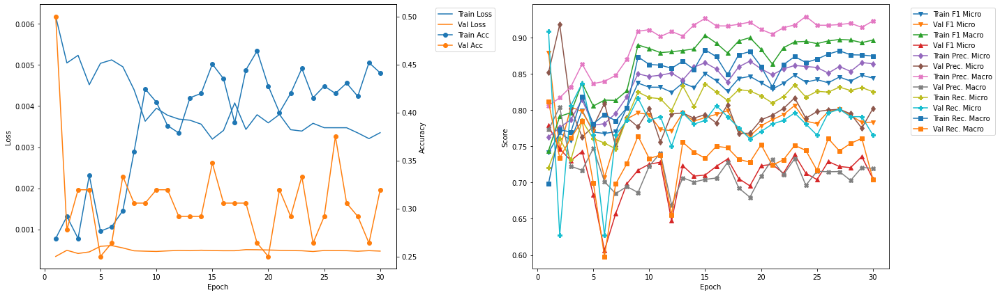

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 1
Train Loss: 0.0062 	Validation Loss: 0.0003
Train Accuracy: 0.2687 	Validation Accuracy: 0.5
Train F1 Mirco: 0.7413 	Validation F1 Micro: 0.879
Train F1 Marco: 0.7439 	Validation F1 Macro: 0.7787
Train Precision Mirco: 0.763 	Validation Precision Micro: 0.8517
Train Precision Marco: 0.806 	Validation Precision Macro: 0.7728
Train Recall Mirco: 0.7207 	Validation Recall Micro: 0.9082
Train Recall Marco: 0.6986 	Validation Recall Macro: 0.8114


In [73]:
Kfold_train_CNN(model = densenet121, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'densenet121')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.443114).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.16
Train Loss: 0.0184 	Validation Loss: 0.0018
Train Accuracy: 0.0627 	Validation Accuracy: 0.0685
Train F1 Mirco: 0.4214 	Validation F1 Micro: 0.4431
Train F1 Marco: 0.1203 	Validation F1 Macro: 0.0888
Train Precision Mirco: 0.4494 	Validation Precision Micro: 0.6116
Train Precision Marco: 0.1464 	Validation Precision Macro: 0.0947
Train Recall Mirco: 0.3968 	Validation Recall Micro: 0.3474
Train Recall Marco: 0.1141 	Validation Recall Macro: 0.1

Validation F1 Micro Score Increased (0.443114 --> 0.475676).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.31
Train Loss: 0.011 	Validation Loss: 0.0016
Train Accuracy: 0.0749 	Validation Accuracy: 0.0411
Train F1 Mirco: 0.4919 	Validation F1 Micro: 0.4757
Train F1 Marco: 0.1539 	Validation F1 Macro: 0.0901
Tr

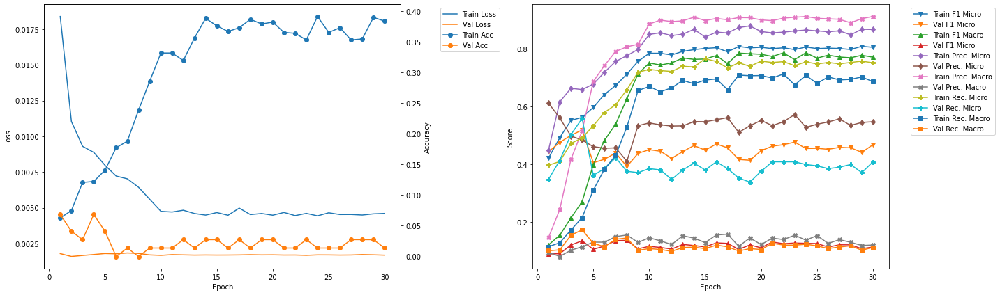

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.518519 --> 0.645570).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 4.74
Train Loss: 0.01 	Validation Loss: 0.0006
Train Accuracy: 0.1483 	Validation Accuracy: 0.1096
Train F1 Mirco: 0.6144 	Validation F1 Micro: 0.6456
Train F1 Marco: 0.4503 	Validation F1 Macro: 0.5248
Train Precision Mirco: 0.6614 	Validation Precision Micro: 0.7846
Train Precision Marco: 0.6134 	Validation Precision Macro: 0.6478
Train Recall Mirco: 0.5735 	Validation Recall Micro: 0.5484
Train Recall Marco: 0.3772 	Validation Recall Macro: 0.5298

Epoch 2 	Learning Rate: 0.01 	Time (min): 4.89
Train Loss: 0.0069 	Validation Loss: 0.0008
Train Accuracy: 0.2003 	Validation Accuracy: 0.1644
Train F1 Mirco: 0.6822 	Validation F1 Micro: 0.6136
Train F1 Marco: 0.5595 	Validation F1 Macro: 0.5251
Train Precision Mirco: 0.7386 	Validation Precision Micro: 0.6797
Train Precisio

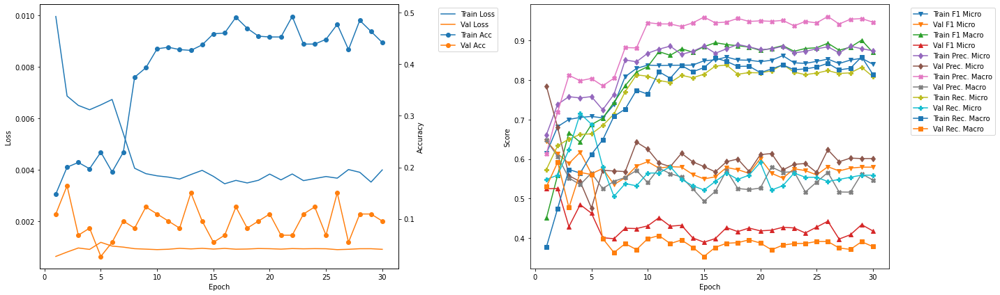

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.645570 --> 0.802632).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 9.3
Train Loss: 0.0076 	Validation Loss: 0.0005
Train Accuracy: 0.1697 	Validation Accuracy: 0.274
Train F1 Mirco: 0.6567 	Validation F1 Micro: 0.8026
Train F1 Marco: 0.6171 	Validation F1 Macro: 0.7117
Train Precision Mirco: 0.7022 	Validation Precision Micro: 0.7349
Train Precision Marco: 0.7279 	Validation Precision Macro: 0.6993
Train Recall Mirco: 0.6167 	Validation Recall Micro: 0.8841
Train Recall Marco: 0.5413 	Validation Recall Macro: 0.7858

Validation F1 Micro Score Increased (0.802632 --> 0.843602).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 9.45
Train Loss: 0.0055 	Validation Loss: 0.0004
Train Accuracy: 0.2783 	Validation Accuracy: 0.3836
Train F1 Mirco: 0.7429 	Validation F1 Micro: 0.8436
Train F1 Marco: 0.7366 	Validation F1 Macro: 0.737
T

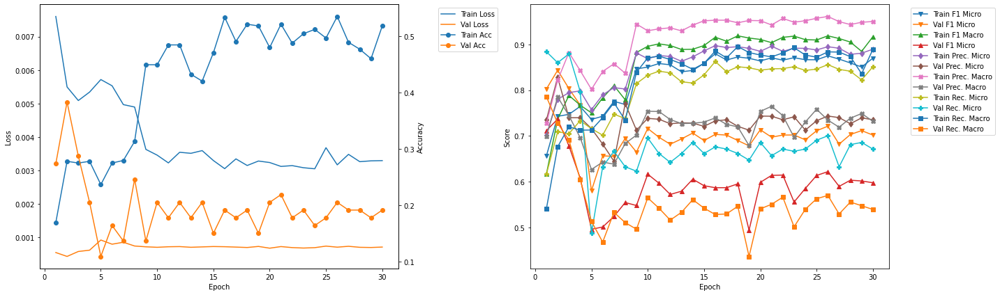

-------------------------------------------
FOLD 3
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 13.88
Train Loss: 0.0073 	Validation Loss: 0.0005
Train Accuracy: 0.1835 	Validation Accuracy: 0.2603
Train F1 Mirco: 0.6873 	Validation F1 Micro: 0.8369
Train F1 Marco: 0.6677 	Validation F1 Macro: 0.6699
Train Precision Mirco: 0.726 	Validation Precision Micro: 0.7588
Train Precision Marco: 0.7519 	Validation Precision Macro: 0.6486
Train Recall Mirco: 0.6525 	Validation Recall Micro: 0.933
Train Recall Marco: 0.6048 	Validation Recall Macro: 0.7286

Epoch 2 	Learning Rate: 0.01 	Time (min): 14.03
Train Loss: 0.006 	Validation Loss: 0.0005
Train Accuracy: 0.237 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.7452 	Validation F1 Micro: 0.8238
Train F1 Marco: 0.7436 	Validation F1 Macro: 0.615
Train Precision Mirco: 0.7719 	Validation Precision Micro: 0.8199
Train Precision Marco: 0.7948 	Validation Precision Macro: 0.643
Train Recall Mirco: 0.7204 	Va

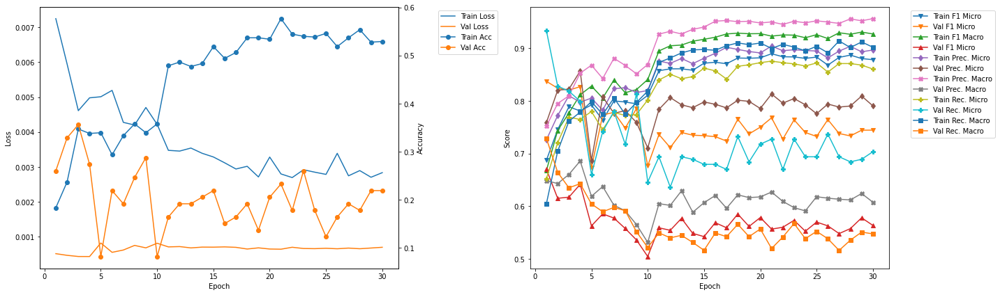

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 18.45
Train Loss: 0.0062 	Validation Loss: 0.0005
Train Accuracy: 0.2691 	Validation Accuracy: 0.274
Train F1 Mirco: 0.7454 	Validation F1 Micro: 0.7721
Train F1 Marco: 0.7163 	Validation F1 Macro: 0.7141
Train Precision Mirco: 0.7621 	Validation Precision Micro: 0.8276
Train Precision Marco: 0.7891 	Validation Precision Macro: 0.7183
Train Recall Mirco: 0.7294 	Validation Recall Micro: 0.7236
Train Recall Marco: 0.6647 	Validation Recall Macro: 0.7998

Validation F1 Micro Score Increased (0.843602 --> 0.869779).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 18.6
Train Loss: 0.0045 	Validation Loss: 0.0003
Train Accuracy: 0.3471 	Validation Accuracy: 0.4247
Train F1 Mirco: 0.794 	Validation F1 Micro: 0.8698
Train F1 Marco: 0.8312 	Validation F1 Macro: 0.8294
Train Precision Mirco: 0.8201 	Validation Precision Micro: 0.851
Train Precisio

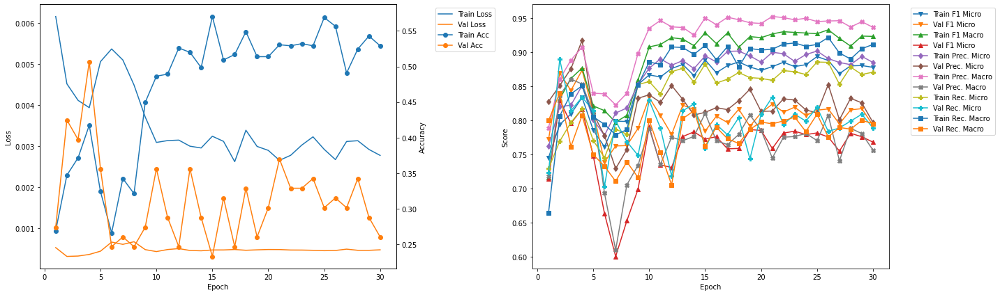

-------------------------------------------
FOLD 5
-------------------------------------------
Validation F1 Micro Score Increased (0.873684 --> 0.912568).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 23.03
Train Loss: 0.0059 	Validation Loss: 0.0002
Train Accuracy: 0.2523 	Validation Accuracy: 0.6575
Train F1 Mirco: 0.7511 	Validation F1 Micro: 0.9126
Train F1 Marco: 0.7421 	Validation F1 Macro: 0.8724
Train Precision Mirco: 0.7682 	Validation Precision Micro: 0.9126
Train Precision Marco: 0.7958 	Validation Precision Macro: 0.8809
Train Recall Mirco: 0.7347 	Validation Recall Micro: 0.9126
Train Recall Marco: 0.7029 	Validation Recall Macro: 0.8662

Epoch 2 	Learning Rate: 0.01 	Time (min): 23.18
Train Loss: 0.0042 	Validation Loss: 0.0004
Train Accuracy: 0.37 	Validation Accuracy: 0.411
Train F1 Mirco: 0.8168 	Validation F1 Micro: 0.8462
Train F1 Marco: 0.8262 	Validation F1 Macro: 0.7948
Train Precision Mirco: 0.8315 	Validation Precision Micro: 0.7971
Train Precisi

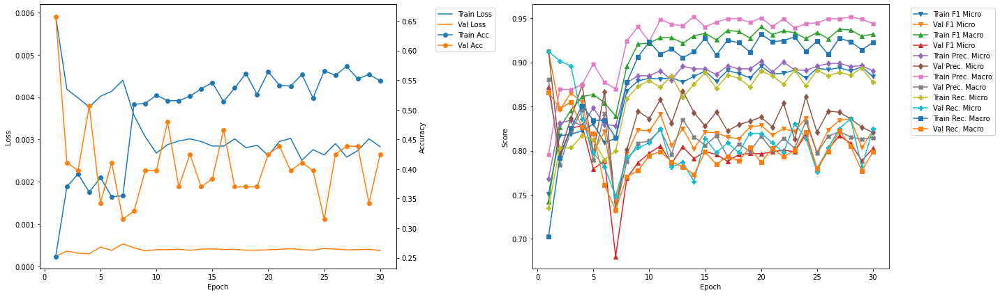

-------------------------------------------
FOLD 6
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 27.61
Train Loss: 0.0056 	Validation Loss: 0.0005
Train Accuracy: 0.2951 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.7759 	Validation F1 Micro: 0.7956
Train F1 Marco: 0.7858 	Validation F1 Macro: 0.7961
Train Precision Mirco: 0.7894 	Validation Precision Micro: 0.8391
Train Precision Marco: 0.8383 	Validation Precision Macro: 0.833
Train Recall Mirco: 0.7628 	Validation Recall Micro: 0.7565
Train Recall Marco: 0.7458 	Validation Recall Macro: 0.8175

Epoch 2 	Learning Rate: 0.01 	Time (min): 27.76
Train Loss: 0.0047 	Validation Loss: 0.0003
Train Accuracy: 0.3685 	Validation Accuracy: 0.4795
Train F1 Mirco: 0.8037 	Validation F1 Micro: 0.8698
Train F1 Marco: 0.8524 	Validation F1 Macro: 0.8327
Train Precision Mirco: 0.8128 	Validation Precision Micro: 0.8743
Train Precision Marco: 0.8786 	Validation Precision Macro: 0.8493
Train Recall Mirco: 0.794

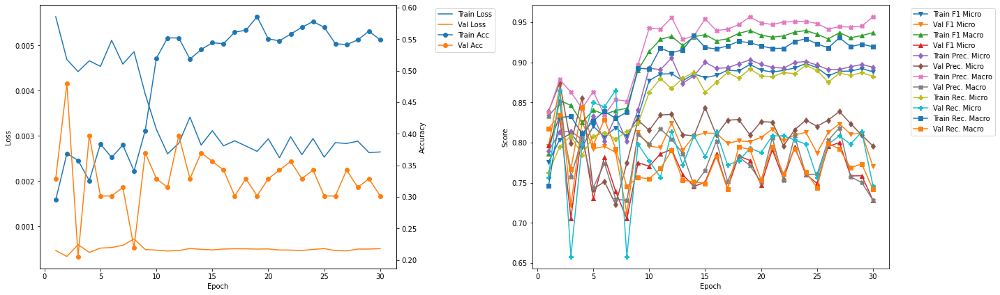

-------------------------------------------
FOLD 7
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 32.18
Train Loss: 0.0058 	Validation Loss: 0.0003
Train Accuracy: 0.2565 	Validation Accuracy: 0.5139
Train F1 Mirco: 0.752 	Validation F1 Micro: 0.8696
Train F1 Marco: 0.7823 	Validation F1 Macro: 0.7966
Train Precision Mirco: 0.7738 	Validation Precision Micro: 0.9036
Train Precision Marco: 0.8367 	Validation Precision Macro: 0.8126
Train Recall Mirco: 0.7313 	Validation Recall Micro: 0.838
Train Recall Marco: 0.7383 	Validation Recall Macro: 0.8053

Epoch 2 	Learning Rate: 0.01 	Time (min): 32.33
Train Loss: 0.0047 	Validation Loss: 0.0003
Train Accuracy: 0.3649 	Validation Accuracy: 0.5972
Train F1 Mirco: 0.8162 	Validation F1 Micro: 0.8919
Train F1 Marco: 0.8338 	Validation F1 Macro: 0.7779
Train Precision Mirco: 0.8213 	Validation Precision Micro: 0.8639
Train Precision Marco: 0.8441 	Validation Precision Macro: 0.7773
Train Recall Mirco: 0.8111

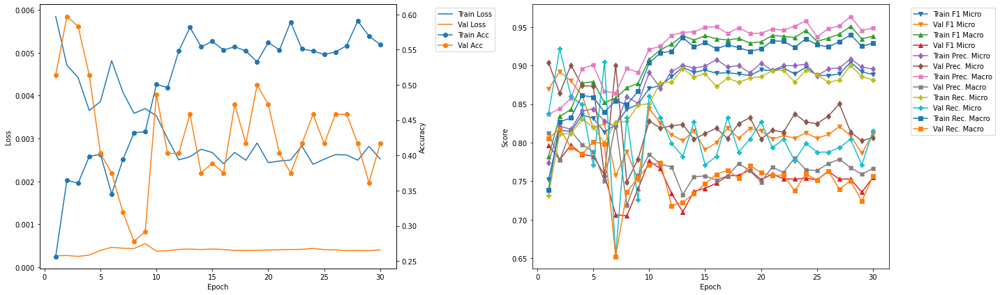

-------------------------------------------
FOLD 8
-------------------------------------------
Validation F1 Micro Score Increased (0.912568 --> 0.921053).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 36.75
Train Loss: 0.005 	Validation Loss: 0.0002
Train Accuracy: 0.3511 	Validation Accuracy: 0.6667
Train F1 Mirco: 0.7891 	Validation F1 Micro: 0.9211
Train F1 Marco: 0.8396 	Validation F1 Macro: 0.8696
Train Precision Mirco: 0.8081 	Validation Precision Micro: 0.8883
Train Precision Marco: 0.8659 	Validation Precision Macro: 0.8659
Train Recall Mirco: 0.771 	Validation Recall Micro: 0.9563
Train Recall Marco: 0.8163 	Validation Recall Macro: 0.8838

Validation F1 Micro Score Increased (0.921053 --> 0.928177).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 36.9
Train Loss: 0.0038 	Validation Loss: 0.0002
Train Accuracy: 0.3847 	Validation Accuracy: 0.6944
Train F1 Mirco: 0.8275 	Validation F1 Micro: 0.9282
Train F1 Marco: 0.8821 	Validation F1 Macro: 0.8766

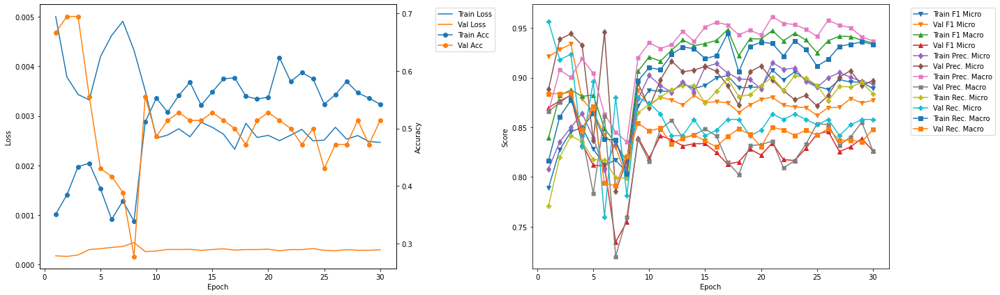

-------------------------------------------
FOLD 9
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 41.34
Train Loss: 0.0053 	Validation Loss: 0.0002
Train Accuracy: 0.3099 	Validation Accuracy: 0.6667
Train F1 Mirco: 0.7897 	Validation F1 Micro: 0.9299
Train F1 Marco: 0.8431 	Validation F1 Macro: 0.8272
Train Precision Mirco: 0.7971 	Validation Precision Micro: 0.9421
Train Precision Marco: 0.8633 	Validation Precision Macro: 0.8411
Train Recall Mirco: 0.7825 	Validation Recall Micro: 0.9179
Train Recall Marco: 0.8258 	Validation Recall Macro: 0.8237

Epoch 2 	Learning Rate: 0.01 	Time (min): 41.5
Train Loss: 0.0033 	Validation Loss: 0.0002
Train Accuracy: 0.4489 	Validation Accuracy: 0.6528
Train F1 Mirco: 0.8455 	Validation F1 Micro: 0.9146
Train F1 Marco: 0.8808 	Validation F1 Macro: 0.8183
Train Precision Mirco: 0.8605 	Validation Precision Micro: 0.8966
Train Precision Marco: 0.8973 	Validation Precision Macro: 0.8109
Train Recall Mirco: 0.831

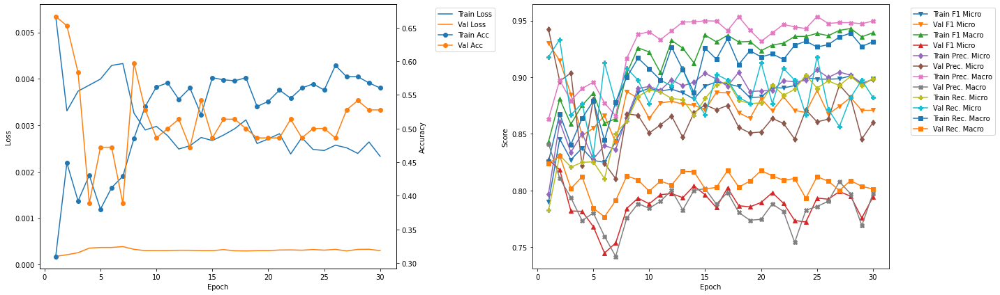

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 8 	Epoch: 3
Train Loss: 0.0034 	Validation Loss: 0.0002
Train Accuracy: 0.4336 	Validation Accuracy: 0.6944
Train F1 Mirco: 0.8456 	Validation F1 Micro: 0.9337
Train F1 Marco: 0.8876 	Validation F1 Macro: 0.882
Train Precision Mirco: 0.8499 	Validation Precision Micro: 0.9441
Train Precision Marco: 0.9003 	Validation Precision Macro: 0.8828
Train Recall Mirco: 0.8413 	Validation Recall Micro: 0.9235
Train Recall Marco: 0.8771 	Validation Recall Macro: 0.8852


In [74]:
Kfold_train_CNN(model = densenet169, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'densenet169')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.484150).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.16
Train Loss: 0.0181 	Validation Loss: 0.0015
Train Accuracy: 0.0505 	Validation Accuracy: 0.0685
Train F1 Mirco: 0.409 	Validation F1 Micro: 0.4841
Train F1 Marco: 0.1084 	Validation F1 Macro: 0.0764
Train Precision Mirco: 0.4425 	Validation Precision Micro: 0.5283
Train Precision Marco: 0.1175 	Validation Precision Macro: 0.0666
Train Recall Mirco: 0.3803 	Validation Recall Micro: 0.4468
Train Recall Marco: 0.1049 	Validation Recall Macro: 0.1065

Validation F1 Micro Score Increased (0.484150 --> 0.491803).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.33
Train Loss: 0.0111 	Validation Loss: 0.0013
Train Accuracy: 0.0963 	Validation Accuracy: 0.0548
Train F1 Mirco: 0.5054 	Validation F1 Micro: 0.4918
Train F1 Marco: 0.1517 	Validation F1 Macro: 0.1151

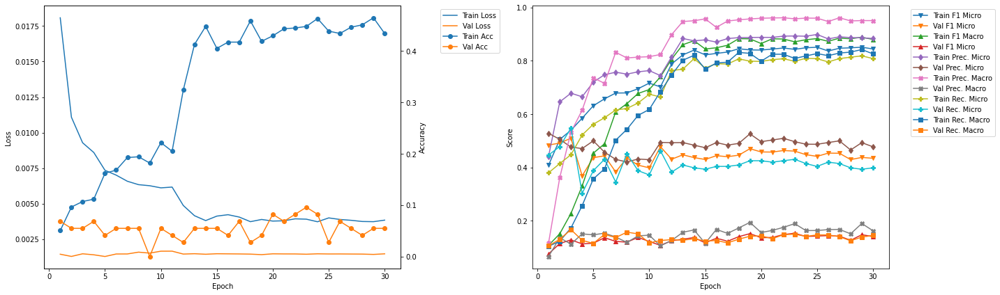

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.509901 --> 0.785366).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 5.02
Train Loss: 0.0093 	Validation Loss: 0.0005
Train Accuracy: 0.1437 	Validation Accuracy: 0.3151
Train F1 Mirco: 0.6257 	Validation F1 Micro: 0.7854
Train F1 Marco: 0.5359 	Validation F1 Macro: 0.6729
Train Precision Mirco: 0.6671 	Validation Precision Micro: 0.7385
Train Precision Marco: 0.6381 	Validation Precision Macro: 0.7227
Train Recall Mirco: 0.5892 	Validation Recall Micro: 0.8385
Train Recall Marco: 0.471 	Validation Recall Macro: 0.6911

Epoch 2 	Learning Rate: 0.01 	Time (min): 5.18
Train Loss: 0.006 	Validation Loss: 0.0006
Train Accuracy: 0.2401 	Validation Accuracy: 0.2877
Train F1 Mirco: 0.7247 	Validation F1 Micro: 0.7229
Train F1 Marco: 0.6595 	Validation F1 Macro: 0.5882
Train Precision Mirco: 0.7603 	Validation Precision Micro: 0.8571
Train Precisio

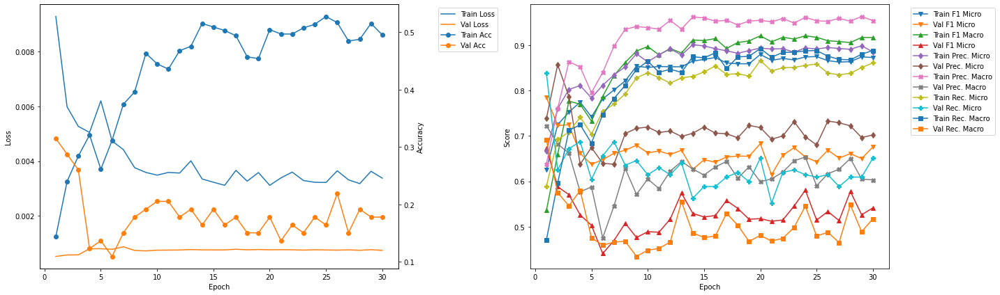

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.785366 --> 0.822581).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 9.87
Train Loss: 0.0077 	Validation Loss: 0.0004
Train Accuracy: 0.2034 	Validation Accuracy: 0.3973
Train F1 Mirco: 0.6905 	Validation F1 Micro: 0.8226
Train F1 Marco: 0.6277 	Validation F1 Macro: 0.6501
Train Precision Mirco: 0.7182 	Validation Precision Micro: 0.827
Train Precision Marco: 0.7272 	Validation Precision Macro: 0.6996
Train Recall Mirco: 0.6648 	Validation Recall Micro: 0.8182
Train Recall Marco: 0.5676 	Validation Recall Macro: 0.691

Validation F1 Micro Score Increased (0.822581 --> 0.837696).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 10.03
Train Loss: 0.005 	Validation Loss: 0.0004
Train Accuracy: 0.3119 	Validation Accuracy: 0.4521
Train F1 Mirco: 0.7746 	Validation F1 Micro: 0.8377
Train F1 Marco: 0.7688 	Validation F1 Macro: 0.6236


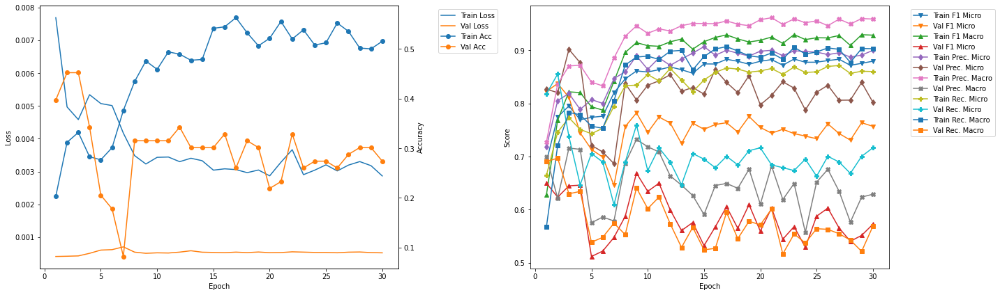

-------------------------------------------
FOLD 3
-------------------------------------------
Validation F1 Micro Score Increased (0.837696 --> 0.860892).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 14.73
Train Loss: 0.0063 	Validation Loss: 0.0003
Train Accuracy: 0.182 	Validation Accuracy: 0.411
Train F1 Mirco: 0.7203 	Validation F1 Micro: 0.8609
Train F1 Marco: 0.7107 	Validation F1 Macro: 0.831
Train Precision Mirco: 0.7466 	Validation Precision Micro: 0.8542
Train Precision Marco: 0.8174 	Validation Precision Macro: 0.8564
Train Recall Mirco: 0.6957 	Validation Recall Micro: 0.8677
Train Recall Marco: 0.6388 	Validation Recall Macro: 0.8298

Epoch 2 	Learning Rate: 0.01 	Time (min): 14.89
Train Loss: 0.0043 	Validation Loss: 0.0004
Train Accuracy: 0.3486 	Validation Accuracy: 0.4384
Train F1 Mirco: 0.8069 	Validation F1 Micro: 0.8375
Train F1 Marco: 0.8526 	Validation F1 Macro: 0.7858
Train Precision Mirco: 0.8256 	Validation Precision Micro: 0.8736
Train Precisi

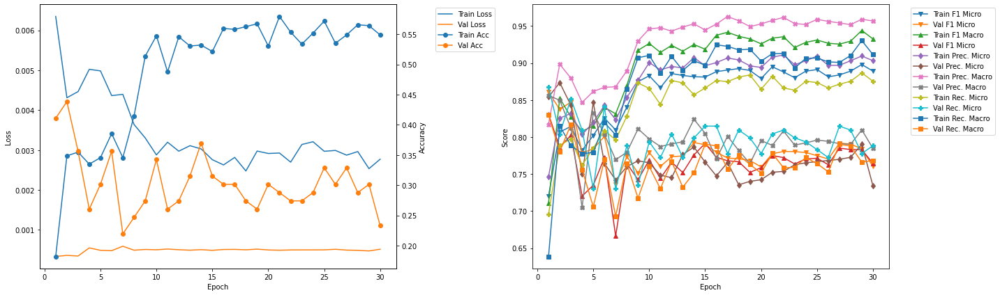

-------------------------------------------
FOLD 4
-------------------------------------------
Validation F1 Micro Score Increased (0.860892 --> 0.905660).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 19.59
Train Loss: 0.0064 	Validation Loss: 0.0003
Train Accuracy: 0.2385 	Validation Accuracy: 0.5753
Train F1 Mirco: 0.7314 	Validation F1 Micro: 0.9057
Train F1 Marco: 0.7222 	Validation F1 Macro: 0.8331
Train Precision Mirco: 0.7555 	Validation Precision Micro: 0.8533
Train Precision Marco: 0.787 	Validation Precision Macro: 0.816
Train Recall Mirco: 0.7088 	Validation Recall Micro: 0.9648
Train Recall Marco: 0.6748 	Validation Recall Macro: 0.8736

Epoch 2 	Learning Rate: 0.01 	Time (min): 19.75
Train Loss: 0.0046 	Validation Loss: 0.0004
Train Accuracy: 0.3211 	Validation Accuracy: 0.3973
Train F1 Mirco: 0.7938 	Validation F1 Micro: 0.8416
Train F1 Marco: 0.8384 	Validation F1 Macro: 0.8087
Train Precision Mirco: 0.8096 	Validation Precision Micro: 0.8293
Train Precis

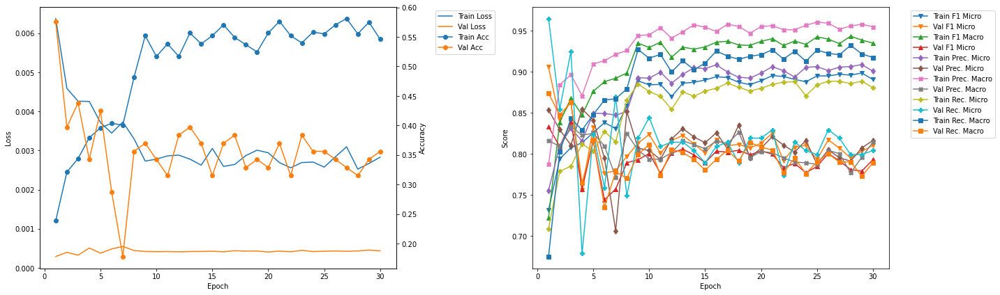

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 24.44
Train Loss: 0.0059 	Validation Loss: 0.0003
Train Accuracy: 0.2554 	Validation Accuracy: 0.5342
Train F1 Mirco: 0.7555 	Validation F1 Micro: 0.8873
Train F1 Marco: 0.7939 	Validation F1 Macro: 0.8004
Train Precision Mirco: 0.7867 	Validation Precision Micro: 0.8832
Train Precision Marco: 0.8648 	Validation Precision Macro: 0.8023
Train Recall Mirco: 0.7268 	Validation Recall Micro: 0.8915
Train Recall Marco: 0.7413 	Validation Recall Macro: 0.8175

Epoch 2 	Learning Rate: 0.01 	Time (min): 24.6
Train Loss: 0.0043 	Validation Loss: 0.0004
Train Accuracy: 0.3394 	Validation Accuracy: 0.3562
Train F1 Mirco: 0.8073 	Validation F1 Micro: 0.8493
Train F1 Marco: 0.8116 	Validation F1 Macro: 0.7419
Train Precision Mirco: 0.8195 	Validation Precision Micro: 0.823
Train Precision Marco: 0.8323 	Validation Precision Macro: 0.744
Train Recall Mirco: 0.7954 

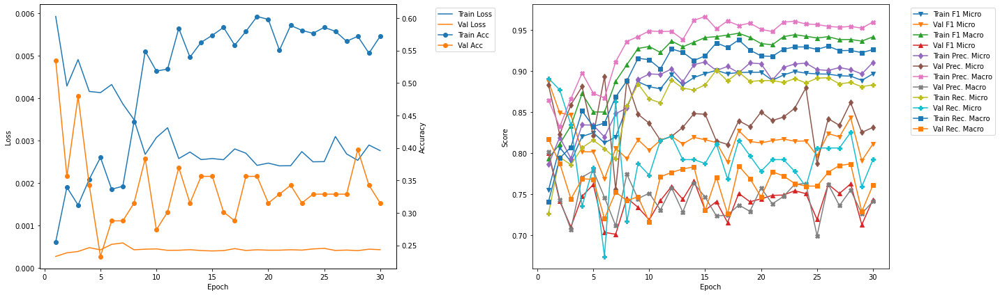

-------------------------------------------
FOLD 6
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 29.33
Train Loss: 0.0059 	Validation Loss: 0.0003
Train Accuracy: 0.3257 	Validation Accuracy: 0.6027
Train F1 Mirco: 0.7868 	Validation F1 Micro: 0.893
Train F1 Marco: 0.7624 	Validation F1 Macro: 0.8036
Train Precision Mirco: 0.8061 	Validation Precision Micro: 0.9048
Train Precision Marco: 0.821 	Validation Precision Macro: 0.8087
Train Recall Mirco: 0.7684 	Validation Recall Micro: 0.8814
Train Recall Marco: 0.7163 	Validation Recall Macro: 0.8208

Epoch 2 	Learning Rate: 0.01 	Time (min): 29.5
Train Loss: 0.0044 	Validation Loss: 0.0004
Train Accuracy: 0.3609 	Validation Accuracy: 0.4247
Train F1 Mirco: 0.8189 	Validation F1 Micro: 0.855
Train F1 Marco: 0.8555 	Validation F1 Macro: 0.7779
Train Precision Mirco: 0.8334 	Validation Precision Micro: 0.8301
Train Precision Marco: 0.8627 	Validation Precision Macro: 0.7565
Train Recall Mirco: 0.8049 	

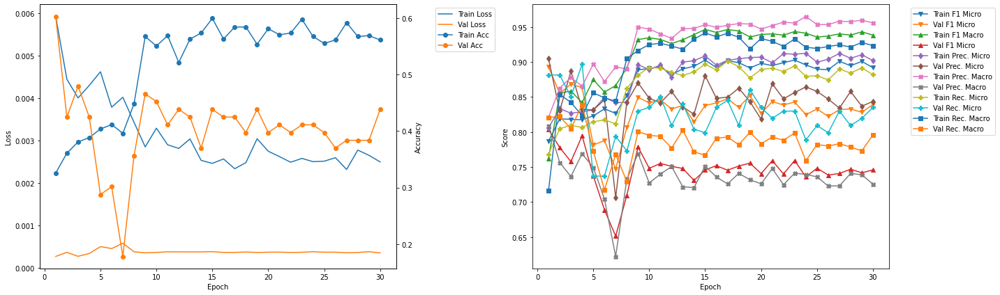

-------------------------------------------
FOLD 7
-------------------------------------------
Validation F1 Micro Score Increased (0.905660 --> 0.925000).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 34.18
Train Loss: 0.0045 	Validation Loss: 0.0002
Train Accuracy: 0.3344 	Validation Accuracy: 0.6389
Train F1 Mirco: 0.7977 	Validation F1 Micro: 0.925
Train F1 Marco: 0.8526 	Validation F1 Macro: 0.9094
Train Precision Mirco: 0.8175 	Validation Precision Micro: 0.8937
Train Precision Marco: 0.8854 	Validation Precision Macro: 0.8979
Train Recall Mirco: 0.7788 	Validation Recall Micro: 0.9585
Train Recall Marco: 0.8244 	Validation Recall Macro: 0.9298

Epoch 2 	Learning Rate: 0.01 	Time (min): 34.34
Train Loss: 0.004 	Validation Loss: 0.0003
Train Accuracy: 0.4076 	Validation Accuracy: 0.5278
Train F1 Mirco: 0.8397 	Validation F1 Micro: 0.8937
Train F1 Marco: 0.861 	Validation F1 Macro: 0.8931
Train Precision Mirco: 0.8508 	Validation Precision Micro: 0.8371
Train Precisi

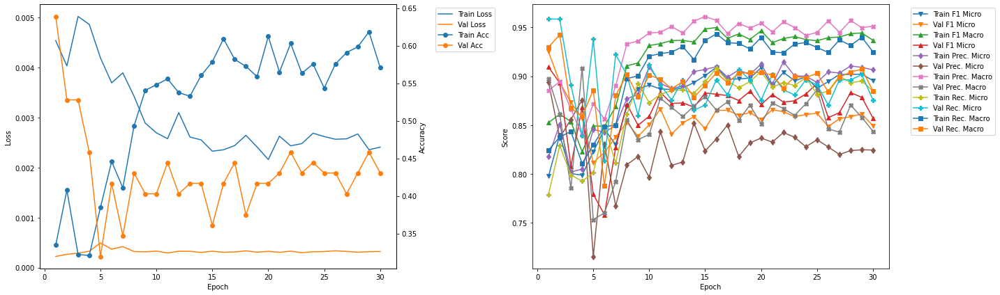

-------------------------------------------
FOLD 8
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 39.14
Train Loss: 0.0052 	Validation Loss: 0.0003
Train Accuracy: 0.3237 	Validation Accuracy: 0.5139
Train F1 Mirco: 0.7891 	Validation F1 Micro: 0.8784
Train F1 Marco: 0.7971 	Validation F1 Macro: 0.7139
Train Precision Mirco: 0.808 	Validation Precision Micro: 0.8719
Train Precision Marco: 0.8341 	Validation Precision Macro: 0.7056
Train Recall Mirco: 0.771 	Validation Recall Micro: 0.885
Train Recall Marco: 0.7663 	Validation Recall Macro: 0.7377

Epoch 2 	Learning Rate: 0.01 	Time (min): 39.3
Train Loss: 0.0043 	Validation Loss: 0.0003
Train Accuracy: 0.3908 	Validation Accuracy: 0.4167
Train F1 Mirco: 0.8267 	Validation F1 Micro: 0.8492
Train F1 Marco: 0.8552 	Validation F1 Macro: 0.7079
Train Precision Mirco: 0.8303 	Validation Precision Micro: 0.962
Train Precision Marco: 0.8624 	Validation Precision Macro: 0.7395
Train Recall Mirco: 0.8231 	V

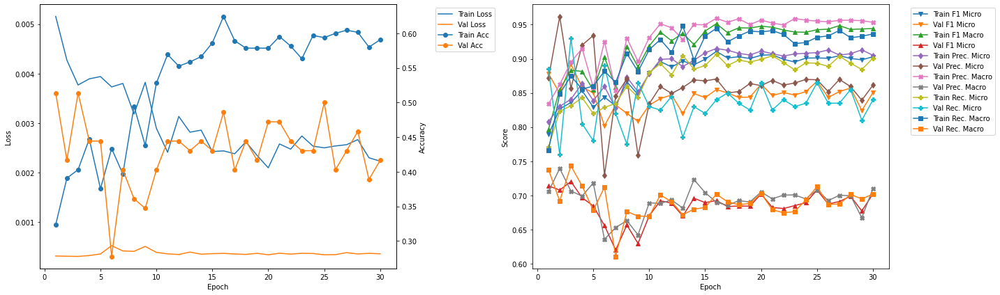

-------------------------------------------
FOLD 9
-------------------------------------------
Validation F1 Micro Score Increased (0.925000 --> 0.928934).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 44.05
Train Loss: 0.0056 	Validation Loss: 0.0002
Train Accuracy: 0.3344 	Validation Accuracy: 0.6528
Train F1 Mirco: 0.7818 	Validation F1 Micro: 0.9289
Train F1 Marco: 0.8418 	Validation F1 Macro: 0.8765
Train Precision Mirco: 0.7918 	Validation Precision Micro: 0.9104
Train Precision Marco: 0.8703 	Validation Precision Macro: 0.8631
Train Recall Mirco: 0.7719 	Validation Recall Micro: 0.9482
Train Recall Marco: 0.8175 	Validation Recall Macro: 0.8989

Epoch 2 	Learning Rate: 0.01 	Time (min): 44.21
Train Loss: 0.0037 	Validation Loss: 0.0002
Train Accuracy: 0.4534 	Validation Accuracy: 0.6806
Train F1 Mirco: 0.8491 	Validation F1 Micro: 0.9263
Train F1 Marco: 0.8526 	Validation F1 Macro: 0.8539
Train Precision Mirco: 0.858 	Validation Precision Micro: 0.9412
Train Preci

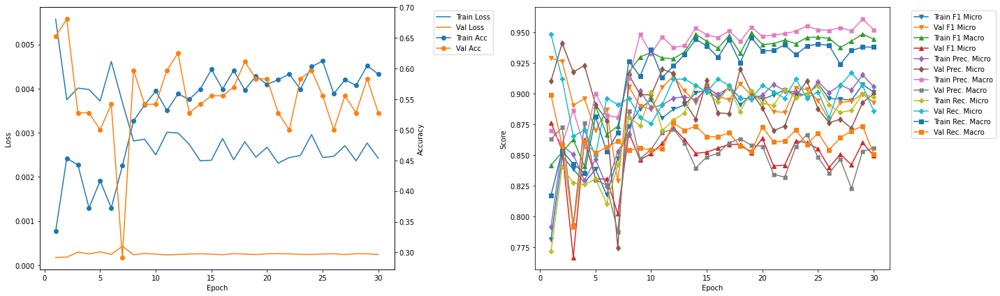

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 1
Train Loss: 0.0056 	Validation Loss: 0.0002
Train Accuracy: 0.3344 	Validation Accuracy: 0.6528
Train F1 Mirco: 0.7818 	Validation F1 Micro: 0.9289
Train F1 Marco: 0.8418 	Validation F1 Macro: 0.8765
Train Precision Mirco: 0.7918 	Validation Precision Micro: 0.9104
Train Precision Marco: 0.8703 	Validation Precision Macro: 0.8631
Train Recall Mirco: 0.7719 	Validation Recall Micro: 0.9482
Train Recall Marco: 0.8175 	Validation Recall Macro: 0.8989


In [75]:
Kfold_train_CNN(model = densenet201, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'densenet201')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.356941).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.2
Train Loss: 0.0266 	Validation Loss: 0.0022
Train Accuracy: 0.0321 	Validation Accuracy: 0.0274
Train F1 Mirco: 0.4028 	Validation F1 Micro: 0.3569
Train F1 Marco: 0.1334 	Validation F1 Macro: 0.1114
Train Precision Mirco: 0.4129 	Validation Precision Micro: 0.4118
Train Precision Marco: 0.1389 	Validation Precision Macro: 0.1592
Train Recall Mirco: 0.3932 	Validation Recall Micro: 0.315
Train Recall Marco: 0.1298 	Validation Recall Macro: 0.1303

Validation F1 Micro Score Increased (0.356941 --> 0.504808).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.41
Train Loss: 0.0175 	Validation Loss: 0.0019
Train Accuracy: 0.0749 	Validation Accuracy: 0.0
Train F1 Mirco: 0.4864 	Validation F1 Micro: 0.5048
Train F1 Marco: 0.2184 	Validation F1 Macro: 0.138
Trai

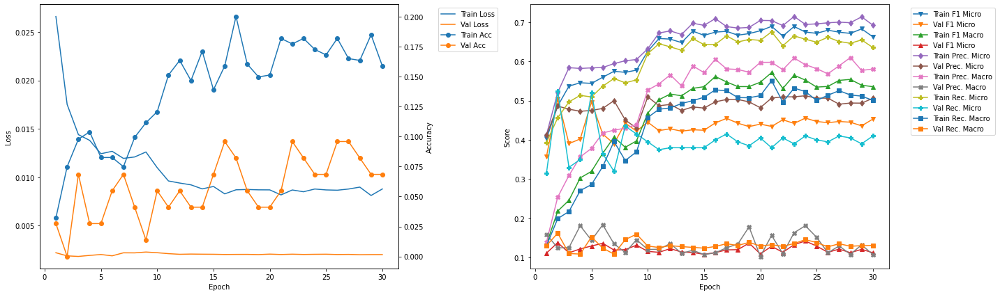

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.504808 --> 0.652941).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 5.78
Train Loss: 0.016 	Validation Loss: 0.0011
Train Accuracy: 0.0963 	Validation Accuracy: 0.1918
Train F1 Mirco: 0.5452 	Validation F1 Micro: 0.6529
Train F1 Marco: 0.3414 	Validation F1 Macro: 0.4622
Train Precision Mirco: 0.5619 	Validation Precision Micro: 0.8284
Train Precision Marco: 0.3717 	Validation Precision Macro: 0.6779
Train Recall Mirco: 0.5296 	Validation Recall Micro: 0.5388
Train Recall Marco: 0.3187 	Validation Recall Macro: 0.4015

Epoch 2 	Learning Rate: 0.01 	Time (min): 5.96
Train Loss: 0.0131 	Validation Loss: 0.0012
Train Accuracy: 0.0933 	Validation Accuracy: 0.1096
Train F1 Mirco: 0.5958 	Validation F1 Micro: 0.6389
Train F1 Marco: 0.4258 	Validation F1 Macro: 0.4446
Train Precision Mirco: 0.613 	Validation Precision Micro: 0.7468
Train Precisio

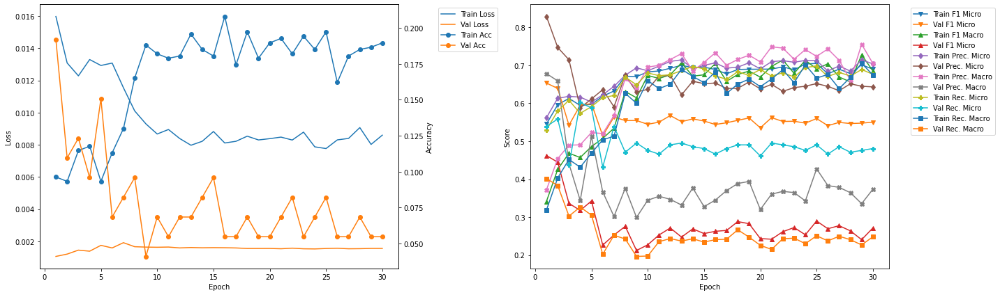

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.652941 --> 0.747368).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 11.33
Train Loss: 0.0152 	Validation Loss: 0.0007
Train Accuracy: 0.1009 	Validation Accuracy: 0.2466
Train F1 Mirco: 0.6012 	Validation F1 Micro: 0.7474
Train F1 Marco: 0.4597 	Validation F1 Macro: 0.56
Train Precision Mirco: 0.6153 	Validation Precision Micro: 0.732
Train Precision Marco: 0.5126 	Validation Precision Macro: 0.6412
Train Recall Mirco: 0.5877 	Validation Recall Micro: 0.7634
Train Recall Marco: 0.4326 	Validation Recall Macro: 0.5566

Epoch 2 	Learning Rate: 0.01 	Time (min): 11.51
Train Loss: 0.0122 	Validation Loss: 0.0007
Train Accuracy: 0.1208 	Validation Accuracy: 0.2603
Train F1 Mirco: 0.6363 	Validation F1 Micro: 0.7169
Train F1 Marco: 0.5727 	Validation F1 Macro: 0.5768
Train Precision Mirco: 0.6424 	Validation Precision Micro: 0.8151
Train Precisi

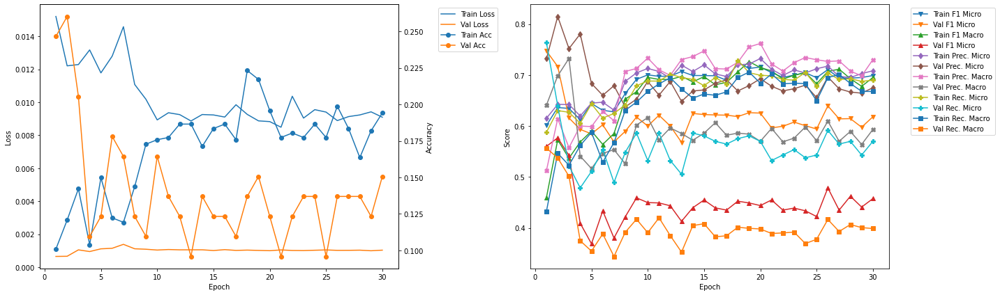

-------------------------------------------
FOLD 3
-------------------------------------------
Validation F1 Micro Score Increased (0.747368 --> 0.810945).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 16.88
Train Loss: 0.015 	Validation Loss: 0.0005
Train Accuracy: 0.1055 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.6022 	Validation F1 Micro: 0.8109
Train F1 Marco: 0.5396 	Validation F1 Macro: 0.6188
Train Precision Mirco: 0.6129 	Validation Precision Micro: 0.7874
Train Precision Marco: 0.6036 	Validation Precision Macro: 0.6903
Train Recall Mirco: 0.5919 	Validation Recall Micro: 0.8359
Train Recall Marco: 0.5054 	Validation Recall Macro: 0.6124

Epoch 2 	Learning Rate: 0.01 	Time (min): 17.06
Train Loss: 0.0139 	Validation Loss: 0.0006
Train Accuracy: 0.1361 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.6341 	Validation F1 Micro: 0.807
Train F1 Marco: 0.5936 	Validation F1 Macro: 0.6014
Train Precision Mirco: 0.6417 	Validation Precision Micro: 0.7892
Train Precis

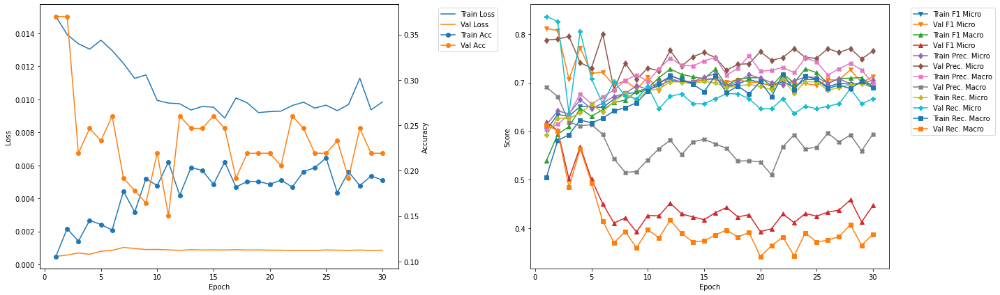

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 22.41
Train Loss: 0.014 	Validation Loss: 0.0004
Train Accuracy: 0.1376 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.6276 	Validation F1 Micro: 0.8086
Train F1 Marco: 0.6106 	Validation F1 Macro: 0.7171
Train Precision Mirco: 0.6351 	Validation Precision Micro: 0.8571
Train Precision Marco: 0.6527 	Validation Precision Macro: 0.7608
Train Recall Mirco: 0.6202 	Validation Recall Micro: 0.7653
Train Recall Marco: 0.5868 	Validation Recall Macro: 0.7298

Epoch 2 	Learning Rate: 0.01 	Time (min): 22.59
Train Loss: 0.0133 	Validation Loss: 0.0005
Train Accuracy: 0.1254 	Validation Accuracy: 0.2055
Train F1 Mirco: 0.6528 	Validation F1 Micro: 0.7936
Train F1 Marco: 0.6379 	Validation F1 Macro: 0.7227
Train Precision Mirco: 0.661 	Validation Precision Micro: 0.8362
Train Precision Marco: 0.6698 	Validation Precision Macro: 0.7601
Train Recall Mirco: 0.6448

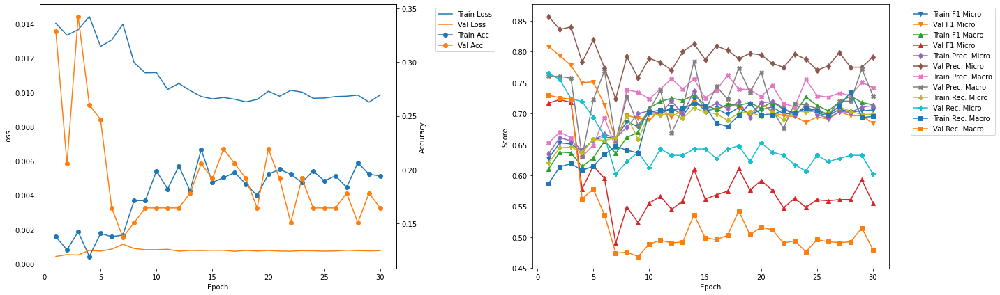

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 27.94
Train Loss: 0.015 	Validation Loss: 0.0005
Train Accuracy: 0.1315 	Validation Accuracy: 0.3014
Train F1 Mirco: 0.6386 	Validation F1 Micro: 0.8041
Train F1 Marco: 0.6066 	Validation F1 Macro: 0.762
Train Precision Mirco: 0.6517 	Validation Precision Micro: 0.75
Train Precision Marco: 0.65 	Validation Precision Macro: 0.8071
Train Recall Mirco: 0.6259 	Validation Recall Micro: 0.8667
Train Recall Marco: 0.5755 	Validation Recall Macro: 0.7651

Epoch 2 	Learning Rate: 0.01 	Time (min): 28.13
Train Loss: 0.013 	Validation Loss: 0.0006
Train Accuracy: 0.1391 	Validation Accuracy: 0.274
Train F1 Mirco: 0.6593 	Validation F1 Micro: 0.7526
Train F1 Marco: 0.6363 	Validation F1 Macro: 0.6845
Train Precision Mirco: 0.6632 	Validation Precision Micro: 0.715
Train Precision Marco: 0.6612 	Validation Precision Macro: 0.7467
Train Recall Mirco: 0.6553 	Valid

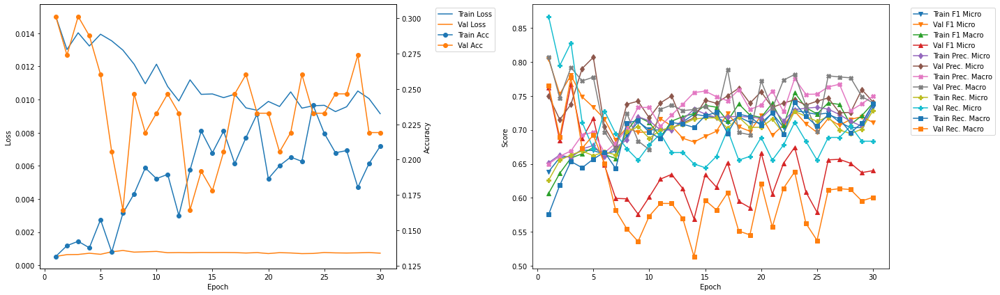

-------------------------------------------
FOLD 6
-------------------------------------------
Validation F1 Micro Score Increased (0.810945 --> 0.828125).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 33.49
Train Loss: 0.016 	Validation Loss: 0.0004
Train Accuracy: 0.1437 	Validation Accuracy: 0.3151
Train F1 Mirco: 0.6391 	Validation F1 Micro: 0.8281
Train F1 Marco: 0.6107 	Validation F1 Macro: 0.7015
Train Precision Mirco: 0.6466 	Validation Precision Micro: 0.8548
Train Precision Marco: 0.6295 	Validation Precision Macro: 0.756
Train Recall Mirco: 0.6318 	Validation Recall Micro: 0.803
Train Recall Marco: 0.5975 	Validation Recall Macro: 0.6848

Epoch 2 	Learning Rate: 0.01 	Time (min): 33.68
Train Loss: 0.0137 	Validation Loss: 0.0006
Train Accuracy: 0.1682 	Validation Accuracy: 0.3014
Train F1 Mirco: 0.6739 	Validation F1 Micro: 0.776
Train F1 Marco: 0.6583 	Validation F1 Macro: 0.6537
Train Precision Mirco: 0.6767 	Validation Precision Micro: 0.8011
Train Precisio

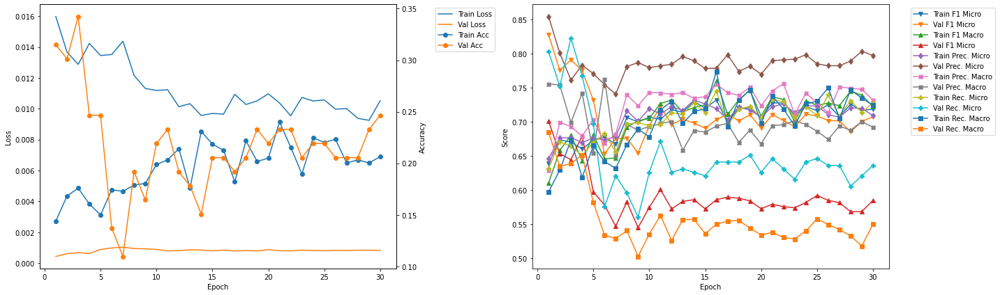

-------------------------------------------
FOLD 7
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 39.02
Train Loss: 0.0135 	Validation Loss: 0.0006
Train Accuracy: 0.1634 	Validation Accuracy: 0.2778
Train F1 Mirco: 0.6684 	Validation F1 Micro: 0.7903
Train F1 Marco: 0.6572 	Validation F1 Macro: 0.7853
Train Precision Mirco: 0.6752 	Validation Precision Micro: 0.8698
Train Precision Marco: 0.6906 	Validation Precision Macro: 0.8722
Train Recall Mirco: 0.6617 	Validation Recall Micro: 0.7241
Train Recall Marco: 0.6345 	Validation Recall Macro: 0.7488

Validation F1 Micro Score Increased (0.828125 --> 0.843990).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 39.23
Train Loss: 0.0143 	Validation Loss: 0.0004
Train Accuracy: 0.145 	Validation Accuracy: 0.3889
Train F1 Mirco: 0.6536 	Validation F1 Micro: 0.844
Train F1 Marco: 0.6646 	Validation F1 Macro: 0.7712
Train Precision Mirco: 0.6587 	Validation Precision Micro: 0.8777
Train Precis

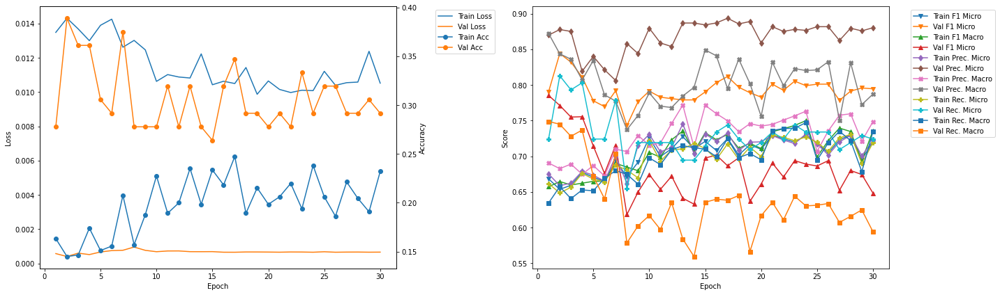

-------------------------------------------
FOLD 8
-------------------------------------------
Validation F1 Micro Score Increased (0.843990 --> 0.905028).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 44.59
Train Loss: 0.0163 	Validation Loss: 0.0003
Train Accuracy: 0.1389 	Validation Accuracy: 0.5833
Train F1 Mirco: 0.6529 	Validation F1 Micro: 0.905
Train F1 Marco: 0.5893 	Validation F1 Macro: 0.9281
Train Precision Mirco: 0.6589 	Validation Precision Micro: 0.9529
Train Precision Marco: 0.6095 	Validation Precision Macro: 0.9878
Train Recall Mirco: 0.647 	Validation Recall Micro: 0.8617
Train Recall Marco: 0.5733 	Validation Recall Macro: 0.8928

Epoch 2 	Learning Rate: 0.01 	Time (min): 44.78
Train Loss: 0.0146 	Validation Loss: 0.0003
Train Accuracy: 0.1634 	Validation Accuracy: 0.5
Train F1 Mirco: 0.6714 	Validation F1 Micro: 0.875
Train F1 Marco: 0.6261 	Validation F1 Macro: 0.9164
Train Precision Mirco: 0.6731 	Validation Precision Micro: 0.8571
Train Precision 

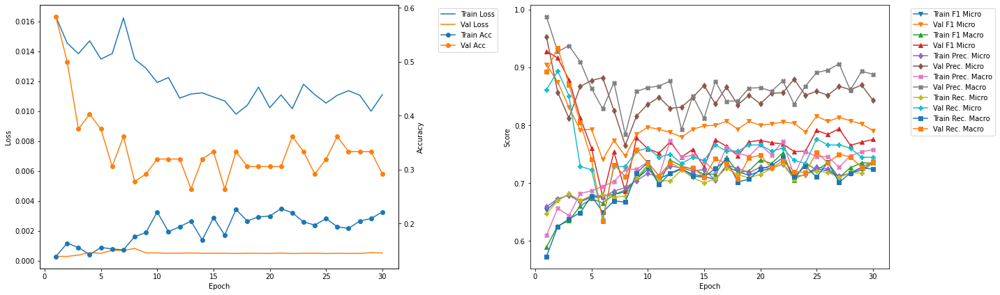

-------------------------------------------
FOLD 9
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 50.12
Train Loss: 0.0156 	Validation Loss: 0.0003
Train Accuracy: 0.1298 	Validation Accuracy: 0.4583
Train F1 Mirco: 0.6521 	Validation F1 Micro: 0.8743
Train F1 Marco: 0.6591 	Validation F1 Macro: 0.749
Train Precision Mirco: 0.6548 	Validation Precision Micro: 0.893
Train Precision Marco: 0.6885 	Validation Precision Macro: 0.7533
Train Recall Mirco: 0.6495 	Validation Recall Micro: 0.8564
Train Recall Marco: 0.6373 	Validation Recall Macro: 0.7608

Epoch 2 	Learning Rate: 0.01 	Time (min): 50.31
Train Loss: 0.0143 	Validation Loss: 0.0004
Train Accuracy: 0.1649 	Validation Accuracy: 0.4444
Train F1 Mirco: 0.6746 	Validation F1 Micro: 0.8665
Train F1 Marco: 0.6738 	Validation F1 Macro: 0.7414
Train Precision Mirco: 0.6908 	Validation Precision Micro: 0.8515
Train Precision Marco: 0.7014 	Validation Precision Macro: 0.8026
Train Recall Mirco: 0.6592

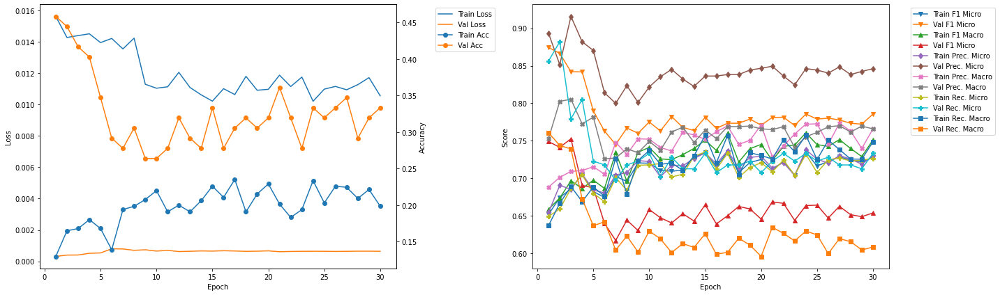

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 8 	Epoch: 1
Train Loss: 0.0163 	Validation Loss: 0.0003
Train Accuracy: 0.1389 	Validation Accuracy: 0.5833
Train F1 Mirco: 0.6529 	Validation F1 Micro: 0.905
Train F1 Marco: 0.5893 	Validation F1 Macro: 0.9281
Train Precision Mirco: 0.6589 	Validation Precision Micro: 0.9529
Train Precision Marco: 0.6095 	Validation Precision Macro: 0.9878
Train Recall Mirco: 0.647 	Validation Recall Micro: 0.8617
Train Recall Marco: 0.5733 	Validation Recall Macro: 0.8928


In [76]:
Kfold_train_CNN(model = vgg11bn, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'vgg11bn')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.458101).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.22
Train Loss: 0.0285 	Validation Loss: 0.0026
Train Accuracy: 0.0428 	Validation Accuracy: 0.0274
Train F1 Mirco: 0.3944 	Validation F1 Micro: 0.4581
Train F1 Marco: 0.1202 	Validation F1 Macro: 0.0771
Train Precision Mirco: 0.4066 	Validation Precision Micro: 0.5467
Train Precision Marco: 0.1281 	Validation Precision Macro: 0.0671
Train Recall Mirco: 0.383 	Validation Recall Micro: 0.3942
Train Recall Marco: 0.1158 	Validation Recall Macro: 0.093

Validation F1 Micro Score Increased (0.458101 --> 0.477454).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.44
Train Loss: 0.0206 	Validation Loss: 0.0022
Train Accuracy: 0.0734 	Validation Accuracy: 0.0411
Train F1 Mirco: 0.4822 	Validation F1 Micro: 0.4775
Train F1 Marco: 0.1921 	Validation F1 Macro: 0.0924


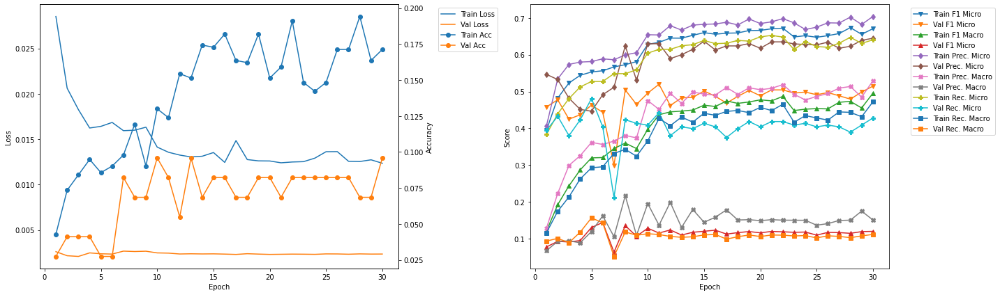

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.519774 --> 0.698734).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 6.27
Train Loss: 0.0185 	Validation Loss: 0.0012
Train Accuracy: 0.1055 	Validation Accuracy: 0.1781
Train F1 Mirco: 0.5546 	Validation F1 Micro: 0.6987
Train F1 Marco: 0.322 	Validation F1 Macro: 0.4575
Train Precision Mirco: 0.5812 	Validation Precision Micro: 0.7041
Train Precision Marco: 0.3469 	Validation Precision Macro: 0.5952
Train Recall Mirco: 0.5303 	Validation Recall Micro: 0.6935
Train Recall Marco: 0.3021 	Validation Recall Macro: 0.4353

Epoch 2 	Learning Rate: 0.01 	Time (min): 6.47
Train Loss: 0.016 	Validation Loss: 0.001
Train Accuracy: 0.0994 	Validation Accuracy: 0.1233
Train F1 Mirco: 0.5903 	Validation F1 Micro: 0.639
Train F1 Marco: 0.3643 	Validation F1 Macro: 0.3489
Train Precision Mirco: 0.6098 	Validation Precision Micro: 0.6613
Train Precision 

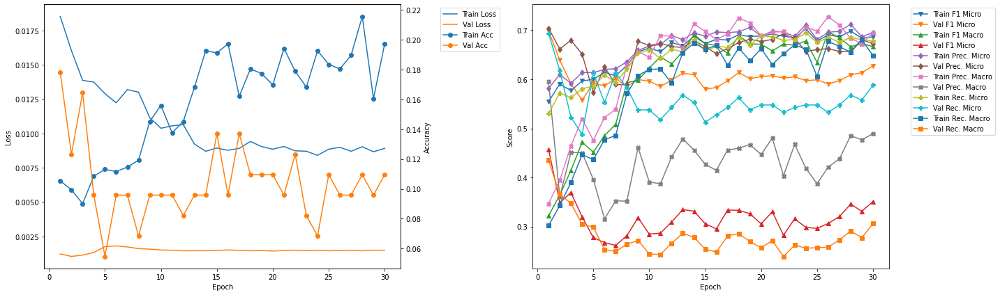

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.698734 --> 0.775281).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 12.23
Train Loss: 0.0166 	Validation Loss: 0.0005
Train Accuracy: 0.1024 	Validation Accuracy: 0.3014
Train F1 Mirco: 0.5936 	Validation F1 Micro: 0.7753
Train F1 Marco: 0.4877 	Validation F1 Macro: 0.6182
Train Precision Mirco: 0.6078 	Validation Precision Micro: 0.8415
Train Precision Marco: 0.5564 	Validation Precision Macro: 0.6688
Train Recall Mirco: 0.5801 	Validation Recall Micro: 0.7188
Train Recall Marco: 0.4508 	Validation Recall Macro: 0.6048

Epoch 2 	Learning Rate: 0.01 	Time (min): 12.43
Train Loss: 0.0154 	Validation Loss: 0.0008
Train Accuracy: 0.1223 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.6049 	Validation F1 Micro: 0.7346
Train F1 Marco: 0.5701 	Validation F1 Macro: 0.5099
Train Precision Mirco: 0.6092 	Validation Precision Micro: 0.7569
Train Prec

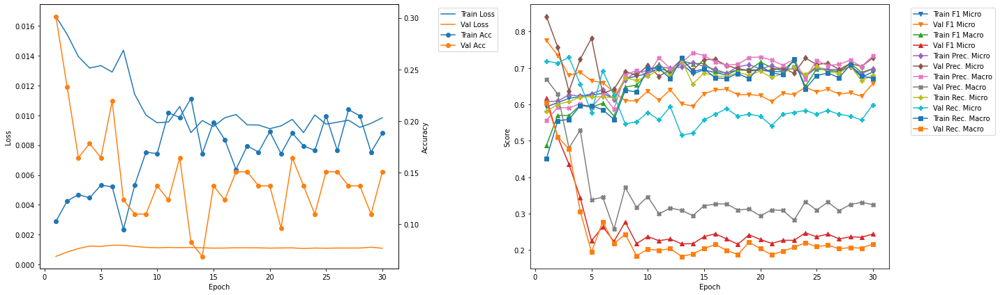

-------------------------------------------
FOLD 3
-------------------------------------------
Validation F1 Micro Score Increased (0.775281 --> 0.800000).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 18.19
Train Loss: 0.0158 	Validation Loss: 0.0006
Train Accuracy: 0.0887 	Validation Accuracy: 0.3836
Train F1 Mirco: 0.6036 	Validation F1 Micro: 0.8
Train F1 Marco: 0.565 	Validation F1 Macro: 0.6802
Train Precision Mirco: 0.6105 	Validation Precision Micro: 0.8132
Train Precision Marco: 0.5925 	Validation Precision Macro: 0.7333
Train Recall Mirco: 0.5969 	Validation Recall Micro: 0.7872
Train Recall Marco: 0.5464 	Validation Recall Macro: 0.6862

Epoch 2 	Learning Rate: 0.01 	Time (min): 18.38
Train Loss: 0.0131 	Validation Loss: 0.0007
Train Accuracy: 0.1422 	Validation Accuracy: 0.2192
Train F1 Mirco: 0.6344 	Validation F1 Micro: 0.752
Train F1 Marco: 0.5942 	Validation F1 Macro: 0.6434
Train Precision Mirco: 0.6462 	Validation Precision Micro: 0.7385
Train Precision

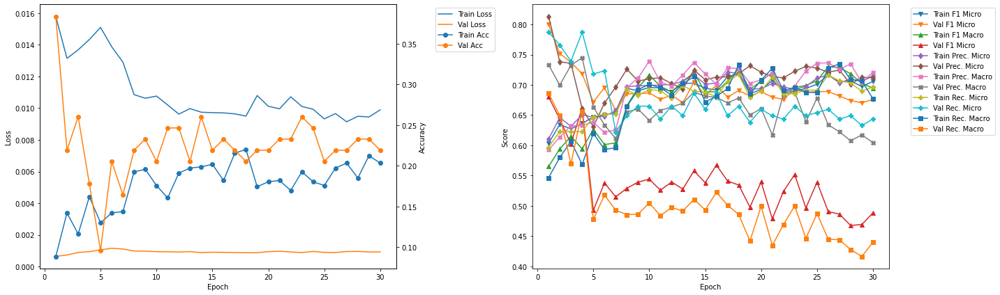

-------------------------------------------
FOLD 4
-------------------------------------------
Validation F1 Micro Score Increased (0.800000 --> 0.827225).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 24.13
Train Loss: 0.0152 	Validation Loss: 0.0005
Train Accuracy: 0.133 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.6331 	Validation F1 Micro: 0.8272
Train F1 Marco: 0.5781 	Validation F1 Macro: 0.7196
Train Precision Mirco: 0.643 	Validation Precision Micro: 0.8272
Train Precision Marco: 0.6245 	Validation Precision Macro: 0.7487
Train Recall Mirco: 0.6236 	Validation Recall Micro: 0.8272
Train Recall Marco: 0.5459 	Validation Recall Macro: 0.7319

Epoch 2 	Learning Rate: 0.01 	Time (min): 24.33
Train Loss: 0.0143 	Validation Loss: 0.0006
Train Accuracy: 0.1269 	Validation Accuracy: 0.411
Train F1 Mirco: 0.6426 	Validation F1 Micro: 0.8
Train F1 Marco: 0.6075 	Validation F1 Macro: 0.7161
Train Precision Mirco: 0.6427 	Validation Precision Micro: 0.8152
Train Precision 

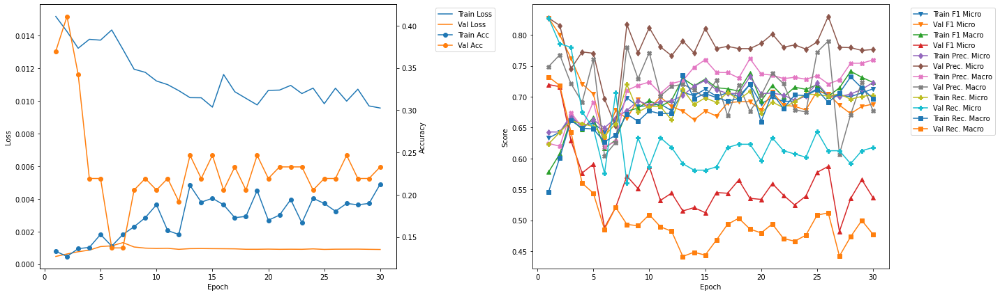

-------------------------------------------
FOLD 5
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 30.07
Train Loss: 0.0163 	Validation Loss: 0.0005
Train Accuracy: 0.1346 	Validation Accuracy: 0.3562
Train F1 Mirco: 0.6307 	Validation F1 Micro: 0.8103
Train F1 Marco: 0.6063 	Validation F1 Macro: 0.7345
Train Precision Mirco: 0.637 	Validation Precision Micro: 0.8343
Train Precision Marco: 0.6222 	Validation Precision Macro: 0.7912
Train Recall Mirco: 0.6244 	Validation Recall Micro: 0.7877
Train Recall Marco: 0.5944 	Validation Recall Macro: 0.7208

Epoch 2 	Learning Rate: 0.01 	Time (min): 30.27
Train Loss: 0.0152 	Validation Loss: 0.0005
Train Accuracy: 0.1422 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.6491 	Validation F1 Micro: 0.8012
Train F1 Marco: 0.6231 	Validation F1 Macro: 0.7177
Train Precision Mirco: 0.649 	Validation Precision Micro: 0.8405
Train Precision Marco: 0.6539 	Validation Precision Macro: 0.803
Train Recall Mirco: 0.6493 

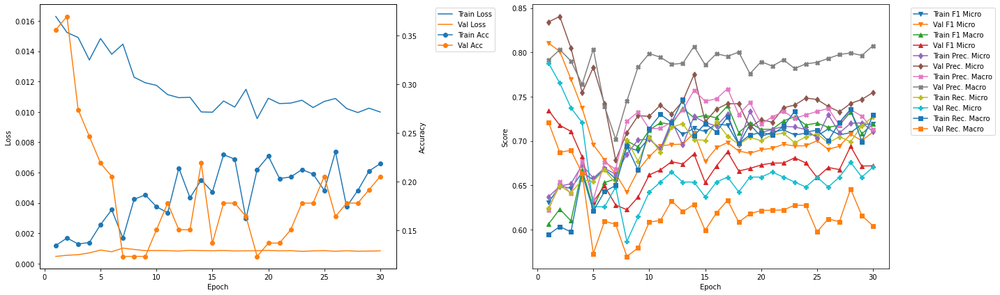

-------------------------------------------
FOLD 6
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 36.0
Train Loss: 0.0152 	Validation Loss: 0.0005
Train Accuracy: 0.1193 	Validation Accuracy: 0.3562
Train F1 Mirco: 0.6347 	Validation F1 Micro: 0.7939
Train F1 Marco: 0.6106 	Validation F1 Macro: 0.7072
Train Precision Mirco: 0.6414 	Validation Precision Micro: 0.7919
Train Precision Marco: 0.6515 	Validation Precision Macro: 0.7529
Train Recall Mirco: 0.6282 	Validation Recall Micro: 0.7959
Train Recall Marco: 0.5924 	Validation Recall Macro: 0.7115

Validation F1 Micro Score Increased (0.827225 --> 0.833773).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 36.22
Train Loss: 0.015 	Validation Loss: 0.0004
Train Accuracy: 0.1177 	Validation Accuracy: 0.4384
Train F1 Mirco: 0.6437 	Validation F1 Micro: 0.8338
Train F1 Marco: 0.6188 	Validation F1 Macro: 0.7988
Train Precision Mirco: 0.652 	Validation Precision Micro: 0.8634
Train Precisi

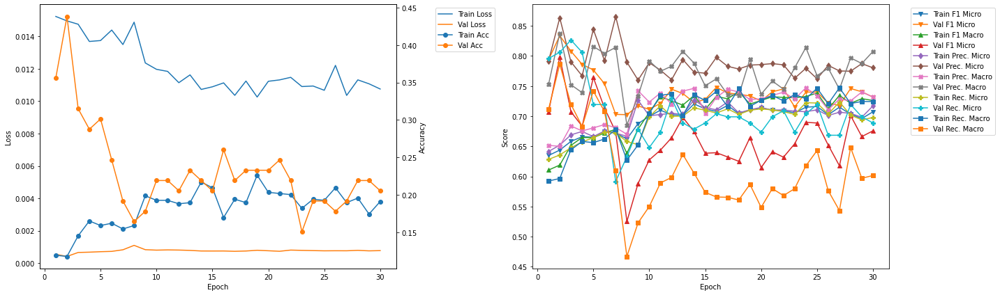

-------------------------------------------
FOLD 7
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 41.96
Train Loss: 0.016 	Validation Loss: 0.0005
Train Accuracy: 0.142 	Validation Accuracy: 0.4028
Train F1 Mirco: 0.6447 	Validation F1 Micro: 0.8089
Train F1 Marco: 0.6437 	Validation F1 Macro: 0.8163
Train Precision Mirco: 0.653 	Validation Precision Micro: 0.8743
Train Precision Marco: 0.6703 	Validation Precision Macro: 0.8486
Train Recall Mirco: 0.6366 	Validation Recall Micro: 0.7526
Train Recall Marco: 0.6238 	Validation Recall Macro: 0.8024

Epoch 2 	Learning Rate: 0.01 	Time (min): 42.16
Train Loss: 0.0142 	Validation Loss: 0.0008
Train Accuracy: 0.1344 	Validation Accuracy: 0.2639
Train F1 Mirco: 0.6657 	Validation F1 Micro: 0.7029
Train F1 Marco: 0.6865 	Validation F1 Macro: 0.7425
Train Precision Mirco: 0.659 	Validation Precision Micro: 0.9244
Train Precision Marco: 0.6857 	Validation Precision Macro: 0.8467
Train Recall Mirco: 0.6726 	

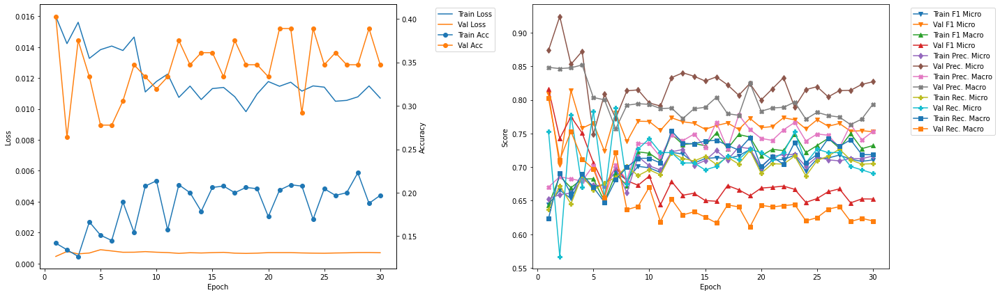

-------------------------------------------
FOLD 8
-------------------------------------------
Validation F1 Micro Score Increased (0.833773 --> 0.866142).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 47.92
Train Loss: 0.0151 	Validation Loss: 0.0004
Train Accuracy: 0.1573 	Validation Accuracy: 0.4722
Train F1 Mirco: 0.669 	Validation F1 Micro: 0.8661
Train F1 Marco: 0.6547 	Validation F1 Macro: 0.7482
Train Precision Mirco: 0.6722 	Validation Precision Micro: 0.8967
Train Precision Marco: 0.6889 	Validation Precision Macro: 0.7934
Train Recall Mirco: 0.6657 	Validation Recall Micro: 0.8376
Train Recall Marco: 0.6318 	Validation Recall Macro: 0.733

Validation F1 Micro Score Increased (0.866142 --> 0.867532).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 48.14
Train Loss: 0.0153 	Validation Loss: 0.0003
Train Accuracy: 0.1435 	Validation Accuracy: 0.4861
Train F1 Mirco: 0.6547 	Validation F1 Micro: 0.8675
Train F1 Marco: 0.6655 	Validation F1 Macro: 0.716

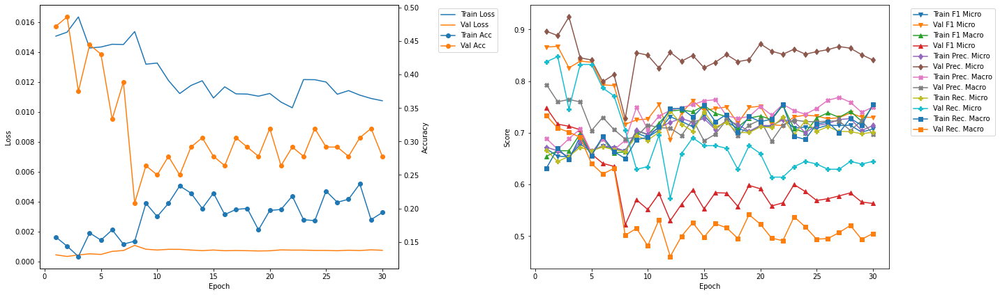

-------------------------------------------
FOLD 9
-------------------------------------------
Validation F1 Micro Score Increased (0.867532 --> 0.885645).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 53.9
Train Loss: 0.0152 	Validation Loss: 0.0004
Train Accuracy: 0.1405 	Validation Accuracy: 0.4861
Train F1 Mirco: 0.6476 	Validation F1 Micro: 0.8856
Train F1 Marco: 0.6694 	Validation F1 Macro: 0.8927
Train Precision Mirco: 0.6586 	Validation Precision Micro: 0.875
Train Precision Marco: 0.6958 	Validation Precision Macro: 0.917
Train Recall Mirco: 0.637 	Validation Recall Micro: 0.8966
Train Recall Marco: 0.6497 	Validation Recall Macro: 0.8812

Epoch 2 	Learning Rate: 0.01 	Time (min): 54.1
Train Loss: 0.0149 	Validation Loss: 0.0005
Train Accuracy: 0.1817 	Validation Accuracy: 0.3889
Train F1 Mirco: 0.6824 	Validation F1 Micro: 0.8513
Train F1 Marco: 0.6945 	Validation F1 Macro: 0.857
Train Precision Mirco: 0.6774 	Validation Precision Micro: 0.8877
Train Precision 

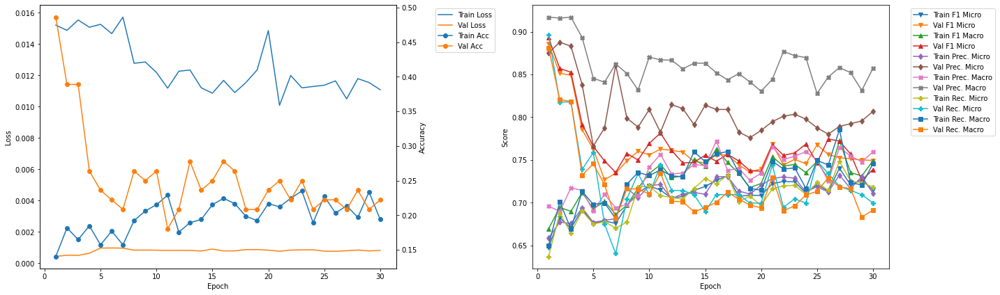

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 1
Train Loss: 0.0152 	Validation Loss: 0.0004
Train Accuracy: 0.1405 	Validation Accuracy: 0.4861
Train F1 Mirco: 0.6476 	Validation F1 Micro: 0.8856
Train F1 Marco: 0.6694 	Validation F1 Macro: 0.8927
Train Precision Mirco: 0.6586 	Validation Precision Micro: 0.875
Train Precision Marco: 0.6958 	Validation Precision Macro: 0.917
Train Recall Mirco: 0.637 	Validation Recall Micro: 0.8966
Train Recall Marco: 0.6497 	Validation Recall Macro: 0.8812


In [77]:
Kfold_train_CNN(model = vgg16bn, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'vgg16bn')

-------------------------------------------
FOLD 0
-------------------------------------------
Validation F1 Micro Score Increased (0.000000 --> 0.395062).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 0.22
Train Loss: 0.0261 	Validation Loss: 0.0021
Train Accuracy: 0.0367 	Validation Accuracy: 0.0548
Train F1 Mirco: 0.3803 	Validation F1 Micro: 0.3951
Train F1 Marco: 0.1216 	Validation F1 Macro: 0.0977
Train Precision Mirco: 0.3974 	Validation Precision Micro: 0.5664
Train Precision Marco: 0.1306 	Validation Precision Macro: 0.1567
Train Recall Mirco: 0.3646 	Validation Recall Micro: 0.3033
Train Recall Marco: 0.1153 	Validation Recall Macro: 0.0889

Validation F1 Micro Score Increased (0.395062 --> 0.396739).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 0.45
Train Loss: 0.0173 	Validation Loss: 0.0022
Train Accuracy: 0.0734 	Validation Accuracy: 0.0274
Train F1 Mirco: 0.4986 	Validation F1 Micro: 0.3967
Train F1 Marco: 0.2157 	Validation F1 Macro: 0.132

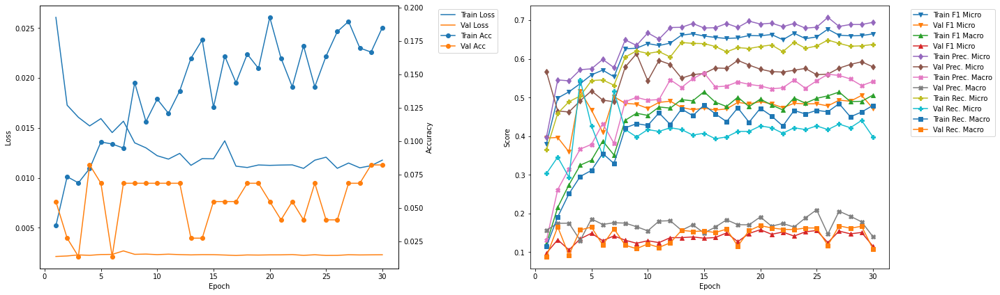

-------------------------------------------
FOLD 1
-------------------------------------------
Validation F1 Micro Score Increased (0.516854 --> 0.660606).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 6.44
Train Loss: 0.0182 	Validation Loss: 0.0012
Train Accuracy: 0.0642 	Validation Accuracy: 0.2192
Train F1 Mirco: 0.543 	Validation F1 Micro: 0.6606
Train F1 Marco: 0.3244 	Validation F1 Macro: 0.2703
Train Precision Mirco: 0.561 	Validation Precision Micro: 0.6899
Train Precision Marco: 0.3579 	Validation Precision Macro: 0.4095
Train Recall Mirco: 0.5262 	Validation Recall Micro: 0.6337
Train Recall Marco: 0.3021 	Validation Recall Macro: 0.262

Epoch 2 	Learning Rate: 0.01 	Time (min): 6.65
Train Loss: 0.0142 	Validation Loss: 0.0014
Train Accuracy: 0.0902 	Validation Accuracy: 0.1233
Train F1 Mirco: 0.5776 	Validation F1 Micro: 0.6006
Train F1 Marco: 0.3939 	Validation F1 Macro: 0.3186
Train Precision Mirco: 0.5976 	Validation Precision Micro: 0.6424
Train Precision

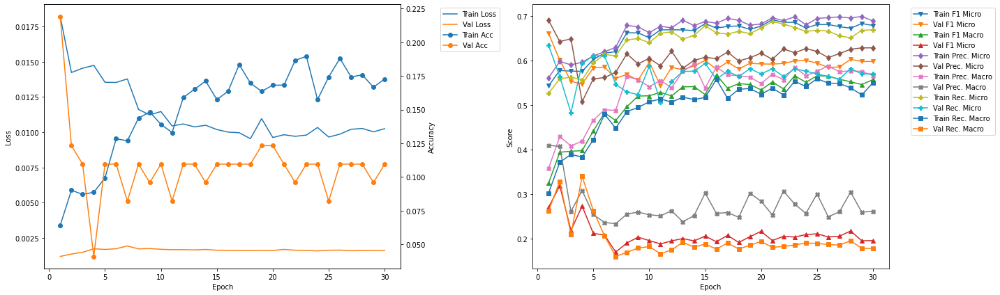

-------------------------------------------
FOLD 2
-------------------------------------------
Validation F1 Micro Score Increased (0.660606 --> 0.677871).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 12.63
Train Loss: 0.0168 	Validation Loss: 0.0009
Train Accuracy: 0.1208 	Validation Accuracy: 0.2329
Train F1 Mirco: 0.5855 	Validation F1 Micro: 0.6779
Train F1 Marco: 0.4095 	Validation F1 Macro: 0.5526
Train Precision Mirco: 0.6038 	Validation Precision Micro: 0.7289
Train Precision Marco: 0.453 	Validation Precision Macro: 0.6395
Train Recall Mirco: 0.5683 	Validation Recall Micro: 0.6335
Train Recall Marco: 0.3807 	Validation Recall Macro: 0.557

Validation F1 Micro Score Increased (0.677871 --> 0.715789).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 12.85
Train Loss: 0.0144 	Validation Loss: 0.0009
Train Accuracy: 0.1162 	Validation Accuracy: 0.1918
Train F1 Mirco: 0.6078 	Validation F1 Micro: 0.7158
Train F1 Marco: 0.4514 	Validation F1 Macro: 0.453

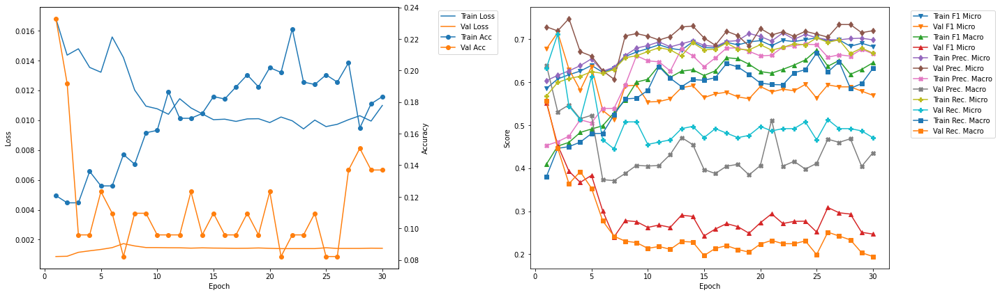

-------------------------------------------
FOLD 3
-------------------------------------------
Validation F1 Micro Score Increased (0.715789 --> 0.799054).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 18.82
Train Loss: 0.0175 	Validation Loss: 0.0006
Train Accuracy: 0.1009 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.5895 	Validation F1 Micro: 0.7991
Train F1 Marco: 0.4832 	Validation F1 Macro: 0.7009
Train Precision Mirco: 0.6102 	Validation Precision Micro: 0.7897
Train Precision Marco: 0.5701 	Validation Precision Macro: 0.7726
Train Recall Mirco: 0.5702 	Validation Recall Micro: 0.8086
Train Recall Marco: 0.4414 	Validation Recall Macro: 0.6781

Epoch 2 	Learning Rate: 0.01 	Time (min): 19.02
Train Loss: 0.0158 	Validation Loss: 0.0007
Train Accuracy: 0.1086 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.6107 	Validation F1 Micro: 0.7888
Train F1 Marco: 0.5373 	Validation F1 Macro: 0.6473
Train Precision Mirco: 0.6042 	Validation Precision Micro: 0.8424
Train Prec

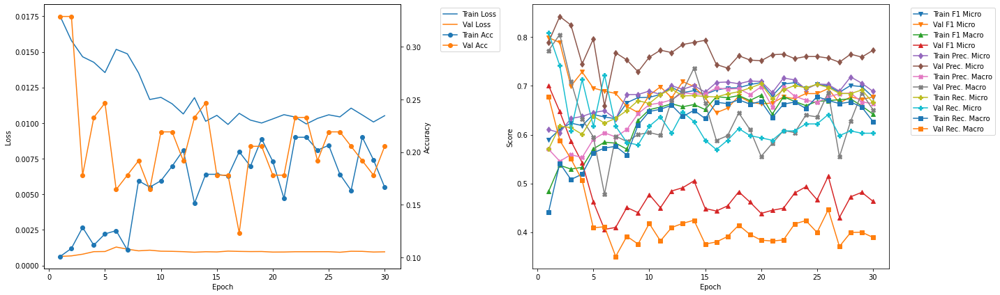

-------------------------------------------
FOLD 4
-------------------------------------------
Epoch 1 	Learning Rate: 0.01 	Time (min): 24.98
Train Loss: 0.0166 	Validation Loss: 0.0007
Train Accuracy: 0.1407 	Validation Accuracy: 0.274
Train F1 Mirco: 0.6194 	Validation F1 Micro: 0.7891
Train F1 Marco: 0.5195 	Validation F1 Macro: 0.7025
Train Precision Mirco: 0.6337 	Validation Precision Micro: 0.7608
Train Precision Marco: 0.5556 	Validation Precision Macro: 0.7805
Train Recall Mirco: 0.6058 	Validation Recall Micro: 0.8196
Train Recall Marco: 0.492 	Validation Recall Macro: 0.6856

Epoch 2 	Learning Rate: 0.01 	Time (min): 25.18
Train Loss: 0.015 	Validation Loss: 0.001
Train Accuracy: 0.1498 	Validation Accuracy: 0.1918
Train F1 Mirco: 0.6426 	Validation F1 Micro: 0.7425
Train F1 Marco: 0.5738 	Validation F1 Macro: 0.6268
Train Precision Mirco: 0.6401 	Validation Precision Micro: 0.7829
Train Precision Marco: 0.5831 	Validation Precision Macro: 0.74
Train Recall Mirco: 0.6452 	Va

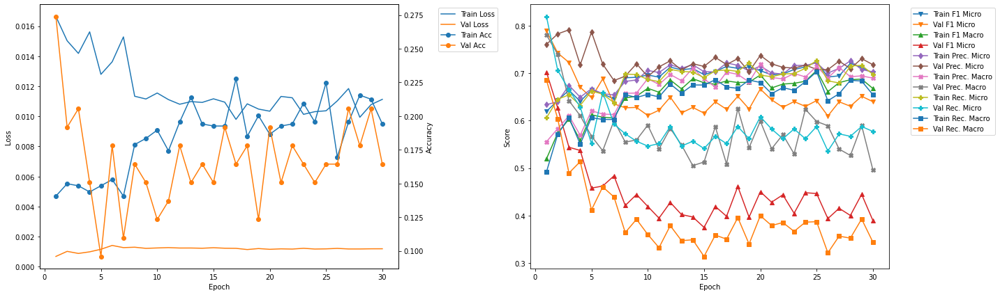

-------------------------------------------
FOLD 5
-------------------------------------------
Validation F1 Micro Score Increased (0.799054 --> 0.824121).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 31.15
Train Loss: 0.0179 	Validation Loss: 0.0005
Train Accuracy: 0.1346 	Validation Accuracy: 0.3836
Train F1 Mirco: 0.6255 	Validation F1 Micro: 0.8241
Train F1 Marco: 0.5418 	Validation F1 Macro: 0.7306
Train Precision Mirco: 0.6337 	Validation Precision Micro: 0.8325
Train Precision Marco: 0.5643 	Validation Precision Macro: 0.7978
Train Recall Mirco: 0.6174 	Validation Recall Micro: 0.8159
Train Recall Marco: 0.5231 	Validation Recall Macro: 0.7243

Epoch 2 	Learning Rate: 0.01 	Time (min): 31.36
Train Loss: 0.015 	Validation Loss: 0.0006
Train Accuracy: 0.1391 	Validation Accuracy: 0.3288
Train F1 Mirco: 0.6475 	Validation F1 Micro: 0.7863
Train F1 Marco: 0.6061 	Validation F1 Macro: 0.6723
Train Precision Mirco: 0.6555 	Validation Precision Micro: 0.8371
Train Preci

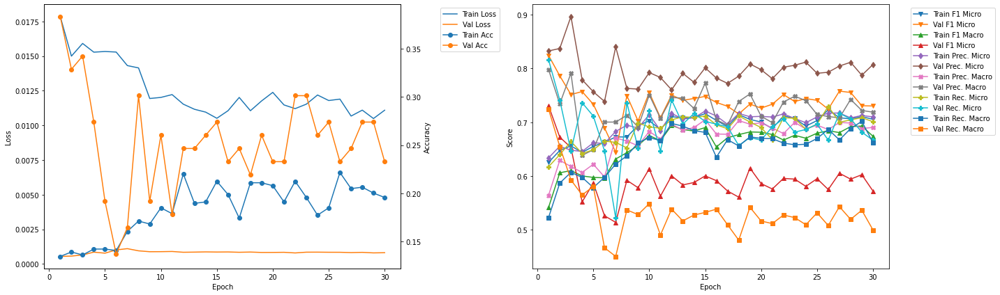

-------------------------------------------
FOLD 6
-------------------------------------------
Validation F1 Micro Score Increased (0.824121 --> 0.829268).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 37.32
Train Loss: 0.0187 	Validation Loss: 0.0004
Train Accuracy: 0.1422 	Validation Accuracy: 0.3699
Train F1 Mirco: 0.6461 	Validation F1 Micro: 0.8293
Train F1 Marco: 0.5918 	Validation F1 Macro: 0.8154
Train Precision Mirco: 0.6544 	Validation Precision Micro: 0.8407
Train Precision Marco: 0.6248 	Validation Precision Macro: 0.8687
Train Recall Mirco: 0.6381 	Validation Recall Micro: 0.8182
Train Recall Marco: 0.5689 	Validation Recall Macro: 0.7851

Validation F1 Micro Score Increased (0.829268 --> 0.830508).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 37.55
Train Loss: 0.0155 	Validation Loss: 0.0005
Train Accuracy: 0.1453 	Validation Accuracy: 0.3973
Train F1 Mirco: 0.656 	Validation F1 Micro: 0.8305
Train F1 Marco: 0.6008 	Validation F1 Macro: 0.79

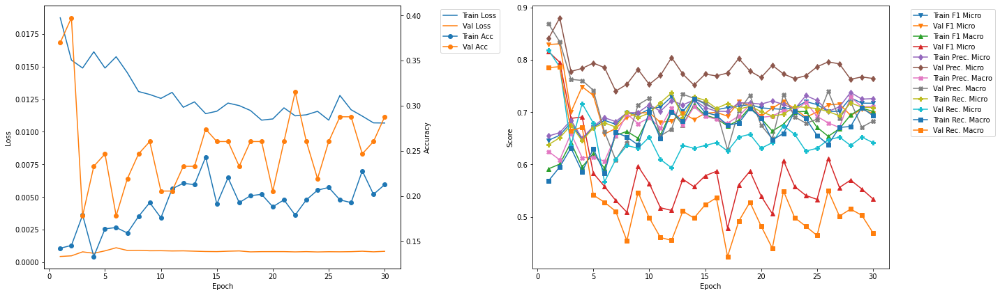

-------------------------------------------
FOLD 7
-------------------------------------------
Validation F1 Micro Score Increased (0.830508 --> 0.847545).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 43.52
Train Loss: 0.0196 	Validation Loss: 0.0006
Train Accuracy: 0.1145 	Validation Accuracy: 0.3889
Train F1 Mirco: 0.6267 	Validation F1 Micro: 0.8475
Train F1 Marco: 0.5816 	Validation F1 Macro: 0.7422
Train Precision Mirco: 0.6322 	Validation Precision Micro: 0.8241
Train Precision Marco: 0.5935 	Validation Precision Macro: 0.7889
Train Recall Mirco: 0.6214 	Validation Recall Micro: 0.8723
Train Recall Marco: 0.5731 	Validation Recall Macro: 0.7552

Validation F1 Micro Score Increased (0.847545 --> 0.848958).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 43.75
Train Loss: 0.0153 	Validation Loss: 0.0005
Train Accuracy: 0.1557 	Validation Accuracy: 0.4444
Train F1 Mirco: 0.6669 	Validation F1 Micro: 0.849
Train F1 Marco: 0.6314 	Validation F1 Macro: 0.74

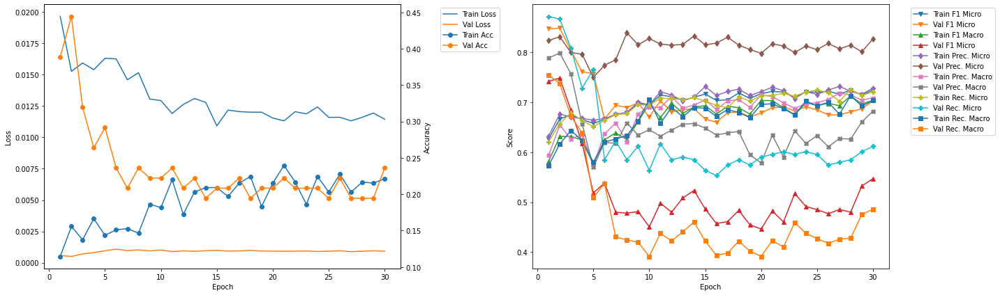

-------------------------------------------
FOLD 8
-------------------------------------------
Validation F1 Micro Score Increased (0.848958 --> 0.855586).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 49.71
Train Loss: 0.0183 	Validation Loss: 0.0004
Train Accuracy: 0.1435 	Validation Accuracy: 0.5
Train F1 Mirco: 0.6363 	Validation F1 Micro: 0.8556
Train F1 Marco: 0.5912 	Validation F1 Macro: 0.7746
Train Precision Mirco: 0.6445 	Validation Precision Micro: 0.887
Train Precision Marco: 0.6137 	Validation Precision Macro: 0.8098
Train Recall Mirco: 0.6283 	Validation Recall Micro: 0.8263
Train Recall Marco: 0.5735 	Validation Recall Macro: 0.7731

Validation F1 Micro Score Increased (0.855586 --> 0.878706).  Saving model ...

Epoch 2 	Learning Rate: 0.01 	Time (min): 49.94
Train Loss: 0.0154 	Validation Loss: 0.0003
Train Accuracy: 0.171 	Validation Accuracy: 0.5417
Train F1 Mirco: 0.672 	Validation F1 Micro: 0.8787
Train F1 Marco: 0.6251 	Validation F1 Macro: 0.8329
Tr

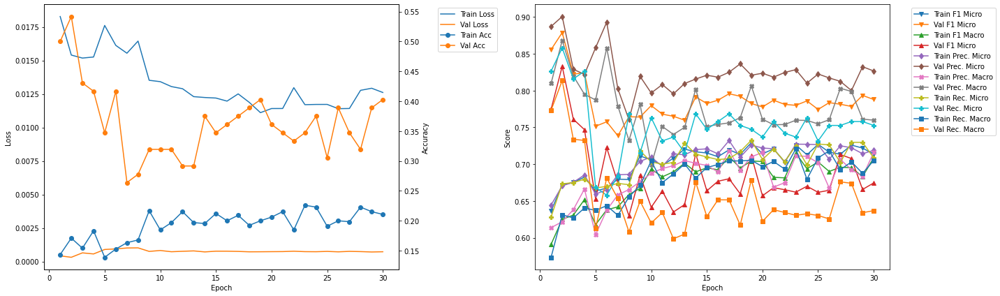

-------------------------------------------
FOLD 9
-------------------------------------------
Validation F1 Micro Score Increased (0.878706 --> 0.894349).  Saving model ...

Epoch 1 	Learning Rate: 0.01 	Time (min): 55.91
Train Loss: 0.017 	Validation Loss: 0.0003
Train Accuracy: 0.1374 	Validation Accuracy: 0.5417
Train F1 Mirco: 0.6558 	Validation F1 Micro: 0.8943
Train F1 Marco: 0.6278 	Validation F1 Macro: 0.8647
Train Precision Mirco: 0.6683 	Validation Precision Micro: 0.8966
Train Precision Marco: 0.6481 	Validation Precision Macro: 0.8733
Train Recall Mirco: 0.6437 	Validation Recall Micro: 0.8922
Train Recall Marco: 0.6103 	Validation Recall Macro: 0.862

Epoch 2 	Learning Rate: 0.01 	Time (min): 56.11
Train Loss: 0.0151 	Validation Loss: 0.0005
Train Accuracy: 0.1588 	Validation Accuracy: 0.4167
Train F1 Mirco: 0.6792 	Validation F1 Micro: 0.8359
Train F1 Marco: 0.6456 	Validation F1 Macro: 0.7798
Train Precision Mirco: 0.6758 	Validation Precision Micro: 0.8763
Train Precis

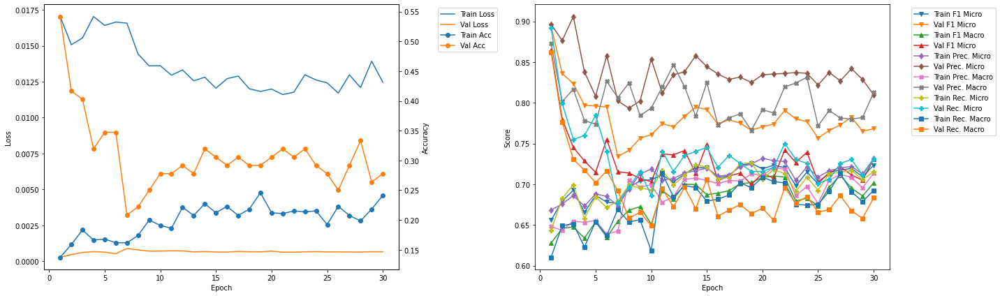

------------------------------------------------------------
------------------------------------------------------------

Metrics of Best Model:
Fold: 9 	Epoch: 1
Train Loss: 0.017 	Validation Loss: 0.0003
Train Accuracy: 0.1374 	Validation Accuracy: 0.5417
Train F1 Mirco: 0.6558 	Validation F1 Micro: 0.8943
Train F1 Marco: 0.6278 	Validation F1 Macro: 0.8647
Train Precision Mirco: 0.6683 	Validation Precision Micro: 0.8966
Train Precision Marco: 0.6481 	Validation Precision Macro: 0.8733
Train Recall Mirco: 0.6437 	Validation Recall Micro: 0.8922
Train Recall Marco: 0.6103 	Validation Recall Macro: 0.862


In [78]:
Kfold_train_CNN(model = vgg19bn, training_data = training_data, learning_rate = 0.01, k_folds = 10, n_epochs = 30, model_name = 'vgg19bn')

In [79]:
print('Total Training Time (HR:M:S): ' + str(datetime.timedelta(hours = ((time.time() - START) / 60 / 60))).rsplit('.', 1)[0])

Total Training Time (HR:M:S): 7:19:57


# 
# 
# 

## Training Summary

### Summary Table

In [5]:
summaryDF = pd.DataFrame({
    'ResNet18' : [10, 1, 0.006, 0.2336, 0.7289, 0.7157, 0.7588, 0.798, 0.7001, 0.6615, 0.004, 0.4722, 0.8593, 0.7506, 0.8093, 0.7513, 0.9158, 0.7961],
    'ResNet50' : [10, 3, 0.0121, 0.3618, 0.8116, 0.6061, 0.8379, 0.6374, 0.7869, 0.5801, 0.0014, 0.5833, 0.9019, 0.6891, 0.8947, 0.6904, 0.9091, 0.7123],
    'ResNet101' : [10, 3, 0.0079, 0.3496, 0.8063, 0.637, 0.8166, 0.6513, 0.7963, 0.6254, 0.001, 0.5417, 0.8859, 0.704, 0.8698, 0.7237, 0.9027, 0.7098],
    'DenseNet121' : [10, 1, 0.0062, 0.2687, 0.7413, 0.7439, 0.763, 0.806, 0.7207, 0.6986, 0.0003, 0.5, 0.879, 0.7787, 0.8517, 0.7728, 0.9082, 0.8114],
    'DenseNet169' : [9, 3, 0.0034, 0.4336, 0.8456, 0.8876, 0.8499, 0.9003, 0.8413, 0.8771, 0.0002, 0.6944, 0.9337, 0.882, 0.9441, 0.8828, 0.9235, 0.8852],
    'DenseNet201' : [10, 1, 0.0056, 0.3344, 0.7818, 0.8418, 0.7918, 0.8703, 0.7719, 0.8175, 0.0002, 0.6528, 0.9289, 0.8765, 0.9104, 0.8631, 0.9482, 0.8989],
    'VGG11_BN' : [9, 1, 0.0163, 0.1389, 0.6529, 0.5893, 0.6589, 0.6095, 0.647, 0.5733, 0.0003, 0.5833, 0.905, 0.9281, 0.9529, 0.9878, 0.8617, 0.8928],
    'VGG16_BN' : [10, 1, 0.0152, 0.1405, 0.6476, 0.6694, 0.6586, 0.6958, 0.637, 0.6497, 0.0004, 0.4861, 0.8856, 0.8927, 0.875, 0.917, 0.8966, 0.8812],
    'VGG19_BN' : [10, 1, 0.017, 0.1374, 0.6558, 0.6278, 0.6683, 0.6481, 0.6437, 0.6103, 0.0003, 0.5417, 0.8943, 0.8647, 0.8966, 0.8733, 0.8922, 0.8626]
})
summaryDF.index = ['Fold', 'Epoch', 'Train Loss', 'Train Accuracy', 'Train F1 Micro', 'Train F1 Macro', 'Train Precision Micro', 'Train Precision Macro', 'Train Recall Micro', 'Train Recall Macro',
                   'Val Loss', 'Val Accuracy', 'Val F1 Micro', 'Val F1 Macro', 'Val Precision Micro', 'Val Precision Macro', 'Val Recall Micro', 'Val Recall Macro']

summaryDF

,ResNet18,ResNet50,ResNet101,DenseNet121,DenseNet169,DenseNet201,VGG11_BN,VGG16_BN,VGG19_BN
Fold,10.0000,10.0000,10.0000,10.0000,9.0000,10.0000,9.0000,10.0000,10.0000
Epoch,1.0000,3.0000,3.0000,1.0000,3.0000,1.0000,1.0000,1.0000,1.0000
Train Loss,0.0060,0.0121,0.0079,0.0062,0.0034,0.0056,0.0163,0.0152,0.0170
Train Accuracy,0.2336,0.3618,0.3496,0.2687,0.4336,0.3344,0.1389,0.1405,0.1374
Train F1 Micro,0.7289,0.8116,0.8063,0.7413,0.8456,0.7818,0.6529,0.6476,0.6558
Train F1 Macro,0.7157,0.6061,0.6370,0.7439,0.8876,0.8418,0.5893,0.6694,0.6278
Train Precision Micro,0.7588,0.8379,0.8166,0.7630,0.8499,0.7918,0.6589,0.6586,0.6683
Train Precision Macro,0.7980,0.6374,0.6513,0.8060,0.9003,0.8703,0.6095,0.6958,0.6481
Train Recall Micro,0.7001,0.7869,0.7963,0.7207,0.8413,0.7719,0.6470,0.6370,0.6437
Train Recall Macro,0.6615,0.5801,0.6254,0.6986,0.8771,0.8175,0.5733,0.6497,0.6103


### Training Summary Graph

In [6]:
import plotly
import plotly.graph_objects as go

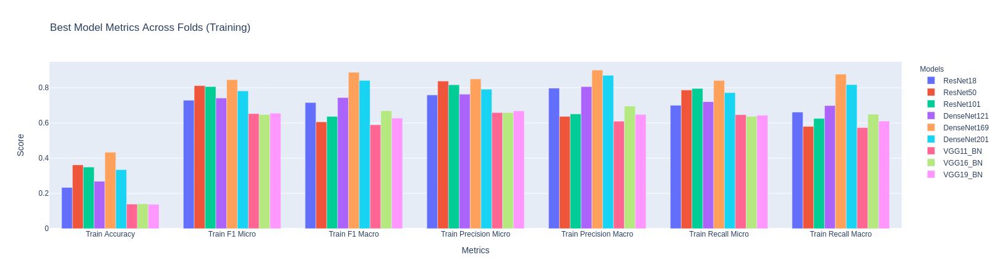

In [9]:
fig = go.Figure(data = [
    go.Bar(name = 'ResNet18', x = summaryDF.index[3:10], y = summaryDF['ResNet18'][3:10]),
    go.Bar(name = 'ResNet50', x = summaryDF.index[3:10], y = summaryDF['ResNet50'][3:10]),
    go.Bar(name = 'ResNet101', x = summaryDF.index[3:10], y = summaryDF['ResNet101'][3:10]),
    go.Bar(name = 'DenseNet121', x = summaryDF.index[3:10], y = summaryDF['DenseNet121'][3:10]),
    go.Bar(name = 'DenseNet169', x = summaryDF.index[3:10], y = summaryDF['DenseNet169'][3:10]),
    go.Bar(name = 'DenseNet201', x = summaryDF.index[3:10], y = summaryDF['DenseNet201'][3:10]),
    go.Bar(name = 'VGG11_BN', x = summaryDF.index[3:10], y = summaryDF['VGG11_BN'][3:10]),
    go.Bar(name = 'VGG16_BN', x = summaryDF.index[3:10], y = summaryDF['VGG16_BN'][3:10]),
    go.Bar(name = 'VGG19_BN', x = summaryDF.index[3:10], y = summaryDF['VGG19_BN'][3:10]),
])
fig.update_layout(barmode = 'group',
                  title = 'Best Model Metrics Across Folds (Training)',
                  xaxis_title = 'Metrics',
                  yaxis_title = 'Score',
                  legend_title = 'Models')
fig.show()

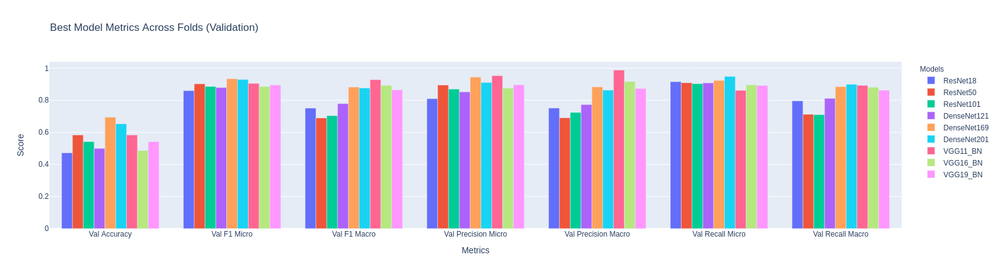

In [10]:
fig = go.Figure(data = [
    go.Bar(name = 'ResNet18', x = summaryDF.index[11:], y = summaryDF['ResNet18'][11:]),
    go.Bar(name = 'ResNet50', x = summaryDF.index[11:], y = summaryDF['ResNet50'][11:]),
    go.Bar(name = 'ResNet101', x = summaryDF.index[11:], y = summaryDF['ResNet101'][11:]),
    go.Bar(name = 'DenseNet121', x = summaryDF.index[11:], y = summaryDF['DenseNet121'][11:]),
    go.Bar(name = 'DenseNet169', x = summaryDF.index[11:], y = summaryDF['DenseNet169'][11:]),
    go.Bar(name = 'DenseNet201', x = summaryDF.index[11:], y = summaryDF['DenseNet201'][11:]),
    go.Bar(name = 'VGG11_BN', x = summaryDF.index[11:], y = summaryDF['VGG11_BN'][11:]),
    go.Bar(name = 'VGG16_BN', x = summaryDF.index[11:], y = summaryDF['VGG16_BN'][11:]),
    go.Bar(name = 'VGG19_BN', x = summaryDF.index[11:], y = summaryDF['VGG19_BN'][11:]),
])
fig.update_layout(barmode = 'group',
                  title = 'Best Model Metrics Across Folds (Validation)',
                  xaxis_title = 'Metrics',
                  yaxis_title = 'Score',
                  legend_title = 'Models')
fig.show()